In [1]:
    #
    #IMC
    #classes = ["Peso Normal","Obesidade"]
    #intervalos = [(0, 30),(30, 1000)]
    #
    #classes = ["Peso Normal","Sobrepeso", "Obesidade"]
    #intervalos = [(0, 25),(25, 30),(30, 1000)]
    #
    #classes = ["baixo peso","normal","sobrepeso","obesimc grau I","obesimc grau II","obesimc Grau III"]
    #intervalos = [(0, 18),(18, 25),(25, 30),(30, 35),(35, 40),(40, 1000)]
    #
    #IDADE
    #classes = ["Adultos","Idoso"]
    #intervalos = [(0, 65),(65, 200)]
    #
    #classes = ["Adultos","Meia-idade","Idoso"]
    #intervalos = [(0, 50),(50, 65),(65, 200)]
    #
    #classes = ["Jovens","Adultos","Meia-idade","Idoso", "Ancião","Velhice extrema"]
    #intervalos = [(0, 20),(20, 45),(45, 60),(60, 75),(75, 90),(90, 200)]
    #

In [2]:
#  Importação das bibliotecas
from datetime import time, timedelta, datetime, date
import numpy as np
from matplotlib.colors import ListedColormap
from matplotlib import pyplot as plt
import matplotlib as mpl
import math
import pandas as pd
from pathlib import Path
import seaborn as sns

plt.rcParams['figure.figsize'] = [10, 5]
mpl.rcParams['figure.dpi'] = 300


# Definição de diretórios e Disco de leitura dos arquivos (Desktop ou Notebook) 
config_dirs = open("prefixo_dados.txt").readlines() 
DIR_PREFIXO = Path(config_dirs[0].strip())

DIRETORIO_PRINCIPAL =  DIR_PREFIXO / "PA_clean" / "kfold" 
DIR_ABORDAGENS = DIRETORIO_PRINCIPAL / "analise_abordagens"
DIR_GRAFICOS = DIR_ABORDAGENS / "graficos_analise"
DIR_KMEANS = DIRETORIO_PRINCIPAL / "KMeansRandom"
DIR_DICT = DIRETORIO_PRINCIPAL / "DICT"
DIR_NMF = DIRETORIO_PRINCIPAL / "NMF"


#DIRETORIO_PRINCIPAL =  DIR_PREFIXO / "PA_clean"
#DIR_ABORDAGENS = DIRETORIO_PRINCIPAL / "analise_abordagens"
#DIR_GRAFICOS = DIR_ABORDAGENS / "graficos_analise"
#DIR_KMEANS = DIRETORIO_PRINCIPAL / "KMeansRandom"
#DIR_DICT = DIRETORIO_PRINCIPAL / "DICT"
#DIR_NMF = DIRETORIO_PRINCIPAL / "NMF"
#

In [3]:
caminho = DIRETORIO_PRINCIPAL / DIR_KMEANS
caminho
diretorios = {'dict':DIR_DICT,'kmeans':DIR_KMEANS, 'nmf':DIR_NMF}

nome_abordagem = {'cadastro':"_approach_cadastro", 'doenca':"_approach_doenca",
                  'medidas':"_approach_medidas",'estatistica':"_approach_estatistica",
                 'escolho_doenca':"_approach_escolho_doenca", 'categorias':"_approach_classes",
                 'medidas_masc':"_approach_medidas_masc",'medidas_fem':"_approach_medidas_fem",
                 'medidas_diast':"_approach_medidas_diastolica", 'medidas_sist':"_approach_medidas_sistolica",
                 'medidas_importantes':"_approach_medidas_importantes",
                 'simplificado':"_approach_simplificado",
                 'doenca_sem_extremos':"_approach_doenca_sem_extremos"}

In [4]:
#analise = 'dict'
#print(analise.capitalize())

In [5]:
from matplotlib.colors import ListedColormap
def grafico_barras_empilhadas(df):
    df.set_index('Cluster')\
      .reindex(df.set_index('Cluster').sum().sort_values().index, axis=1)\
      .T.plot(kind='bar', stacked=True,
              colormap=ListedColormap(sns.color_palette("GnBu", 10)), 
              figsize=(12,6))

In [6]:
#DIR_DICT / f"Dict_approach_doenca
#_grupo_{grupo}.csv", 

# Análise é uma opção do dicionário criado na célula acima
algoritmo = input("Informe a analise ")

caminho_medidas = diretorios[algoritmo.lower()]/ f"{algoritmo.upper()}{nome_abordagem['medidas']}"
caminho_estatistica = diretorios[algoritmo.lower()]/ f"{algoritmo.upper()}{nome_abordagem['estatistica']}"
caminho_doenca = diretorios[algoritmo.lower()]/ f"{algoritmo.upper()}{nome_abordagem['doenca']}"
caminho_cadastro = diretorios[algoritmo.lower()]/ f"{algoritmo.upper()}{nome_abordagem['cadastro']}"
caminho_escolho_doenca = diretorios[algoritmo.lower()]/ f"{algoritmo.upper()}{nome_abordagem['escolho_doenca']}"
caminho_categorias = diretorios[algoritmo.lower()]/ f"{algoritmo.upper()}{nome_abordagem['categorias']}"
caminho_medidas_masc = diretorios[algoritmo.lower()]/ f"{algoritmo.upper()}{nome_abordagem['medidas_masc']}"
caminho_medidas_fem = diretorios[algoritmo.lower()]/ f"{algoritmo.upper()}{nome_abordagem['medidas_fem']}"
caminho_medidas_diast = diretorios[algoritmo.lower()]/ f"{algoritmo.upper()}{nome_abordagem['medidas_diast']}"
caminho_medidas_sist = diretorios[algoritmo.lower()]/ f"{algoritmo.upper()}{nome_abordagem['medidas_sist']}"
caminho_medidas_importantes = diretorios[algoritmo.lower()]/ f"{algoritmo.upper()}{nome_abordagem['medidas_importantes']}"
caminho_simplificado = diretorios[algoritmo.lower()]/ f"{algoritmo.upper()}{nome_abordagem['simplificado']}"
caminho_doenca_sem_extremos = diretorios[algoritmo.lower()]/ f"{algoritmo.upper()}{nome_abordagem['doenca_sem_extremos']}"



Informe a analise kmeans


In [7]:
#n = float(input('Digite algo: ').replace(',','.'))

In [8]:
caminho_medidas

WindowsPath('D:/PA_clean/kfold/KMeansRandom/KMEANS_approach_medidas')

In [9]:
# Diferentes Abordagens

abordagem_cadastro    = list()
abordagem_medidas     = list()
abordagem_estatistica = list()
abordagem_doenca      = list()
abordagem_escolho_doenca = list()
abordagem_categorias  = list()
abordagem_medidas_masc = list()
abordagem_medidas_fem   = list()
abordagem_medidas_importantes   = list()
abordagem_simplificado    = list()
abordagem_doenca_sem_extremos = list()

try:
    grupo_leitura = 1
    while 1:

        abordagem_estatistica.append(pd.read_csv(f"{caminho_estatistica}_grupo_{grupo_leitura}.csv", sep=";", encoding='latin1'))
        grupo_leitura += 1   
except:
    pass

try:
    grupo_leitura = 1
    while 1:

        abordagem_medidas.append(pd.read_csv(f"{caminho_medidas}_grupo_{grupo_leitura}.csv", sep=";", encoding='latin1'))
        grupo_leitura += 1

except:
    pass

try:
    grupo_leitura = 1
    while 1:

        abordagem_doenca.append(pd.read_csv(f"{caminho_doenca}_grupo_{grupo_leitura}.csv", sep=";", encoding='latin1'))
        grupo_leitura += 1
except:
    pass

try:
    grupo_leitura = 1
    while 1:

        abordagem_cadastro.append(pd.read_csv(f"{caminho_cadastro}_grupo_{grupo_leitura}.csv", sep=";", encoding='latin1'))
        grupo_leitura += 1

except:
    pass

try:
    grupo_leitura = 1
    while 1:

        abordagem_escolho_doenca.append(pd.read_csv(f"{caminho_escolho_doenca}_grupo_{grupo_leitura}.csv", sep=";", encoding='latin1'))
        grupo_leitura += 1

except:
    pass

try:
    grupo_leitura = 1
    while 1:

        abordagem_categorias.append(pd.read_csv(f"{caminho_categorias}_grupo_{grupo_leitura}.csv", sep=";", encoding='latin1'))
        grupo_leitura += 1

except:
    pass

try:
    grupo_leitura = 1
    while 1:

        abordagem_medidas_masc.append(pd.read_csv(f"{caminho_medidas_masc}_grupo_{grupo_leitura}.csv", sep=";", encoding='latin1'))
        grupo_leitura += 1

except:
    pass

try:
    grupo_leitura = 1
    while 1:

        abordagem_medidas_fem.append(pd.read_csv(f"{caminho_medidas_fem}_grupo_{grupo_leitura}.csv", sep=";", encoding='latin1'))
        grupo_leitura += 1

except:
    pass

try:
    grupo_leitura = 1
    while 1:

        abordagem_medidas_importantes.append(pd.read_csv(f"{caminho_medidas_importantes}_grupo_{grupo_leitura}.csv", sep=";", encoding='latin1'))
        grupo_leitura += 1

except:
    pass

try:
    grupo_leitura = 1
    while 1:

        abordagem_simplificado.append(pd.read_csv(f"{caminho_simplificado}_grupo_{grupo_leitura}.csv", sep=";", encoding='latin1'))
        grupo_leitura += 1

except:
    pass

try:
    grupo_leitura = 1
    while 1:

        abordagem_doenca_sem_extremos.append(pd.read_csv(f"{caminho_doenca_sem_extremos}_grupo_{grupo_leitura}.csv", sep=";", encoding='latin1'))
        grupo_leitura += 1

except:
    pass

In [10]:
#print(f"{caminho_doenca}_grupo_{1}.csv")
#print(f"{caminho_medidas}_grupo_{1}.csv")
#print(f"{caminho_estatistica}_grupo_{1}.csv")
#print(f"{caminho_cadastro}_grupo_{1}.csv")

In [11]:
#  variáveis

# Valores de Referência Normal das Sistólicas e Diastólicas
max_sist = 140
min_sist = 100
max_diast = 90
min_diast = 60

# PERÍODOS 
#      Matutino 6h-8h59       Dataset 6h-8h45
#      Diurno 9h-20h59                9h-20h45
#      Vespertino 21h-22h59           21h-22h45
#      Noturno 23h-05h59              23h-5h30

matutino = (time(6,0), time(9,0))
diurno = (time(9,0), time(21,0))
vespertino = (time(21,0), time(1,0))
noturno = (time(1,0), time(6,0))

# Identificando o intervalo de todas as PASs e todas as PADs
#sist = mapas.loc[:,'sist 9:00':'sist 8:45']
#diast = mapas.loc[:,'diast 9:00':'diast 8:45']



In [12]:
#  Calcula os valores estatísticos - médias, medianas, DP - de cada cluster a partir de cada abordagem

def media_sistolica(medidas):
    dados = medidas.loc[:,'sist 9:00':'sist 8:45']
    return(np.round(np.mean(np.mean(dados,axis=1)),2))

def media_diastolica(medidas):
    dados = medidas.loc[:,'diast 9:00':'diast 8:45']
    return(np.round(np.mean(np.mean(dados,axis=1)),2))

def media_sistolica_dia(medidas):
    dados = pd.concat([medidas.loc[:,'sist 6:00':'sist 8:45'],
                   medidas.loc[:,'sist 9:00':'sist 20:45'],
                   medidas.loc[:,'sist 21:00':'sist 22:45']],axis=1)
    return(np.round(np.mean(np.mean(dados,axis=1)),2))

def media_sistolica_noite(medidas):
    dados = medidas.loc[:,'sist 23:00':'sist 5:30']
    return(np.round(np.mean(np.mean(dados,axis=1)),2))

def media_diastolica_dia(medidas):
    dados = pd.concat([medidas.loc[:,'diast 6:00':'diast 8:45'],
                   medidas.loc[:,'diast 9:00':'diast 20:45'],
                   medidas.loc[:,'diast 21:00':'diast 22:45']],axis=1)
    return(np.round(np.mean(np.mean(dados,axis=1)),2))

def media_diastolica_noite(medidas):
    dados = medidas.loc[:,'diast 23:00':'diast 5:30']
    return(np.round(np.mean(np.mean(dados,axis=1)),2))

def variancia_sistolica(medidas):
    dados = medidas.loc[:,'sist 9:00':'sist 8:45']
    return(np.round(np.mean(np.var(dados,axis=1)),2))

def variancia_diastolica(medidas):
    dados = medidas.loc[:,'diast 9:00':'diast 8:45']
    return(np.round(np.mean(np.var(dados,axis=1)),2))

def mediana_sistolica(medidas):
    dados = medidas.loc[:,'sist 9:00':'sist 8:45']
    return(np.median(np.median(dados,axis=1)))

def mediana_diastolica(medidas):
    dados = medidas.loc[:,'diast 9:00':'diast 8:45']
    return(np.median(np.median(dados,axis=1)))

def auc_sistolica(medidas):
    dados = medidas.loc[:,'sist 9:00':'sist 8:45']
    return(np.round(np.mean(np.trapz(dados,axis=1)),2))

def auc_diastolica(medidas):
    dados = medidas.loc[:,'diast 9:00':'diast 8:45']
    return(np.round(np.mean(np.trapz(dados,axis=1)),2))

def desvio_sistolica(medidas):
    dados = medidas.loc[:,'sist 9:00':'sist 8:45']
    return(np.round(np.mean(np.std(dados,axis=1)),2))

def desvio_diastolica(medidas):
    dados = medidas.loc[:,'diast 9:00':'diast 8:45']
    return(np.round(np.mean(np.std(dados,axis=1)),2))

def descenso_noturno(medidas):
    dados = medidas.loc[:,'Diferença % Dipping'].dropna()
    dados = dados - 1
    return np.round(np.mean(dados) * 100,2)


lista_calculo = ['Media Sistolica em 24h','Media Diastolica em 24h','Media Sistolica Daytime','Media Sistolica Nighttime',
                'Media Diastolica Daytime','Media Diastolica Nighttime','Variancia Sistolica em 24h','Variancia Diastolica em 24h',
                'Mediana Sistolica em 24h', 'Mediana Diastolica em 24h','AUC Sistolica em 24h','AUC Diastolica em 24h',
                 'DP Sistolica em 24h','DP Diastolica em 24h','Descenso Noturno']

funcao = [media_sistolica,media_diastolica,media_sistolica_dia,media_sistolica_noite,media_diastolica_dia,
           media_diastolica_noite,variancia_sistolica,variancia_diastolica,mediana_sistolica,mediana_diastolica,
          auc_sistolica,auc_diastolica,desvio_sistolica,desvio_diastolica,descenso_noturno]

## Gráfico da Distribuição dos pac quanto ao GÊNERO

In [13]:
# Plota gráfco de barras 

try:    
    def plota_histograma_genero(dados,grupo):
        gender = dados['genero'].value_counts()
        gender = gender[["F", "M"]]
        #
        # cores bacanas:  #a8ddb5     #D7FBD9
        plt.bar(gender.index,gender, color="#a8ddb5")
        plt.gca().set(title=f'{algoritmo.upper()} - Distribuição dos Pacientes Quanto ao Sexo no Cluster {grupo}', 
                      ylabel='Número de pacientes')
        legenda = f"Feminino: {gender['F']:n}\nMasculino: {gender['M']:n}"
        # Os operadores aumentados '+=', '-=', etc... fazem uma operação com, e 
        #guardam o resultado de volta, na variável da esquerda: a = 10; a += 5 , resulta em a == 15
        legenda += f"\nTotal: {gender['F'] + gender['M']}"
        legenda += "\n" + f"Proporção mulheres/homens : { gender['F'] / gender['M']:.02n}"
        plt.gcf().text(0.92, 0.3, legenda, fontsize=10)
        plt.savefig(DIR_GRAFICOS / "grafico_sexo" / f"grafico_distribuicao_sexo_cluster{grupo}.png", bbox_inches='tight')
        plt.show()

    for grupo in range(len(abordagem_medidas)):
        plota_histograma_genero(abordagem_medidas[grupo],grupo + 1)

except:
    pass

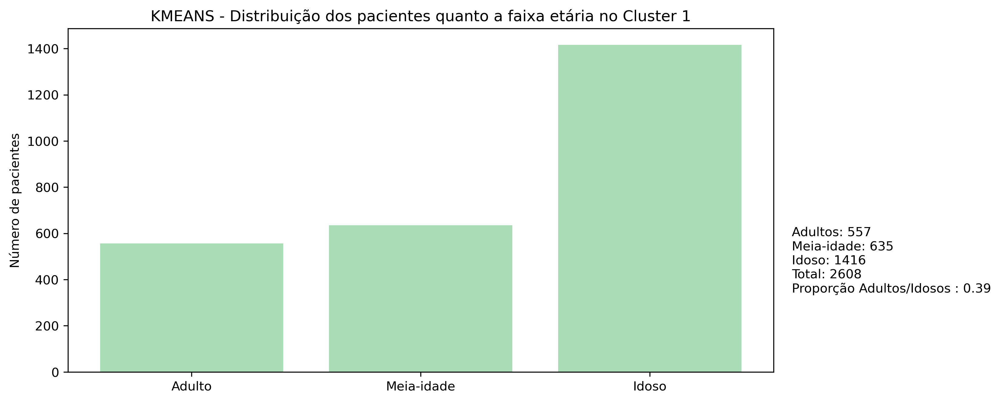

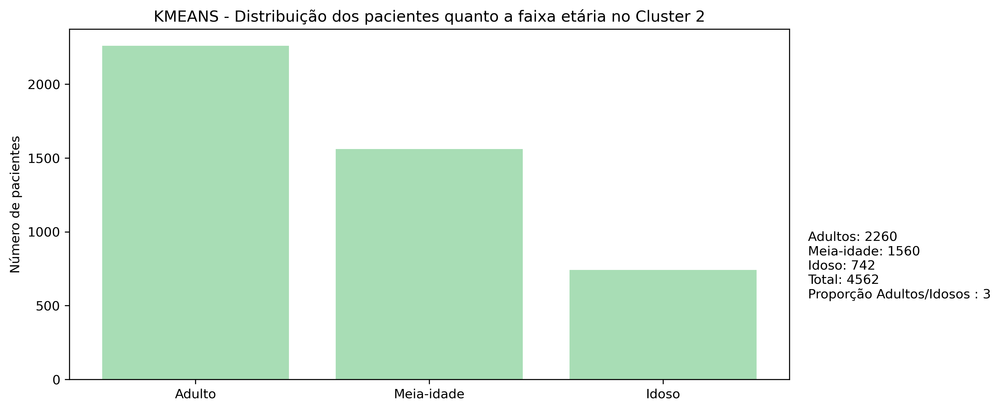

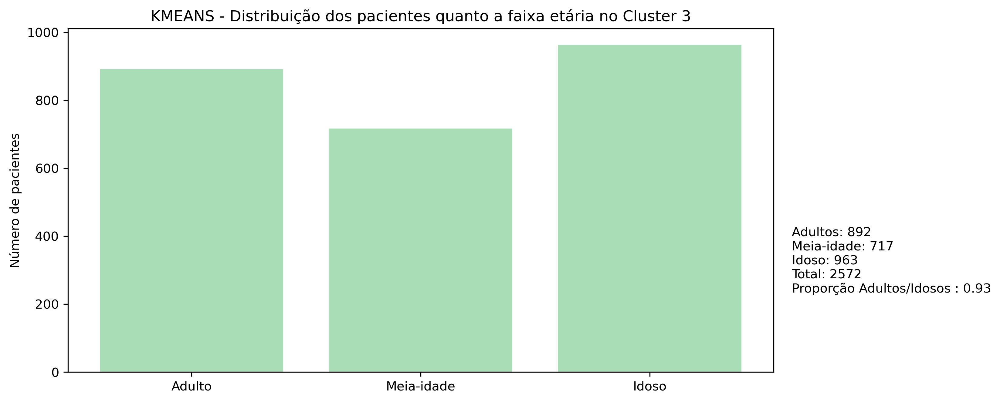

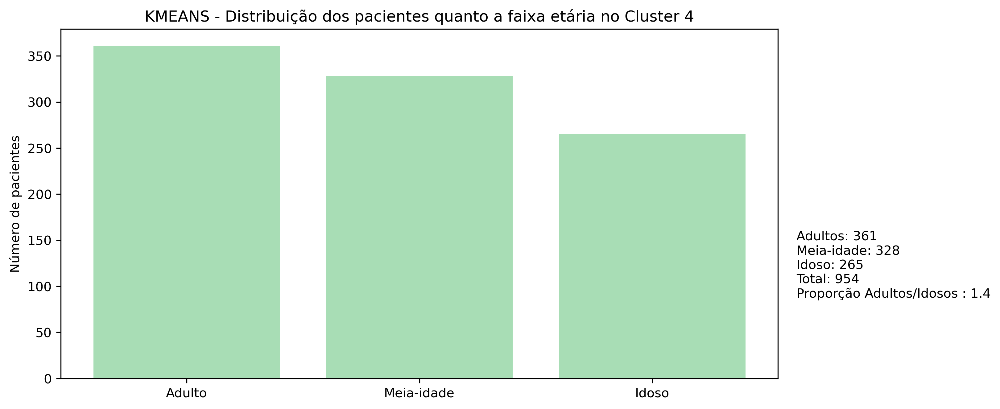

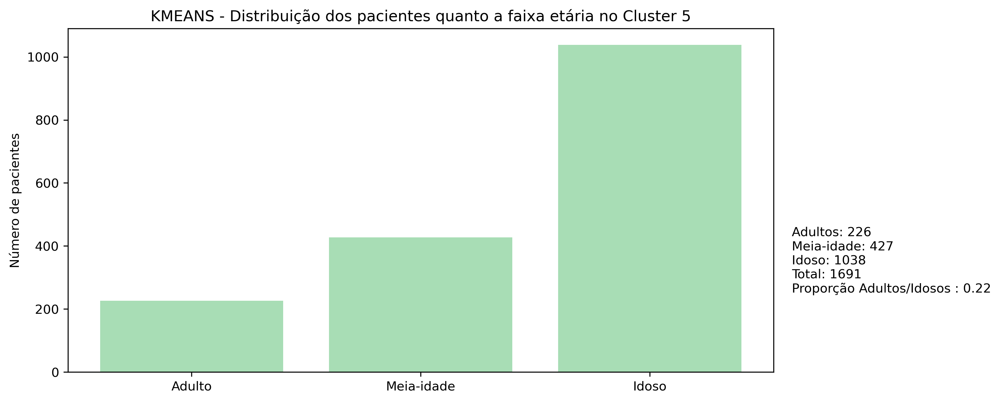

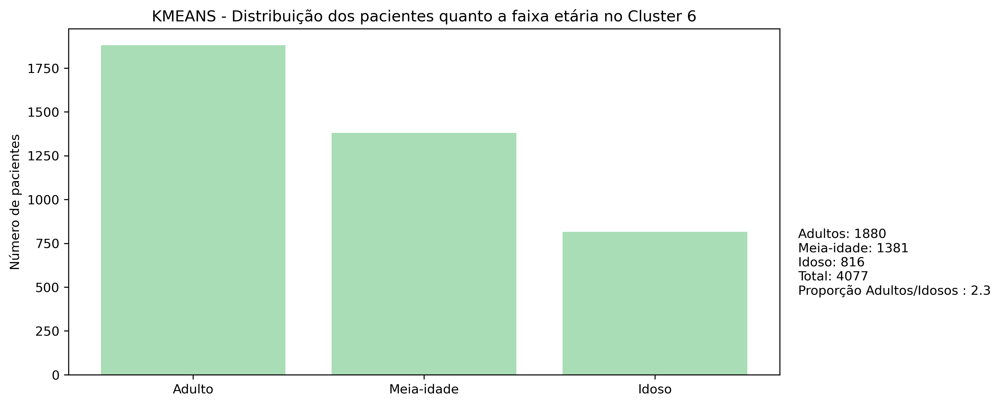

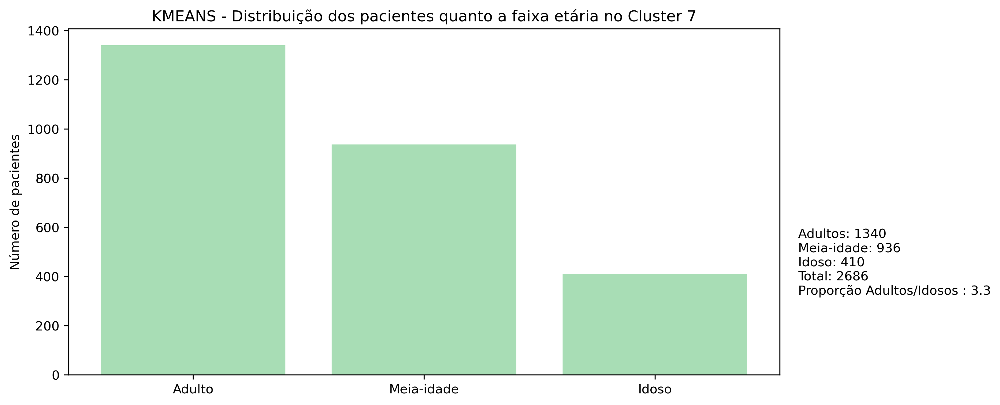

In [14]:
#
def faixas_etarias(idade):
    #classes = ["Adultos","Idoso"]
    #intervalos = [(0, 65),(65, 200)]
    classes = ["Adulto","Meia-idade","Idoso"]
    intervalos = [(0, 50),(50, 65),(65, 200)]
    #classes = ["Jovens","Adultos","Meia-idade","Idoso", "Ancião","Velhice extrema"]
    #intervalos = [(0, 20),(20, 45),(45, 60),(60, 75),(75, 90),(90, 200)]
    
    for faixa in range(len(classes)):
        if idade <= intervalos[faixa][1]:
            return classes[faixa]

try:    
    def plota_histograma_idade(dados,grupo):
        faixa_idade = dados['idade']
        faixa_idade = faixa_idade.apply(faixas_etarias)
        faixa_idade = faixa_idade.value_counts()
        faixa_idade = faixa_idade[['Adulto', 'Meia-idade','Idoso']]
        plt.bar(faixa_idade.index,faixa_idade, color="#a8ddb5")
        plt.gca().set(title=f'{algoritmo.upper()} - Distribuição dos pacientes quanto a faixa etária no Cluster {grupo}', 
                      ylabel='Número de pacientes')
        legenda = f"Adultos: {faixa_idade['Adulto']:n}\nMeia-idade: {faixa_idade['Meia-idade']:n}\nIdoso: {faixa_idade['Idoso']:n}"
        #legenda = f"Adultos: {faixa_idade['Adultos']:n}\nIdoso: {faixa_idade['Idoso']:n}"
        # Os operadores aumentados '+=', '-=', etc... fazem uma operação com, e guardam o resultado de volta, 
        # na variável da esquerda: a = 10; a += 5 , resulta em a == 15
        legenda += f"\nTotal: {faixa_idade['Adulto'] + faixa_idade['Meia-idade'] + faixa_idade['Idoso']}"
        legenda += "\n" + f"Proporção Adultos/Idosos : { faixa_idade['Adulto'] / faixa_idade['Idoso']:.02n}"
        plt.gcf().text(0.92, 0.3, legenda, fontsize=10)
        plt.savefig(DIR_GRAFICOS / "grafico_idade" / f"grafico_distribuicao_idade_cluster{grupo}.png", bbox_inches='tight')
        plt.show()
        

    for grupo in range(len(abordagem_medidas)):
        plota_histograma_idade(abordagem_medidas[grupo],grupo + 1)
except:
    pass

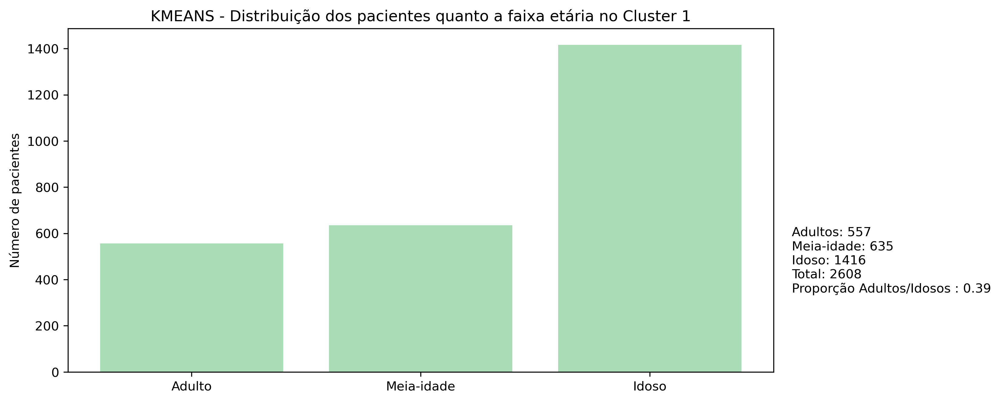

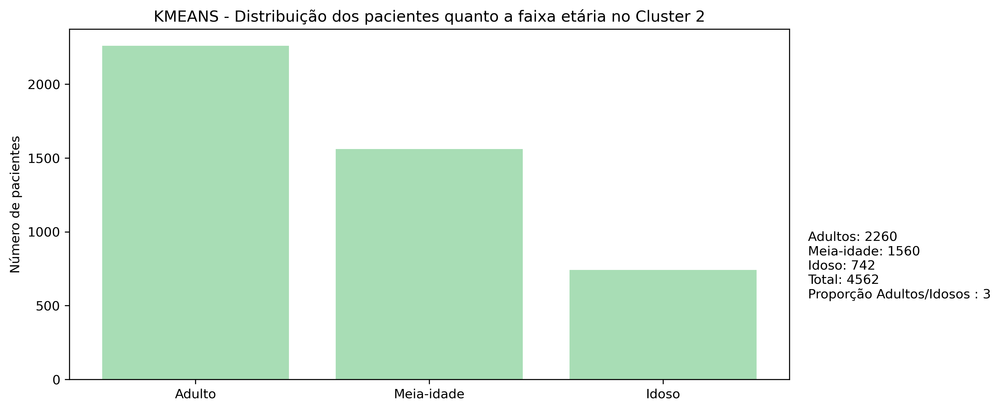

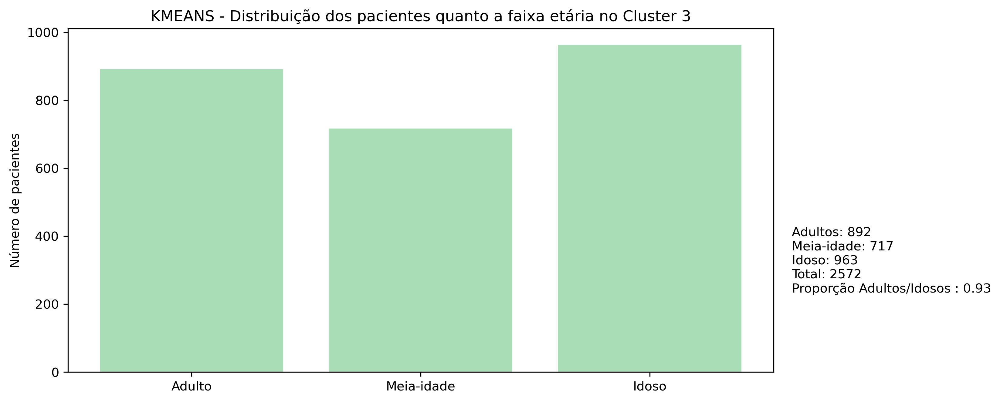

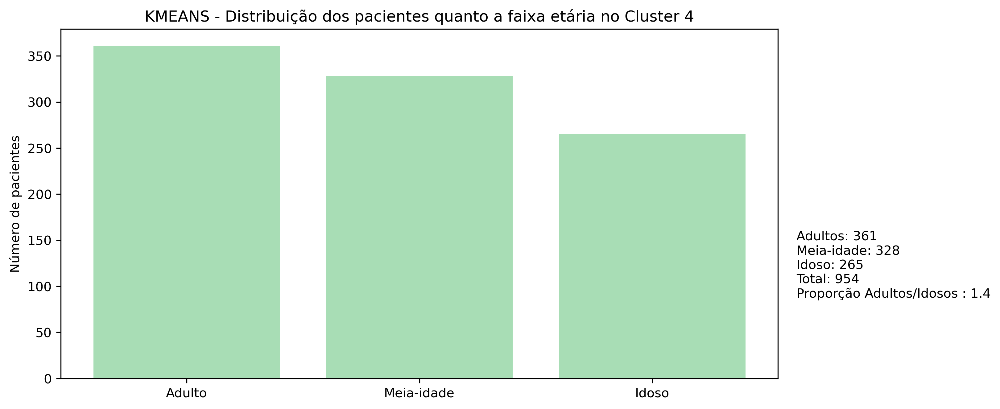

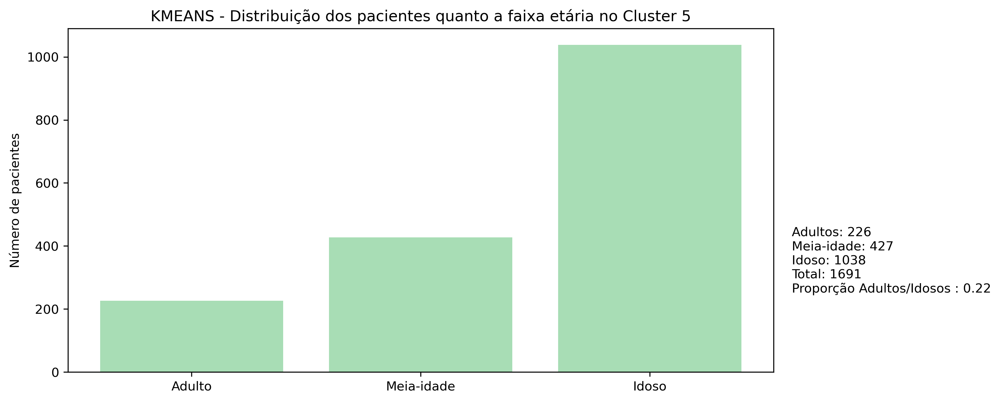

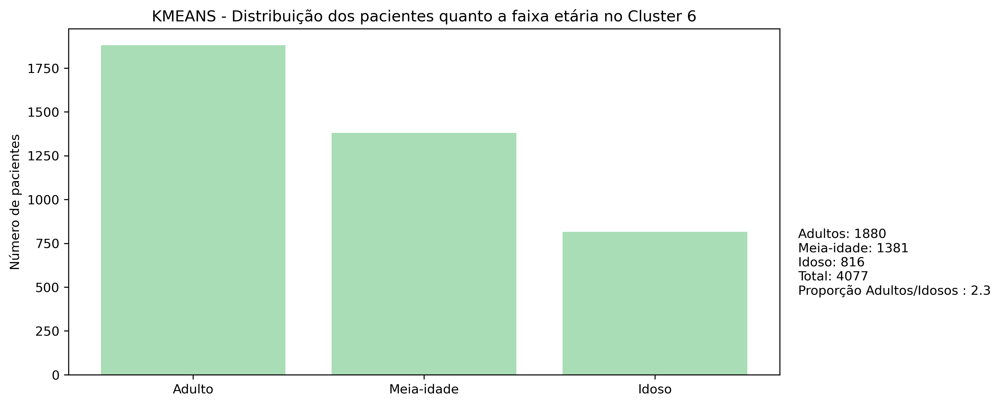

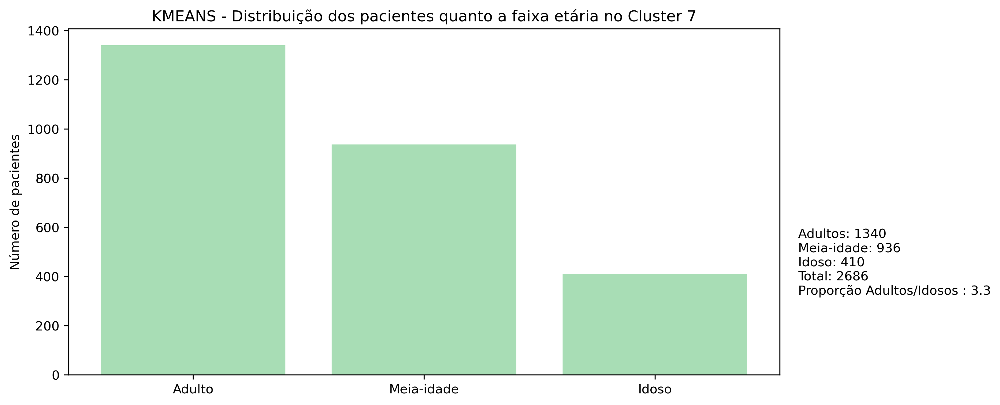

In [15]:
for grupo in range(len(abordagem_medidas)):
        plota_histograma_idade(abordagem_medidas[grupo],grupo + 1)

In [16]:
abordagem_medidas[grupo]

,numero_identificacao,data_nascimento,genero,idade,peso,altura,IMC,data_exame,grupo,sist 9:00,...,Mediana Diastolica em 24h,AUC Sistolica em 24h,AUC Diastolica em 24h,AUC PP Daytime,AUC PP Nighttime,DP Sistolica em 24h,DP Diastolica em 24h,Picos Sistolica,Picos Diastolica,Diferença % Dipping
0,17,1976-05-20,1,42.0,87.0,175,28.4,2018-12-26 10:12:44,7,145.0,...,89.5,10621.0,7194.0,2801.0,610.0,17.10,12.92,31,40,0.923
1,18,1953-04-18,0,65.0,72.0,172,24.3,2018-12-26 10:15:40,7,142.0,...,87.5,11003.5,6952.5,3237.0,735.5,19.88,13.93,43,33,1.025
2,24,1980-01-19,0,38.0,85.0,170,29.4,2018-12-26 10:37:07,7,117.0,...,89.0,9809.5,7159.5,2083.5,532.5,8.56,9.81,3,39,1.017
3,35,1964-11-28,1,54.0,74.0,"1,58",29.6,2018-12-26 15:14:33,7,130.0,...,88.5,10380.0,7101.0,2744.0,501.5,18.44,14.19,24,38,1.104
4,42,1969-10-11,0,49.0,74.0,"1,63",27.9,2018-12-26 17:28:58,7,111.0,...,90.0,10280.5,7302.0,2422.5,512.0,13.19,13.28,7,40,1.038
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2681,21747,1953-01-20,1,67.0,69.0,167,24.7,2020-09-10 09:54:14,7,138.0,...,89.0,10144.5,6943.5,2627.0,536.0,12.98,11.78,11,38,1.164
2682,21751,1982-01-15,1,38.0,90.0,171,30.8,2020-09-10 10:25:06,7,115.0,...,89.5,11076.5,7272.5,3190.0,576.5,15.85,12.77,32,41,1.181
2683,21757,1990-05-25,0,30.0,70.0,"1,55",29.1,2020-09-10 11:08:52,7,137.0,...,85.0,10287.5,6830.0,2751.0,635.0,11.53,8.23,9,19,0.933
2684,21760,1983-05-27,1,37.0,89.0,175,29.1,2020-09-10 11:24:21,7,126.0,...,88.5,10436.5,7411.0,2493.5,483.0,18.63,16.54,21,38,1.166


In [17]:
def faixas_imc(imc):
    #classes = ["Peso Normal","Obesidade"]
    #intervalos = [(0, 25),(25, 1000)]
    classes = ["Peso Normal","Sobrepeso", "Obesidade"]
    intervalos = [(0, 25),(25, 30),(30, 1000)]
    #classes = ["baixo peso","normal","sobrepeso","obesimc grau I","obesimc grau II","obesimc Grau III"]
    #intervalos = [(0, 18),(18, 25),(25, 30),(30, 35),(35, 40),(40, 1000)]
    
    for faixa in range(len(classes)):
        if imc <= intervalos[faixa][1]:
            return classes[faixa]

def faixas_etarias(idade):
    classes = ["Adultos","Meia-idade","Idoso"]
    intervalos = [(0, 50),(50, 65),(65, 200)]
    
#    classes = ["Jovens","Adultos","Meia-idade","Idoso", "Ancião","Velhice extrema"]
#    intervalos = [(0, 20),(20, 45),(45, 60),(60, 75),(75, 90),(90, 200)]
    
    for faixa in range(len(classes)):
        if idade <= intervalos[faixa][1]:
            return classes[faixa]
        

def faixa_genero(abordagem):
    total = len(abordagem)
    masculino = len(abordagem[abordagem['genero'] == 1])
    feminino = len(abordagem[abordagem['genero'] == 0])
    indeterminado = total - masculino - feminino
    faixas = [masculino, np.round(masculino/total * 100, 2),feminino, np.round(feminino/total * 100, 2)]
    return faixas

lista_faixa_idade = ["Adultos","Meia-idade","Idoso"]
lista_faixa_imc = ["Peso Normal","Sobrepeso", "Obesidade"]

## Gráfico da Distribuição dos pac quanto ao IMC

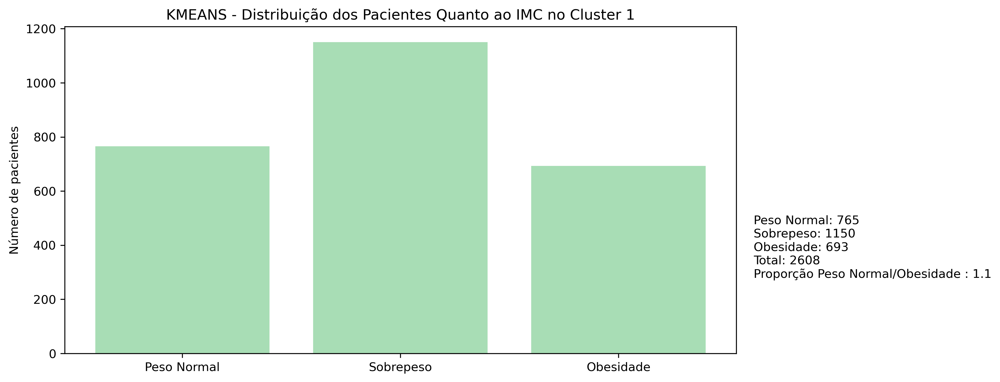

In [18]:
try:    
    def plota_histograma_imc(dados,grupo):
        faixa_imc = dados['IMC']
        faixa_imc = faixa_imc.apply(faixas_imc)
        faixa_imc = faixa_imc.value_counts()
        faixa_imc = faixa_imc[["Peso Normal","Sobrepeso","Obesidade"]]
        plt.bar(faixa_imc.index,faixa_imc, color="#a8ddb5")
        plt.gca().set(title=f'{algoritmo.upper()} - Distribuição dos Pacientes Quanto ao IMC no Cluster {grupo}', 
                      ylabel='Número de pacientes')
        legenda = f"Peso Normal: {faixa_imc['Peso Normal']:n}\nSobrepeso: {faixa_imc['Sobrepeso']:n}\nObesidade: {faixa_imc['Obesidade']:n}"
        #legenda = f"Peso Normal: {faixa_imc['Peso Normal']:n}\nObesidade: {faixa_imc['Obesidade']:n}"
        # Os operadores aumentados '+=', '-=', etc... fazem uma operação com, e guardam o resultado de volta, na variável da esquerda:
        # a = 10; a += 5 , resulta em a == 15
        ########################################################################################
        #  proporção em relação a Sobrepeso + Obesidade
        ################################################################
        legenda += f"\nTotal: {faixa_imc['Peso Normal'] + faixa_imc['Sobrepeso'] + faixa_imc['Obesidade']}"
        legenda += "\n" + f"Proporção Peso Normal/Obesidade : { faixa_imc['Peso Normal'] / faixa_imc['Obesidade']:.02n}"
        plt.gcf().text(0.92, 0.3, legenda, fontsize=10)
        plt.savefig(DIR_GRAFICOS / "grafico_imc" / f"grafico_distribuicao_imc_cluster{grupo}.png", bbox_inches='tight')
        plt.show()
        

    for grupo in range(len(abordagem_medidas)):
        plota_histograma_imc(abordagem_medidas[grupo],grupo + 1)
except:
    pass

## Qtd da Abordagem Estatísitica

In [19]:
try:
    qtd_estatistica = pd.DataFrame()

    qtd_estatistica['Cluster'] = [f'cluster {n}' for n in range(1,len(abordagem_estatistica) + 1)]
    qtd_estatistica['QTD Pacientes'] = [len(n) for n in abordagem_estatistica]

    total_pacientes = np.sum([len(n) for n in abordagem_estatistica])

    qtd_estatistica['QTD Pacientes %'] = [np.round(len(n)/total_pacientes*100,2) for n in abordagem_estatistica]


    for analise in range(len(lista_calculo)):
        lista_analise = list()
        for grupo in range(len(abordagem_estatistica)):
            lista_analise.append(funcao[analise](abordagem_estatistica[grupo]))

        qtd_estatistica[lista_calculo[analise]] = lista_analise

    qtd_estatistica = qtd_estatistica.T.reset_index()
    qtd_estatistica.columns = qtd_estatistica.iloc[0,:]
    qtd_estatistica = qtd_estatistica.iloc[1:,:]
    #  grava arquivo com qtd e % das doenças em cada grupo
    qtd_estatistica.to_csv(DIR_ABORDAGENS / "approach_estatistica" / f"{algoritmo.upper()}_qtd_approach_estatistica.csv", 
                           sep=";", encoding="latin1", index=False)
except:
    pass

In [20]:
qtd_estatistica

,Cluster,cluster 1,cluster 2,cluster 3,cluster 4,cluster 5,cluster 6,cluster 7
1,QTD Pacientes,4208,4495,628,3224,1976,2061,2558
2,QTD Pacientes %,21.97,23.47,3.28,16.84,10.32,10.76,13.36
3,Media Sistolica em 24h,115.12,125.25,154.45,120.11,136.93,134.57,106.85
4,Media Diastolica em 24h,76.3,82.63,90.11,68.0,91.92,74.92,65.74
5,Media Sistolica Daytime,116.65,126.95,155.82,121.57,138.64,136.12,108.19
6,Media Sistolica Nighttime,107.7,117.0,147.82,113.0,128.6,127.04,100.35
7,Media Diastolica Daytime,78.1,84.54,91.52,69.38,93.82,76.27,67.21
8,Media Diastolica Nighttime,67.57,73.32,83.23,61.28,82.67,68.35,58.63
9,Variancia Sistolica em 24h,133.25,167.28,352.14,187.73,199.15,268.83,125.92
10,Variancia Diastolica em 24h,108.57,122.56,161.18,105.32,139.7,121.28,92.03


## Qtd da Abordagem Doença

In [21]:
# Quantidade da abordagem por doença
try:
    lista_doencas = list(abordagem_doenca[0].loc[:,'Hipotensao':'Normotenso'].columns)

    qtd_doencas = pd.DataFrame()

    qtd_doencas['Cluster'] = [f'cluster {n}' for n in range(1,len(abordagem_doenca) + 1)]

    total_pacientes = np.sum([len(n) for n in abordagem_doenca])

    qtd_doencas['QTD Pacientes'] = [len(n) for n in abordagem_doenca]

    qtd_doencas['QTD Pacientes %'] = [np.round(len(n)/total_pacientes*100,2) for n in abordagem_doenca]

    for doenca in lista_doencas:
        lista_qtd = []
        lista_porcentagem = []
        for grupo in range(len(abordagem_doenca)):
            lista_qtd.append(len(abordagem_doenca[grupo][abordagem_doenca[grupo][doenca] == True]))
            lista_porcentagem.append(round(lista_qtd[grupo]/len(abordagem_doenca[grupo][doenca]) * 100,2))
        qtd_doencas[doenca] = lista_qtd
        qtd_doencas[f'{doenca} %'] = lista_porcentagem
    
    lista_descenso = []
    for grupo in range(len(abordagem_doenca)):
        lista_descenso.append(descenso_noturno(abordagem_doenca[grupo]))
    
    qtd_doencas['Descenso Noturno %'] = lista_descenso
        
    qtd_doencas = qtd_doencas.T.reset_index()
    qtd_doencas.columns = qtd_doencas.iloc[0,:]
    qtd_doencas = qtd_doencas.iloc[1:,:]
    #  grava arquivo com qtd e % das doenças em cada grupo
    qtd_doencas.to_csv(DIR_ABORDAGENS / f"{algoritmo.upper()}_qtd_approach_doenca.csv", 
                            sep=";", encoding="latin1", index=False)
except:
    pass

In [22]:
qtd_doencas

,Cluster,cluster 1,cluster 2,cluster 3,cluster 4,cluster 5,cluster 6,cluster 7
1,QTD Pacientes,1073,3314,4858,2859,1316,2979,2751
2,QTD Pacientes %,5.6,17.31,25.37,14.93,6.87,15.56,14.37
3,Hipotensao,0,3125,4858,2512,1275,2732,2751
4,Hipotensao %,0.0,94.3,100.0,87.86,96.88,91.71,100.0
5,Sistolica Isolada,9,1,2,6,0,1,4
6,Sistolica Isolada %,0.84,0.03,0.04,0.21,0.0,0.03,0.15
7,Diastolica Isolada,26,3,15,12,0,2,22
8,Diastolica Isolada %,2.42,0.09,0.31,0.42,0.0,0.07,0.8
9,Dipping,0,3314,0,0,0,2979,0
10,Dipping %,0.0,100.0,0.0,0.0,0.0,100.0,0.0


In [23]:
abordagem_cadastro[0]

,numero_identificacao,data_nascimento,genero,idade,peso,altura,IMC,data_exame,grupo,sist 9:00,...,Mediana Diastolica em 24h,AUC Sistolica em 24h,AUC Diastolica em 24h,AUC PP Daytime,AUC PP Nighttime,DP Sistolica em 24h,DP Diastolica em 24h,Picos Sistolica,Picos Diastolica,Diferença % Dipping
0,14,1932-05-28,0,86.0,59.0,149,26.6,2018-12-26 10:06:10,1,107.0,...,66.5,8810.5,5280.5,2900.5,574.0,8.00,7.76,11,16,1.115
1,22,1962-06-19,0,56.0,80.0,155,33.3,2018-12-26 10:27:20,1,112.0,...,68.0,8594.0,5428.0,2655.0,470.5,14.28,13.64,22,25,1.178
2,23,1956-09-01,0,62.0,73.0,160,28.5,2018-12-26 10:29:28,1,122.0,...,61.5,8597.0,5037.0,2987.5,540.0,14.05,11.01,25,36,1.133
3,28,1958-07-13,0,60.0,49.0,167,17.6,2018-12-26 11:40:47,1,97.0,...,51.0,8295.0,4108.0,3493.0,635.5,9.30,5.46,30,79,1.071
4,33,1982-09-03,0,36.0,71.0,163,26.7,2018-12-26 13:50:59,1,108.0,...,68.0,9739.0,5426.5,3495.5,767.0,11.31,12.02,7,24,1.054
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2974,21755,1953-12-11,0,66.0,60.0,163,22.6,2020-09-10 10:48:47,1,125.0,...,72.0,8914.5,5700.5,2634.0,548.5,11.52,8.54,18,12,1.054
2975,21756,1935-11-06,0,84.0,80.0,"1,67",28.7,2020-09-10 11:04:38,1,140.0,...,62.0,10291.0,4948.5,4353.5,920.5,21.24,8.10,31,33,0.910
2976,21779,1947-04-19,0,73.0,71.0,159,28.1,2020-09-10 15:13:35,1,137.0,...,68.5,9369.5,5393.5,3321.0,604.0,13.22,10.18,14,19,1.085
2977,21788,1985-03-15,0,35.0,93.0,167,33.3,2020-09-10 16:44:53,1,107.0,...,62.5,9245.0,4935.5,3556.0,713.5,13.56,8.00,15,28,1.029


## Qtd da Abordagem Cadastro

In [24]:
# Quantidade da abordagem por dados cadastrais
try:
    qtd_dados_cadastrais = pd.DataFrame()

    qtd_dados_cadastrais['Cluster'] = [f'cluster {n}' for n in range(1,len(abordagem_cadastro) + 1)]
    qtd_dados_cadastrais['QTD Pacientes'] = [len(n) for n in abordagem_cadastro]
    total_pacientes = np.sum([len(n) for n in abordagem_cadastro])
    qtd_dados_cadastrais['QTD Pacientes %'] = [np.round(len(n)/total_pacientes*100,2) for n in abordagem_cadastro]
    lista_total_grupos = [len(i) for i in abordagem_cadastro]
    lista_total_grupos = np.array(lista_total_grupos)

    lista_faixa_genero = ['Masculino','Masculino %','Feminino','Feminino %']

    colunas_genero = [[],[],[],[]]
    for grupo in range(len(abordagem_cadastro)):
        resultado = faixa_genero(abordagem_cadastro[grupo])
        colunas_genero[0].append(resultado[0])
        colunas_genero[1].append(resultado[1])
        colunas_genero[2].append(resultado[2])
        colunas_genero[3].append(resultado[3])

    for faixa in range(len(lista_faixa_genero)):
        qtd_dados_cadastrais[lista_faixa_genero[faixa]] = colunas_genero[faixa]

    #lista_faixa_idade = ["Adultos","Meia-idade","Idoso"]
    #lista_faixa_idade = ["Jovens","Adultos","Meia-idade","Idoso", "Ancião","Velhice extrema"]

    for faixa in range(len(lista_faixa_idade)):
        lista_grupos = list()

        for grupo in range(len(abordagem_cadastro)):
            lista_grupos.append(len(abordagem_cadastro[grupo][abordagem_cadastro[grupo]['idade']
                                                              .apply(faixas_etarias) == lista_faixa_idade[faixa]]))

        np.array(lista_grupos)
        qtd_dados_cadastrais[lista_faixa_idade[faixa]] = lista_grupos
        qtd_dados_cadastrais[f'{lista_faixa_idade[faixa]} %'] = np.round(lista_grupos / lista_total_grupos * 100, 2)

    #lista_faixa_imc = ["Peso Normal","Sobrepeso", "Obesidade"]
    #lista_faixa_imc = ["Abaixo do peso","Peso Normal","Sobrepeso","Obesidade grau 1","Obesidade grau 2","Obesidade Grau 3"]
#################################################################################
    for faixa in range(len(lista_faixa_imc)):
        lista_grupos = list()

        for grupo in range(len(abordagem_cadastro)):
            lista_grupos.append(len(abordagem_cadastro[grupo][abordagem_cadastro[grupo]['IMC'].apply(faixas_imc) == lista_faixa_imc[faixa]]))

        np.array(lista_grupos)
        qtd_dados_cadastrais[lista_faixa_imc[faixa]] = lista_grupos
        qtd_dados_cadastrais[f'{lista_faixa_imc[faixa]} %'] = np.round(lista_grupos / lista_total_grupos * 100, 2)
    
    #qtd_dados_cadastrais['Não obeso'] = qtd_dados_cadastrais['Peso Normal'] + qtd_dados_cadastrais['Sobrepeso']
    
    lista_descenso = []
    for grupo in range(len(abordagem_cadastro)):
        lista_descenso.append(descenso_noturno(abordagem_cadastro[grupo]))
    
    qtd_dados_cadastrais['Descenso Noturno %'] = lista_descenso
    
    qtd_dados_cadastrais = qtd_dados_cadastrais.T.reset_index()
    qtd_dados_cadastrais.columns = qtd_dados_cadastrais.iloc[0,:]
    qtd_dados_cadastrais = qtd_dados_cadastrais.iloc[1:,:]
    #  grava arquivo com qtd e % das doenças em cada grupo
    qtd_dados_cadastrais.to_csv(DIR_ABORDAGENS / f"{algoritmo.upper()}_qtd_approach_cadastro.csv", 
                           sep=";", encoding="latin1", index=False)
except:
    pass

In [25]:
qtd_dados_cadastrais

,Cluster,cluster 1,cluster 2,cluster 3,cluster 4,cluster 5,cluster 6
1,QTD Pacientes,2979,4380,2722,4082,1250,3737
2,QTD Pacientes %,15.56,22.87,14.21,21.32,6.53,19.51
3,Masculino,40,0,0,4082,845,3737
4,Masculino %,1.34,0.0,0.0,100.0,67.6,100.0
5,Feminino,2939,4380,2722,0,405,0
6,Feminino %,98.66,100.0,100.0,0.0,32.4,0.0
7,Adultos,964,1455,905,1977,510,1705
8,Adultos %,32.36,33.22,33.25,48.43,40.8,45.62
9,Meia-idade,877,1494,912,1276,422,1003
10,Meia-idade %,29.44,34.11,33.5,31.26,33.76,26.84


## Qtd da Abordagem Medidas considerando o total de Não Obesos (normal+sobrepeso)

In [26]:
# Quantidade da abordagem por medidas quantificando as classes incluindo o 
# total de Não obesos (somatória de Peso Normal e Sobrepeso)
#
try:
    qtd_dados_medidas = pd.DataFrame()

    qtd_dados_medidas['Cluster'] = [f'cluster {n}' for n in range(1,len(abordagem_medidas) + 1)]
    qtd_dados_medidas['QTD Pacientes'] = [len(n) for n in abordagem_medidas]
    total_pacientes = np.sum([len(n) for n in abordagem_medidas])
    qtd_dados_medidas['QTD Pacientes %'] = [np.round(len(n)/total_pacientes*100,2) for n in abordagem_medidas]
    lista_total_grupos = [len(i) for i in abordagem_medidas]
    lista_total_grupos = np.array(lista_total_grupos)
    lista_faixa_genero = ['Masculino','Masculino %','Feminino','Feminino %']

    colunas_genero = [[],[],[],[],[],[]]
    for grupo in range(len(abordagem_medidas)):
        resultado = faixa_genero(abordagem_medidas[grupo])
        colunas_genero[0].append(resultado[0])
        colunas_genero[1].append(resultado[1])
        colunas_genero[2].append(resultado[2])
        colunas_genero[3].append(resultado[3])

    for faixa in range(len(lista_faixa_genero)):
        qtd_dados_medidas[lista_faixa_genero[faixa]] = colunas_genero[faixa]

    #lista_faixa_idade = ["Adultos","Meia-idade","Idoso"]
    #lista_faixa_idade = ["Jovens","Adultos","Meia-idade","Idoso", "Ancião","Velhice extrema"]


    for faixa in range(len(lista_faixa_idade)):
        lista_grupos = list()
        
        for grupo in range(len(abordagem_medidas)):
            lista_grupos.append(len(abordagem_medidas[grupo][abordagem_medidas[grupo]['idade'].apply(faixas_etarias) == lista_faixa_idade[faixa]]))
        np.array(lista_grupos)
        qtd_dados_medidas[lista_faixa_idade[faixa]] = lista_grupos
        qtd_dados_medidas[f'{lista_faixa_idade[faixa]} %'] = np.round(lista_grupos / lista_total_grupos * 100, 2)


    #lista_faixa_imc = ["peso normal","sobrepeso", "obesidade"]
    #lista_faixa_imc = ["Abaixo do peso","Peso Normal","Sobrepeso","Obesidade grau 1","Obesidade grau 2","Obesidade Grau 3"]
    
#################################################################################################
    for faixa in range(len(lista_faixa_imc)):
        lista_grupos = list()
        
        for grupo in range(len(abordagem_medidas)):
            lista_grupos.append(len(abordagem_medidas[grupo][abordagem_medidas[grupo]['IMC'].apply(faixas_imc) == lista_faixa_imc[faixa]]))
        np.array(lista_grupos)
        qtd_dados_medidas[lista_faixa_imc[faixa]] = lista_grupos
        qtd_dados_medidas[f'{lista_faixa_imc[faixa]} %'] = np.round(lista_grupos / lista_total_grupos * 100, 2)
    
    qtd_dados_medidas['Não obeso'] = qtd_dados_medidas['Peso Normal'] + qtd_dados_medidas['Sobrepeso']
    qtd_dados_medidas['Não obeso %'] =  np.round(qtd_dados_medidas['Não obeso'] / lista_total_grupos * 100, 2)
    
    lista_calculo = ['Media Sistolica em 24h','Media Diastolica em 24h','Media Sistolica Daytime','Media Sistolica Nighttime',
                    'Media Diastolica Daytime','Media Diastolica Nighttime','Variancia Sistolica em 24h','Variancia Diastolica em 24h',
                    'Mediana Sistolica em 24h', 'Mediana Diastolica em 24h','AUC Sistolica em 24h','AUC Diastolica em 24h',
                     'DP Sistolica em 24h','DP Diastolica em 24h']

    funcao = [media_sistolica,media_diastolica,media_sistolica_dia,media_sistolica_noite,media_diastolica_dia,
               media_diastolica_noite,variancia_sistolica,variancia_diastolica,mediana_sistolica,mediana_diastolica,
              auc_sistolica,auc_diastolica,desvio_sistolica,desvio_diastolica]

    for analise in range(len(lista_calculo)):
        lista_analise = list()
        for grupo in range(len(abordagem_medidas)):
            lista_analise.append(funcao[analise](abordagem_medidas[grupo]))

        qtd_dados_medidas[lista_calculo[analise]] = lista_analise
    
    lista_descenso = []
    for grupo in range(len(abordagem_medidas)):
        lista_descenso.append(descenso_noturno(abordagem_medidas[grupo]))

    qtd_dados_medidas['Descenso Noturno %'] = lista_descenso
    qtd_dados_medidas_sem_T = qtd_dados_medidas
    qtd_dados_medidas = qtd_dados_medidas.T.reset_index()
    qtd_dados_medidas.columns = qtd_dados_medidas.iloc[0,:]
    qtd_dados_medidas = qtd_dados_medidas.iloc[1:,:]
    #  grava arquivo com qtd e % das doenças em cada grupo
    qtd_dados_medidas.to_csv(DIR_ABORDAGENS /  f"{algoritmo.upper()}_qtd_approach_medidas.csv", 
                           sep=";", encoding="latin1", index=False)
    
except:
    pass

In [27]:
qtd_dados_medidas

,Cluster,cluster 1,cluster 2,cluster 3,cluster 4,cluster 5,cluster 6,cluster 7
1,QTD Pacientes,2608,4562,2572,954,1691,4077,2686
2,QTD Pacientes %,13.62,23.82,13.43,4.98,8.83,21.29,14.03
3,Masculino,854,2585,636,521,634,1854,1620
4,Masculino %,32.75,56.66,24.73,54.61,37.49,45.47,60.31
5,Feminino,1754,1977,1936,433,1057,2223,1066
6,Feminino %,67.25,43.34,75.27,45.39,62.51,54.53,39.69
7,Adultos,557,2260,892,361,226,1880,1340
8,Adultos %,21.36,49.54,34.68,37.84,13.36,46.11,49.89
9,Meia-idade,635,1560,717,328,427,1381,936
10,Meia-idade %,24.35,34.2,27.88,34.38,25.25,33.87,34.85


## QTD Escolho Doença

In [28]:
# Quantidade da abordagem por range de doença sem Hipertensão e sem Normotenso
try:
    
    lista_escolho_doenca = list(abordagem_escolho_doenca[0].loc[:,'Sistolica Isolada':'Whitecoat'].columns)
    # lista_escolho_doenca = list(abordagem_escolho_doenca[0].loc[:,'Hipotensao':'Normotenso'].columns)

    qtd_escolho_doenca = pd.DataFrame()

    qtd_escolho_doenca['Cluster'] = [f'cluster {n}' for n in range(1,len(abordagem_escolho_doenca) + 1)]
    
    total_pacientes = np.sum([len(n) for n in abordagem_escolho_doenca])

    qtd_escolho_doenca['QTD Pacientes'] = [len(n) for n in abordagem_escolho_doenca]

    qtd_escolho_doenca['QTD Pacientes %'] = [np.round(len(n)/total_pacientes*100,2) for n in abordagem_escolho_doenca]

    for doenca in lista_escolho_doenca:
        lista_qtd_escolho_doenca = []
        lista_porcentagem_escolho_doenca = []
        for grupo in range(len(abordagem_escolho_doenca)):
            lista_qtd_escolho_doenca.append(len(abordagem_escolho_doenca[grupo][abordagem_escolho_doenca[grupo][doenca] == True]))
            lista_porcentagem_escolho_doenca.append(round(lista_qtd_escolho_doenca[grupo]/len(abordagem_escolho_doenca[grupo][doenca]) * 100,2))
        
        qtd_escolho_doenca[doenca] = lista_qtd_escolho_doenca
        qtd_escolho_doenca[f'{doenca} %'] = lista_porcentagem_escolho_doenca

    lista_descenso = []
    for grupo in range(len(abordagem_escolho_doenca)):
        lista_descenso.append(descenso_noturno(abordagem_escolho_doenca[grupo]))
    
    qtd_escolho_doenca['Descenso Noturno %'] = lista_descenso
    
    qtd_escolho_doenca = qtd_escolho_doenca.T.reset_index()
    qtd_escolho_doenca.columns = qtd_escolho_doenca.iloc[0,:]
    qtd_escolho_doenca = qtd_escolho_doenca.iloc[1:,:]

    #  grava arquivo com qtd e % das doenças em cada grupo
    qtd_escolho_doenca.to_csv(DIR_ABORDAGENS / f"{algoritmo.upper()}_qtd_approach_escolho_doenca.csv", 
                            sep=";", encoding="latin1", index=False)
except:
    pass

## QTD DOENÇA Sem Extremos (HIPOTENSÃO e NORMOTENSO)

In [29]:
# Quantidade da abordagem por range de doença sem Hipertensão e sem Normotenso
try:
    
    lista_doenca_sem_extremos = list(abordagem_doenca_sem_extremos[0].loc[:,'Sistolica Isolada':'Whitecoat'].columns)
    # lista_doenca_sem_extremos = list(abordagem_doenca_sem_extremos[0].loc[:,'Hipotensao':'Normotenso'].columns)

    qtd_doenca_sem_extremos = pd.DataFrame()

    qtd_doenca_sem_extremos['Cluster'] = [f'cluster {n}' for n in range(1,len(abordagem_doenca_sem_extremos) + 1)]
    
    total_pacientes = np.sum([len(n) for n in abordagem_doenca_sem_extremos])

    qtd_doenca_sem_extremos['QTD Pacientes'] = [len(n) for n in abordagem_doenca_sem_extremos]

    qtd_doenca_sem_extremos['QTD Pacientes %'] = [np.round(len(n)/total_pacientes*100,2) for n in abordagem_doenca_sem_extremos]

    for doenca in lista_doenca_sem_extremos:
        lista_qtd_doenca_sem_extremos = []
        lista_porcentagem_doenca_sem_extremos = []
        for grupo in range(len(abordagem_doenca_sem_extremos)):
            lista_qtd_doenca_sem_extremos.append(len(abordagem_doenca_sem_extremos[grupo][abordagem_doenca_sem_extremos[grupo][doenca] == True]))
            lista_porcentagem_doenca_sem_extremos.append(round(lista_qtd_doenca_sem_extremos[grupo]/len(abordagem_doenca_sem_extremos[grupo][doenca]) * 100,2))
        
        qtd_doenca_sem_extremos[doenca] = lista_qtd_doenca_sem_extremos
        qtd_doenca_sem_extremos[f'{doenca} %'] = lista_porcentagem_doenca_sem_extremos

    lista_descenso = []
    for grupo in range(len(abordagem_doenca_sem_extremos)):
        lista_descenso.append(descenso_noturno(abordagem_doenca_sem_extremos[grupo]))
    
    qtd_doenca_sem_extremos['Descenso Noturno %'] = lista_descenso
    
    qtd_doenca_sem_extremos = qtd_doenca_sem_extremos.T.reset_index()
    qtd_doenca_sem_extremos.columns = qtd_doenca_sem_extremos.iloc[0,:]
    qtd_doenca_sem_extremos = qtd_doenca_sem_extremos.iloc[1:,:]

    #  grava arquivo com qtd e % das doenças em cada grupo
    qtd_doenca_sem_extremos.to_csv(DIR_ABORDAGENS / f"{algoritmo.upper()}_qtd_approach_doenca_sem_extremos.csv", 
                            sep=";", encoding="latin1", index=False)
except:
    pass

In [30]:
qtd_doenca_sem_extremos

,Cluster,cluster 1,cluster 2,cluster 3,cluster 4,cluster 5,cluster 6,cluster 7,cluster 8
1,QTD Pacientes,1933,5814,2070,1978,2868,2290,1316,881
2,QTD Pacientes %,10.09,30.36,10.81,10.33,14.98,11.96,6.87,4.6
3,Sistolica Isolada,1,4,0,2,11,1,0,4
4,Sistolica Isolada %,0.05,0.07,0.0,0.1,0.38,0.04,0.0,0.45
5,Diastolica Isolada,3,34,1,3,29,1,0,9
6,Diastolica Isolada %,0.16,0.58,0.05,0.15,1.01,0.04,0.0,1.02
7,Dipping,1933,0,2070,0,0,2290,0,0
8,Dipping %,100.0,0.0,100.0,0.0,0.0,100.0,0.0,0.0
9,Non Dipping,0,5813,0,0,2868,0,0,0
10,Non Dipping %,0.0,99.98,0.0,0.0,100.0,0.0,0.0,0.0


## QTD da Abordagem CATEGORIA

In [31]:
# Quantidade dos dados cadastrais
try:
    qtd_categoria = pd.DataFrame()

    qtd_categoria['Cluster'] = [f'cluster {n}' for n in range(1,len(abordagem_categorias) + 1)]
    qtd_categoria['QTD Pacientes'] = [len(n) for n in abordagem_categorias]
    total_pacientes = np.sum([len(n) for n in abordagem_categorias])
    qtd_categoria['QTD Pacientes %'] = [np.round(len(n)/total_pacientes*100,2) for n in abordagem_categorias]
    lista_total_grupos = [len(i) for i in abordagem_categorias]
    lista_total_grupos = np.array(lista_total_grupos)
    
#  SEXO
    # lista_faixa_genero = ['Masculino','Masculino %','Feminino','Feminino %','Indeterminado','Indeterminado %']
    lista_sexo = ['Masculino','Masculino %','Feminino','Feminino %']

    colunas_sexo = [[],[],[],[]]
    for grupo in range(len(abordagem_categorias)):
        resultado = faixa_genero(abordagem_categorias[grupo])
        colunas_sexo[0].append(resultado[0])
        colunas_sexo[1].append(resultado[1])
        colunas_sexo[2].append(resultado[2])
        colunas_sexo[3].append(resultado[3])

    for faixa in range(len(lista_sexo)):
        qtd_categoria[lista_sexo[faixa]] = colunas_sexo[faixa]
        
#   IDADE
    #lista_faixa_idade = ["Adultos","Meia-idade","Idoso"]
    #lista_faixa_idade = ["Jovens","Adultos","Meia-idade","Idoso", "Ancião","Velhice extrema"]

    for faixa in range(len(lista_faixa_idade)):
        lista_grupos = list()

        for grupo in range(len(abordagem_categorias)):
            lista_grupos.append(len(abordagem_categorias[grupo][abordagem_categorias[grupo]['idade'].apply(faixas_etarias) == lista_faixa_idade[faixa]]))

        np.array(lista_grupos)
        qtd_categoria[lista_faixa_idade[faixa]] = lista_grupos
        qtd_categoria[f'{lista_faixa_idade[faixa]} %'] = np.round(lista_grupos / lista_total_grupos * 100, 2)

#   IMC
    #lista_faixa_imc = ["Peso Normal","Sobrepeso", "Obesidade"]
    #lista_faixa_imc = ["Abaixo do peso","Peso Normal","Sobrepeso","Obesidade grau 1","Obesidade grau 2","Obesidade Grau 3"]
#####################################################################################    
    for faixa in range(len(lista_faixa_imc)):
        lista_grupos = list()

        for grupo in range(len(abordagem_categorias)):
            lista_grupos.append(len(abordagem_categorias[grupo][abordagem_categorias[grupo]['IMC'].apply(faixas_imc) == lista_faixa_imc[faixa]]))

        np.array(lista_grupos)
        qtd_categoria[lista_faixa_imc[faixa]] = lista_grupos
        qtd_categoria[f'{lista_faixa_imc[faixa]} %'] = np.round(lista_grupos / lista_total_grupos * 100, 2)

#################################################################
#   Quantidade e % das ESTATÍSTICAS
    lista_calculo_categorias = ['Media Sistolica em 24h','Media Diastolica em 24h','Media Sistolica Daytime','Media Sistolica Nighttime',
                    'Media Diastolica Daytime','Media Diastolica Nighttime','Variancia Sistolica em 24h','Variancia Diastolica em 24h',
                    'Mediana Sistolica em 24h', 'Mediana Diastolica em 24h','AUC Sistolica em 24h','AUC Diastolica em 24h',
                     'DP Sistolica em 24h','DP Diastolica em 24h']

    funcao = [media_sistolica,media_diastolica,media_sistolica_dia,media_sistolica_noite,media_diastolica_dia,
               media_diastolica_noite,variancia_sistolica,variancia_diastolica,mediana_sistolica,mediana_diastolica,
              auc_sistolica,auc_diastolica,desvio_sistolica,desvio_diastolica]

    for analise_categorias in range(len(lista_calculo_categorias)):
        lista_analise_categorias = list()
        for grupo in range(len(abordagem_categorias)):
            lista_analise_categorias.append(funcao[analise_categorias](abordagem_categorias[grupo]))
            
        qtd_categoria[lista_calculo_categorias[analise_categorias]] = lista_analise_categorias

#
###############################################################
# Quantidade e % das DOENÇAS em cada grupo
    lista_doencas_categoria = list(abordagem_categorias[0].loc[:,'Hipotensao':'Normotenso'].columns)
    for doenca_categoria in lista_doencas_categoria:
        #print (doenca_categoria)
        lista_qtd_categoria = []
        lista_porcentagem_categoria = []
        for grupo in range(len(abordagem_categorias)):
###################################################################################################################
            lista_qtd_categoria.append(len(abordagem_categorias[grupo][abordagem_categorias[grupo][doenca_categoria] == True]))
            lista_porcentagem_categoria.append(round(lista_qtd_categoria[grupo]/len(abordagem_categorias[grupo][doenca_categoria]) * 100,2))
        qtd_categoria[doenca_categoria] = lista_qtd_categoria
        qtd_categoria[f'{doenca_categoria} %'] = lista_porcentagem_categoria


    #qtd_categoria = qtd_categoria.T.reset_index()
    #qtd_categoria.columns = qtd_categoria.iloc[0,:]
    #qtd_categoria = qtd_categoria.iloc[1:,:]
    
    lista_descenso = []
    for grupo in range(len(abordagem_categorias)):
        lista_descenso.append(descenso_noturno(abordagem_categorias[grupo]))
    
    qtd_categoria['Descenso Noturno %'] = lista_descenso
    qtd_categoria_sem_T = qtd_categoria
    qtd_categoria = qtd_categoria.T.reset_index()
    qtd_categoria.columns = qtd_categoria.iloc[0,:]
    qtd_categoria = qtd_categoria.iloc[1:,:]
    
    #  grava arquivo com qtd e % das doenças em cada grupo
    qtd_categoria.to_csv(DIR_ABORDAGENS / "approach_categorias" / f"{algoritmo.upper()}_qtd_approach_categorias.csv", 
                           sep=";", encoding="latin1", index=False)
except:
    pass

In [32]:
 qtd_categoria

,Cluster,cluster 1,cluster 2,cluster 3,cluster 4,cluster 5,cluster 6
1,QTD Pacientes,2979,4380,2722,4082,1250,3737
2,QTD Pacientes %,15.56,22.87,14.21,21.32,6.53,19.51
3,Masculino,40,0,0,4082,845,3737
4,Masculino %,1.34,0.0,0.0,100.0,67.6,100.0
5,Feminino,2939,4380,2722,0,405,0
6,Feminino %,98.66,100.0,100.0,0.0,32.4,0.0
7,Adultos,964,1455,905,1977,510,1705
8,Adultos %,32.36,33.22,33.25,48.43,40.8,45.62
9,Meia-idade,877,1494,912,1276,422,1003
10,Meia-idade %,29.44,34.11,33.5,31.26,33.76,26.84


In [33]:
abordagem_categorias[0]

,numero_identificacao,data_nascimento,genero,idade,peso,altura,IMC,data_exame,grupo,sist 9:00,...,Mediana Diastolica em 24h,AUC Sistolica em 24h,AUC Diastolica em 24h,AUC PP Daytime,AUC PP Nighttime,DP Sistolica em 24h,DP Diastolica em 24h,Picos Sistolica,Picos Diastolica,Diferença % Dipping
0,14,1932-05-28,0,86.0,59.0,149,26.6,2018-12-26 10:06:10,1,107.0,...,66.5,8810.5,5280.5,2900.5,574.0,8.00,7.76,11,16,1.115
1,22,1962-06-19,0,56.0,80.0,155,33.3,2018-12-26 10:27:20,1,112.0,...,68.0,8594.0,5428.0,2655.0,470.5,14.28,13.64,22,25,1.178
2,23,1956-09-01,0,62.0,73.0,160,28.5,2018-12-26 10:29:28,1,122.0,...,61.5,8597.0,5037.0,2987.5,540.0,14.05,11.01,25,36,1.133
3,28,1958-07-13,0,60.0,49.0,167,17.6,2018-12-26 11:40:47,1,97.0,...,51.0,8295.0,4108.0,3493.0,635.5,9.30,5.46,30,79,1.071
4,33,1982-09-03,0,36.0,71.0,163,26.7,2018-12-26 13:50:59,1,108.0,...,68.0,9739.0,5426.5,3495.5,767.0,11.31,12.02,7,24,1.054
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2974,21755,1953-12-11,0,66.0,60.0,163,22.6,2020-09-10 10:48:47,1,125.0,...,72.0,8914.5,5700.5,2634.0,548.5,11.52,8.54,18,12,1.054
2975,21756,1935-11-06,0,84.0,80.0,"1,67",28.7,2020-09-10 11:04:38,1,140.0,...,62.0,10291.0,4948.5,4353.5,920.5,21.24,8.10,31,33,0.910
2976,21779,1947-04-19,0,73.0,71.0,159,28.1,2020-09-10 15:13:35,1,137.0,...,68.5,9369.5,5393.5,3321.0,604.0,13.22,10.18,14,19,1.085
2977,21788,1985-03-15,0,35.0,93.0,167,33.3,2020-09-10 16:44:53,1,107.0,...,62.5,9245.0,4935.5,3556.0,713.5,13.56,8.00,15,28,1.029


## QTD da Abordagem Medidas Feminino

In [34]:
# Quantidade da abordagem por medidas_fem
try:
    qtd_dados_medidas_fem = pd.DataFrame()

    qtd_dados_medidas_fem['Cluster'] = [f'cluster {n}' for n in range(1,len(abordagem_medidas_fem) + 1)]
    qtd_dados_medidas_fem['QTD Pacientes'] = [len(n) for n in abordagem_medidas_fem]
    total_pacientes = np.sum([len(n) for n in abordagem_medidas_fem])
    qtd_dados_medidas_fem['QTD Pacientes %'] = [np.round(len(n)/total_pacientes*100,2) for n in abordagem_medidas_fem]
    lista_total_grupos = [len(i) for i in abordagem_medidas_fem]
    lista_total_grupos = np.array(lista_total_grupos)
    lista_faixa_genero = ['Masculino','Masculino %','Feminino','Feminino %']

    colunas_genero = [[],[],[],[],[],[]]
    for grupo in range(len(abordagem_medidas_fem)):
        resultado = faixa_genero(abordagem_medidas_fem[grupo])
        colunas_genero[0].append(resultado[0])
        colunas_genero[1].append(resultado[1])
        colunas_genero[2].append(resultado[2])
        colunas_genero[3].append(resultado[3])

    for faixa in range(len(lista_faixa_genero)):
        qtd_dados_medidas_fem[lista_faixa_genero[faixa]] = colunas_genero[faixa]

    #lista_faixa_idade = ["Adultos","Meia-idade","Idoso"]
    #lista_faixa_idade = ["Jovens","Adultos","Meia-idade","Idoso", "Ancião","Velhice extrema"]

    for faixa in range(len(lista_faixa_idade)):
        lista_grupos = list()
        
        for grupo in range(len(abordagem_medidas_fem)):
            lista_grupos.append(len(abordagem_medidas_fem[grupo][abordagem_medidas_fem[grupo]['idade'].apply(faixas_etarias) == lista_faixa_idade[faixa]]))
        np.array(lista_grupos)
        qtd_dados_medidas_fem[lista_faixa_idade[faixa]] = lista_grupos
        qtd_dados_medidas_fem[f'{lista_faixa_idade[faixa]} %'] = np.round(lista_grupos / lista_total_grupos * 100, 2)


    #lista_faixa_imc = ["Peso Normal","Sobrepeso", "Obesidade"]
    #lista_faixa_imc = ["Abaixo do peso","Peso Normal","Sobrepeso","Obesidade grau 1","Obesidade grau 2","Obesidade Grau 3"]
########################################################################
    for faixa in range(len(lista_faixa_imc)):
        lista_grupos = list()
        
        for grupo in range(len(abordagem_medidas_fem)):
            lista_grupos.append(len(abordagem_medidas_fem[grupo][abordagem_medidas_fem[grupo]['IMC'].apply(faixas_imc) == lista_faixa_imc[faixa]]))
        np.array(lista_grupos)
        qtd_dados_medidas_fem[lista_faixa_imc[faixa]] = lista_grupos
        qtd_dados_medidas_fem[f'{lista_faixa_imc[faixa]} %'] = np.round(lista_grupos / lista_total_grupos * 100, 2)

    lista_calculo = ['Media Sistolica em 24h','Media Diastolica em 24h','Media Sistolica Daytime','Media Sistolica Nighttime',
                    'Media Diastolica Daytime','Media Diastolica Nighttime','Variancia Sistolica em 24h','Variancia Diastolica em 24h',
                    'Mediana Sistolica em 24h', 'Mediana Diastolica em 24h','AUC Sistolica em 24h','AUC Diastolica em 24h',
                     'DP Sistolica em 24h','DP Diastolica em 24h']

    funcao = [media_sistolica,media_diastolica,media_sistolica_dia,media_sistolica_noite,media_diastolica_dia,
               media_diastolica_noite,variancia_sistolica,variancia_diastolica,mediana_sistolica,mediana_diastolica,
              auc_sistolica,auc_diastolica,desvio_sistolica,desvio_diastolica]

    for analise in range(len(lista_calculo)):
        lista_analise = list()
        for grupo in range(len(abordagem_medidas_fem)):
            lista_analise.append(funcao[analise](abordagem_medidas_fem[grupo]))

        qtd_dados_medidas_fem[lista_calculo[analise]] = lista_analise

    lista_descenso = []
    for grupo in range(len(abordagem_medidas_fem)):
        lista_descenso.append(descenso_noturno(abordagem_medidas_fem[grupo]))
    
    qtd_dados_medidas_fem['Descenso Noturno %'] = lista_descenso
    qtd_dados_medidas_fem_sem_T = qtd_dados_medidas_fem
    qtd_dados_medidas_fem = qtd_dados_medidas_fem.T.reset_index()
    qtd_dados_medidas_fem.columns = qtd_dados_medidas_fem.iloc[0,:]
    qtd_dados_medidas_fem = qtd_dados_medidas_fem.iloc[1:,:]
    #  grava arquivo com qtd e % das doenças em cada grupo
    qtd_dados_medidas_fem.to_csv(DIR_ABORDAGENS / "approach_medidas_fem" /  f"{algoritmo.upper()}_qtd_approach_medidas_fem.csv", 
                           sep=";", encoding="latin1", index=False)
except:
    pass

In [35]:
qtd_dados_medidas_fem

,Cluster,cluster 1,cluster 2,cluster 3,cluster 4,cluster 5,cluster 6,cluster 7
1,QTD Pacientes,488,2159,1180,1167,2212,1672,1568
2,QTD Pacientes %,4.67,20.67,11.3,11.17,21.18,16.01,15.01
3,Masculino,0,0,0,0,0,0,0
4,Masculino %,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,Feminino,488,2159,1180,1167,2212,1672,1568
6,Feminino %,100.0,100.0,100.0,100.0,100.0,100.0,100.0
7,Adultos,96,1009,75,523,1003,183,596
8,Adultos %,19.67,46.73,6.36,44.82,45.34,10.94,38.01
9,Meia-idade,135,778,293,409,812,484,479
10,Meia-idade %,27.66,36.04,24.83,35.05,36.71,28.95,30.55


## QTD da Abordagem Medidas Masculino

In [36]:
# Quantidade da abordagem por medidas_masc
try:
    qtd_dados_medidas_masc = pd.DataFrame()

    qtd_dados_medidas_masc['Cluster'] = [f'cluster {n}' for n in range(1,len(abordagem_medidas_masc) + 1)]
    qtd_dados_medidas_masc['QTD Pacientes'] = [len(n) for n in abordagem_medidas_masc]
    total_pacientes = np.sum([len(n) for n in abordagem_medidas_masc])
    qtd_dados_medidas_masc['QTD Pacientes %'] = [np.round(len(n)/total_pacientes*100,2) for n in abordagem_medidas_masc]
    lista_total_grupos = [len(i) for i in abordagem_medidas_masc]
    lista_total_grupos = np.array(lista_total_grupos)
    lista_faixa_genero = ['Masculino','Masculino %','Feminino','Feminino %']

    colunas_genero = [[],[],[],[],[],[]]
    for grupo in range(len(abordagem_medidas_masc)):
        resultado = faixa_genero(abordagem_medidas_masc[grupo])
        colunas_genero[0].append(resultado[0])
        colunas_genero[1].append(resultado[1])
        colunas_genero[2].append(resultado[2])
        colunas_genero[3].append(resultado[3])

    for faixa in range(len(lista_faixa_genero)):
        qtd_dados_medidas_masc[lista_faixa_genero[faixa]] = colunas_genero[faixa]

    #lista_faixa_idade = ["Adultos","Meia-idade","Idoso"]
    #lista_faixa_idade = ["Jovens","Adultos","Meia-idade","Idoso", "Ancião","Velhice extrema"]

    for faixa in range(len(lista_faixa_idade)):
        lista_grupos = list()
        
        for grupo in range(len(abordagem_medidas_masc)):
            lista_grupos.append(len(abordagem_medidas_masc[grupo][abordagem_medidas_masc[grupo]['idade'].apply(faixas_etarias) == lista_faixa_idade[faixa]]))
        np.array(lista_grupos)
        qtd_dados_medidas_masc[lista_faixa_idade[faixa]] = lista_grupos
        qtd_dados_medidas_masc[f'{lista_faixa_idade[faixa]} %'] = np.round(lista_grupos / lista_total_grupos * 100, 2)


    #lista_faixa_imc = ["Peso Normal","Sobrepeso", "Obesidade"]
    #lista_faixa_imc = ["Abaixo do peso","Peso Normal","Sobrepeso","Obesidade grau 1","Obesidade grau 2","Obesidade Grau 3"]

    for faixa in range(len(lista_faixa_imc)):
        lista_grupos = list()
        
        for grupo in range(len(abordagem_medidas_masc)):
            lista_grupos.append(len(abordagem_medidas_masc[grupo][abordagem_medidas_masc[grupo]['IMC'].apply(faixas_imc) == lista_faixa_imc[faixa]]))
        np.array(lista_grupos)
        qtd_dados_medidas_masc[lista_faixa_imc[faixa]] = lista_grupos
        qtd_dados_medidas_masc[f'{lista_faixa_imc[faixa]} %'] = np.round(lista_grupos / lista_total_grupos * 100, 2)

    lista_calculo = ['Media Sistolica em 24h','Media Diastolica em 24h','Media Sistolica Daytime','Media Sistolica Nighttime',
                    'Media Diastolica Daytime','Media Diastolica Nighttime','Variancia Sistolica em 24h','Variancia Diastolica em 24h',
                    'Mediana Sistolica em 24h', 'Mediana Diastolica em 24h','AUC Sistolica em 24h','AUC Diastolica em 24h',
                     'DP Sistolica em 24h','DP Diastolica em 24h']

    funcao = [media_sistolica,media_diastolica,media_sistolica_dia,media_sistolica_noite,media_diastolica_dia,
               media_diastolica_noite,variancia_sistolica,variancia_diastolica,mediana_sistolica,mediana_diastolica,
              auc_sistolica,auc_diastolica,desvio_sistolica,desvio_diastolica]

    for analise in range(len(lista_calculo)):
        lista_analise = list()
        for grupo in range(len(abordagem_medidas_masc)):
            lista_analise.append(funcao[analise](abordagem_medidas_masc[grupo]))

        qtd_dados_medidas_masc[lista_calculo[analise]] = lista_analise

    lista_descenso = []
    for grupo in range(len(abordagem_medidas_masc)):
        lista_descenso.append(descenso_noturno(abordagem_medidas_masc[grupo]))
    
    qtd_dados_medidas_masc['Descenso Noturno %'] = lista_descenso
    qtd_dados_medidas_masc_sem_T = qtd_dados_medidas_masc
    qtd_dados_medidas_masc = qtd_dados_medidas_masc.T.reset_index()
    qtd_dados_medidas_masc.columns = qtd_dados_medidas_masc.iloc[0,:]
    qtd_dados_medidas_masc = qtd_dados_medidas_masc.iloc[1:,:]
    #  grava arquivo com qtd e % das doenças em cada grupo
    qtd_dados_medidas_masc.to_csv(DIR_ABORDAGENS / "approach_medidas_masc" /  f"{algoritmo.upper()}_qtd_approach_medidas_masc.csv", 
                           sep=";", encoding="latin1", index=False)
except:
    pass

In [37]:
qtd_dados_medidas_masc

,Cluster,cluster 1,cluster 2,cluster 3,cluster 4,cluster 5,cluster 6
1,QTD Pacientes,341,2414,1186,2094,1334,1335
2,QTD Pacientes %,3.92,27.73,13.63,24.06,15.33,15.34
3,Masculino,341,2414,1186,2094,1334,1335
4,Masculino %,100.0,100.0,100.0,100.0,100.0,100.0
5,Feminino,0,0,0,0,0,0
6,Feminino %,0.0,0.0,0.0,0.0,0.0,0.0
7,Adultos,115,1273,373,1188,578,504
8,Adultos %,33.72,52.73,31.45,56.73,43.33,37.75
9,Meia-idade,124,753,242,665,456,354
10,Meia-idade %,36.36,31.19,20.4,31.76,34.18,26.52


In [38]:
#lista_descenso = []
#for grupo in range(len(abordagem_medidas_masc)):
#    lista_descenso.append(descenso_noturno(abordagem_medidas_masc[grupo]))
#

## Qtd por Medidas sem considerar o total de não obesos

In [39]:
# Quantidade da abordagem por medidas sem totalizar os Não Obesos (Normal+Sobrepeso)
#
try:
    qtd_dados_medidas_novo = pd.DataFrame()

    qtd_dados_medidas_novo['Cluster'] = [f'cluster {n}' for n in range(1,len(abordagem_medidas) + 1)]
    qtd_dados_medidas_novo['QTD Pacientes'] = [len(n) for n in abordagem_medidas]
    total_pacientes = np.sum([len(n) for n in abordagem_medidas])
    qtd_dados_medidas_novo['QTD Pacientes %'] = [np.round(len(n)/total_pacientes*100,2) for n in abordagem_medidas]
    lista_total_grupos = [len(i) for i in abordagem_medidas]
    lista_total_grupos = np.array(lista_total_grupos)
    lista_faixa_genero = ['Masculino','Masculino %','Feminino','Feminino %']

    colunas_genero = [[],[],[],[],[],[]]
    for grupo in range(len(abordagem_medidas)):
        resultado = faixa_genero(abordagem_medidas[grupo])
        colunas_genero[0].append(resultado[0])
        colunas_genero[1].append(resultado[1])
        colunas_genero[2].append(resultado[2])
        colunas_genero[3].append(resultado[3])

    for faixa in range(len(lista_faixa_genero)):
        qtd_dados_medidas_novo[lista_faixa_genero[faixa]] = colunas_genero[faixa]

    #lista_faixa_idade = ["Adultos","Meia-idade","Idoso"]
    #lista_faixa_idade = ["Jovens","Adultos","Meia-idade","Idoso", "Ancião","Velhice extrema"]

    for faixa in range(len(lista_faixa_idade)):
        lista_grupos = list()
        
        for grupo in range(len(abordagem_medidas)):
            lista_grupos.append(len(abordagem_medidas[grupo][abordagem_medidas[grupo]['idade'].apply(faixas_etarias) == lista_faixa_idade[faixa]]))
        np.array(lista_grupos)
        qtd_dados_medidas_novo[lista_faixa_idade[faixa]] = lista_grupos
        qtd_dados_medidas_novo[f'{lista_faixa_idade[faixa]} %'] = np.round(lista_grupos / lista_total_grupos * 100, 2)


    #lista_faixa_imc = ["Peso Normal","Sobrepeso", "Obesidade"]
    #lista_faixa_imc = ["Abaixo do peso","Peso Normal","Sobrepeso","Obesidade grau 1","Obesidade grau 2","Obesidade Grau 3"]

    for faixa in range(len(lista_faixa_imc)):
        lista_grupos = list()
        
        for grupo in range(len(abordagem_medidas)):
            lista_grupos.append(len(abordagem_medidas[grupo][abordagem_medidas[grupo]['IMC'].apply(faixas_imc) == lista_faixa_imc[faixa]]))
        np.array(lista_grupos)
        qtd_dados_medidas_novo[lista_faixa_imc[faixa]] = lista_grupos
        qtd_dados_medidas_novo[f'{lista_faixa_imc[faixa]} %'] = np.round(lista_grupos / lista_total_grupos * 100, 2)

    lista_calculo = ['Media Sistolica em 24h','Media Diastolica em 24h','Media Sistolica Daytime','Media Sistolica Nighttime',
                    'Media Diastolica Daytime','Media Diastolica Nighttime','Variancia Sistolica em 24h','Variancia Diastolica em 24h',
                    'Mediana Sistolica em 24h', 'Mediana Diastolica em 24h','AUC Sistolica em 24h','AUC Diastolica em 24h',
                     'DP Sistolica em 24h','DP Diastolica em 24h']

    funcao = [media_sistolica,media_diastolica,media_sistolica_dia,media_sistolica_noite,media_diastolica_dia,
               media_diastolica_noite,variancia_sistolica,variancia_diastolica,mediana_sistolica,mediana_diastolica,
              auc_sistolica,auc_diastolica,desvio_sistolica,desvio_diastolica]

    for analise in range(len(lista_calculo)):
        lista_analise = list()
        for grupo in range(len(abordagem_medidas)):
            lista_analise.append(funcao[analise](abordagem_medidas[grupo]))

        qtd_dados_medidas_novo[lista_calculo[analise]] = lista_analise

    lista_descenso = []
    for grupo in range(len(abordagem_medidas)):
        lista_descenso.append(descenso_noturno(abordagem_medidas[grupo]))
    
    qtd_dados_medidas_novo['Descenso Noturno %'] = lista_descenso
    qtd_dados_medidas_novo_sem_T = qtd_dados_medidas_novo
    qtd_dados_medidas_novo = qtd_dados_medidas_novo.T.reset_index()
    qtd_dados_medidas_novo.columns = qtd_dados_medidas_novo.iloc[0,:]
    qtd_dados_medidas_novo = qtd_dados_medidas_novo.iloc[1:,:]
    #  grava arquivo com qtd e % das doenças em cada grupo
    qtd_dados_medidas_novo.to_csv(DIR_ABORDAGENS / "approach_medidas_sem_naoobeso" /  f"{algoritmo.upper()}_qtd_approach_medidas_novo.csv", 
                           sep=";", encoding="latin1", index=False)
except:
    pass

In [40]:
#qtd = 0
#cont = 1
#for i in abordagem_medidas:
#    qtd += len(i)
#    print(f'Total CLuster {cont}: {len(i)}')
#    cont+=1
#print(f"Total de pacientes: {qtd}")

In [41]:
#for coluna in list(qtd_dados_medidas['Cluster']):
#    if coluna not in list(qtd_dados_medidas_novo['Cluster']):
#        print(coluna)

In [42]:
qtd_dados_medidas_novo

,Cluster,cluster 1,cluster 2,cluster 3,cluster 4,cluster 5,cluster 6,cluster 7
1,QTD Pacientes,2608,4562,2572,954,1691,4077,2686
2,QTD Pacientes %,13.62,23.82,13.43,4.98,8.83,21.29,14.03
3,Masculino,854,2585,636,521,634,1854,1620
4,Masculino %,32.75,56.66,24.73,54.61,37.49,45.47,60.31
5,Feminino,1754,1977,1936,433,1057,2223,1066
6,Feminino %,67.25,43.34,75.27,45.39,62.51,54.53,39.69
7,Adultos,557,2260,892,361,226,1880,1340
8,Adultos %,21.36,49.54,34.68,37.84,13.36,46.11,49.89
9,Meia-idade,635,1560,717,328,427,1381,936
10,Meia-idade %,24.35,34.2,27.88,34.38,25.25,33.87,34.85


## Qtd da Abordagem Simplificado: redução para 2 classes das covariáveis 

In [43]:
# Quantidade da abordagem por simplificado: redução das categorias das covariáveis Gênero, Idade e IMC
#  No notebook anterior (K-means) a abordagem Simplificado reduz as covariáveis Gênero, Idade e IMC para 2 classes
try:
    qtd_dados_simplificado = pd.DataFrame()

    qtd_dados_simplificado['Cluster'] = [f'cluster {n}' for n in range(1,len(abordagem_simplificado) + 1)]
    qtd_dados_simplificado['QTD Pacientes'] = [len(n) for n in abordagem_simplificado]
    total_pacientes = np.sum([len(n) for n in abordagem_simplificado])
    qtd_dados_simplificado['QTD Pacientes %'] = [np.round(len(n)/total_pacientes*100,2) for n in abordagem_simplificado]
    lista_total_grupos = [len(i) for i in abordagem_simplificado]
    lista_total_grupos = np.array(lista_total_grupos)
    lista_faixa_genero = ['Masculino','Masculino %','Feminino','Feminino %']

    colunas_genero = [[],[],[],[],[],[]]
    for grupo in range(len(abordagem_simplificado)):
        resultado = faixa_genero(abordagem_simplificado[grupo])
        colunas_genero[0].append(resultado[0])
        colunas_genero[1].append(resultado[1])
        colunas_genero[2].append(resultado[2])
        colunas_genero[3].append(resultado[3])

    for faixa in range(len(lista_faixa_genero)):
        qtd_dados_simplificado[lista_faixa_genero[faixa]] = colunas_genero[faixa]

    #lista_faixa_idade = ["Adultos","Meia-idade","Idoso"]
    #lista_faixa_idade = ["Jovens","Adultos","Meia-idade","Idoso", "Ancião","Velhice extrema"]


    for faixa in range(len(lista_faixa_idade)):
        lista_grupos = list()
        
        for grupo in range(len(abordagem_simplificado)):
            lista_grupos.append(len(abordagem_simplificado[grupo][abordagem_simplificado[grupo]['idade'].apply(faixas_etarias) == lista_faixa_idade[faixa]]))
        np.array(lista_grupos)
        qtd_dados_simplificado[lista_faixa_idade[faixa]] = lista_grupos
        qtd_dados_simplificado[f'{lista_faixa_idade[faixa]} %'] = np.round(lista_grupos / lista_total_grupos * 100, 2)


    #lista_faixa_imc = ["peso normal","sobrepeso", "obesidade"]
    #lista_faixa_imc = ["Abaixo do peso","Peso Normal","Sobrepeso","Obesidade grau 1","Obesidade grau 2","Obesidade Grau 3"]
    
#################################################################################################
    for faixa in range(len(lista_faixa_imc)):
        lista_grupos = list()
        
        for grupo in range(len(abordagem_simplificado)):
            lista_grupos.append(len(abordagem_simplificado[grupo][abordagem_simplificado[grupo]['IMC'].apply(faixas_imc) == lista_faixa_imc[faixa]]))
        np.array(lista_grupos)
        qtd_dados_simplificado[lista_faixa_imc[faixa]] = lista_grupos
        qtd_dados_simplificado[f'{lista_faixa_imc[faixa]} %'] = np.round(lista_grupos / lista_total_grupos * 100, 2)
    
    qtd_dados_simplificado['Não obeso'] = qtd_dados_simplificado['Peso Normal'] + qtd_dados_simplificado['Sobrepeso']
    qtd_dados_simplificado['Não obeso %'] =  np.round(qtd_dados_simplificado['Não obeso'] / lista_total_grupos * 100, 2)
    
    lista_calculo = ['Media Sistolica em 24h','Media Diastolica em 24h','Media Sistolica Daytime','Media Sistolica Nighttime',
                    'Media Diastolica Daytime','Media Diastolica Nighttime','Variancia Sistolica em 24h','Variancia Diastolica em 24h',
                    'Mediana Sistolica em 24h', 'Mediana Diastolica em 24h','AUC Sistolica em 24h','AUC Diastolica em 24h',
                     'DP Sistolica em 24h','DP Diastolica em 24h']

    funcao = [media_sistolica,media_diastolica,media_sistolica_dia,media_sistolica_noite,media_diastolica_dia,
               media_diastolica_noite,variancia_sistolica,variancia_diastolica,mediana_sistolica,mediana_diastolica,
              auc_sistolica,auc_diastolica,desvio_sistolica,desvio_diastolica]

    for analise in range(len(lista_calculo)):
        lista_analise = list()
        for grupo in range(len(abordagem_simplificado)):
            lista_analise.append(funcao[analise](abordagem_simplificado[grupo]))

        qtd_dados_simplificado[lista_calculo[analise]] = lista_analise
    
    lista_descenso = []
    for grupo in range(len(abordagem_simplificado)):
        lista_descenso.append(descenso_noturno(abordagem_simplificado[grupo]))

    qtd_dados_simplificado['Descenso Noturno %'] = lista_descenso
    qtd_dados_simplificado_sem_T = qtd_dados_simplificado
    qtd_dados_simplificado = qtd_dados_simplificado.T.reset_index()
    qtd_dados_simplificado.columns = qtd_dados_simplificado.iloc[0,:]
    qtd_dados_simplificado = qtd_dados_simplificado.iloc[1:,:]
    #  grava arquivo com qtd e % das doenças em cada grupo
    qtd_dados_simplificado.to_csv(DIR_ABORDAGENS / "approach_simplificado" /  f"{algoritmo.upper()}_qtd_approach_2classescovariaveis.csv", 
                           sep=";", encoding="latin1", index=False)
    
except:
    pass

In [44]:
qtd_dados_simplificado

,Cluster,cluster 1,cluster 2,cluster 3,cluster 4,cluster 5
1,QTD Pacientes,3813,3783,3876,3842,3836
2,QTD Pacientes %,19.91,19.75,20.24,20.06,20.03
3,Masculino,1706,1720,1748,1774,1756
4,Masculino %,44.74,45.47,45.1,46.17,45.78
5,Feminino,2107,2063,2128,2068,2080
6,Feminino %,55.26,54.53,54.9,53.83,54.22
7,Adultos,1415,1471,1420,1523,1687
8,Adultos %,37.11,38.88,36.64,39.64,43.98
9,Meia-idade,1197,1165,1231,1198,1193
10,Meia-idade %,31.39,30.8,31.76,31.18,31.1


## Abordagem Simplificado (%)

In [45]:
copia_qtd_dados_simplificado = qtd_dados_simplificado.copy()
abordagem = 'medidas'
df_part1 = copia_qtd_dados_simplificado.iloc[[x for x in range(1,21,2)],:].copy()
col_part1 = [f'C{x}(%)' for x in range(1,len(df_part1.columns))]
col_part1.insert(0,'Cluster')
df_part1.columns = col_part1
df_part1

,Cluster,C1(%),C2(%),C3(%),C4(%),C5(%)
2,QTD Pacientes %,19.91,19.75,20.24,20.06,20.03
4,Masculino %,44.74,45.47,45.1,46.17,45.78
6,Feminino %,55.26,54.53,54.9,53.83,54.22
8,Adultos %,37.11,38.88,36.64,39.64,43.98
10,Meia-idade %,31.39,30.8,31.76,31.18,31.1
12,Idoso %,31.5,30.32,31.6,29.18,24.92
14,Peso Normal %,29.37,29.08,29.77,28.76,27.69
16,Sobrepeso %,44.45,44.14,43.4,44.69,42.39
18,Obesidade %,26.17,26.78,26.83,26.55,29.93
20,Não obeso %,73.83,73.22,73.17,73.45,70.07


## Transpõe o arquivo da abordagem Simplificado

In [46]:
# Transpões o arquivo gerado pela Abordagem Simplificado para que as linhas com os qtd percentuais sejam
# transformados em colunas
#
df_part2 = copia_qtd_dados_simplificado.iloc[[x for x in range(0,20,2)],:].copy()
df_part2['Total'] =np.sum(df_part2.iloc[:,1:],axis=1)
df_part3 = copia_qtd_dados_simplificado.iloc[20:,:].copy()

aux = pd.DataFrame()
aux2 = pd.DataFrame()

for i in range(1,6):
    df_part2[f'C{i}(%) Total'] = (df_part2.iloc[:,i] / df_part2.iloc[:,6] * 100)
    print('DF 2====================')
    print(df_part2)
    df_part3[f'C{i}(%) Total'] = np.nan
    print('DF 3====================')
    print(df_part3)
    aux = pd.concat([aux,df_part2.iloc[:,i],np.round(df_part2.iloc[:,-1].astype('float64'),2)],axis=1)
    aux2 = pd.concat([aux2,df_part3.iloc[:,i],np.round(df_part3.iloc[:,-1].astype('float64'),2)],axis=1)
aux = pd.concat([df_part2.iloc[:,0],aux,df_part2.iloc[:,6]],axis=1)
aux2 = pd.concat([df_part3.iloc[:,0],aux,df_part3.iloc[:,6]],axis=1)

#df_part2 = aux
#df_part3 = aux2

#for i in range(5,0,-1):
#    df_part2.insert(10+(-5+i)*2, f'C{i}(%)', df_part1[f'C{i}(%)'].values, allow_duplicates=False)
#    #df_part3.insert(10+(-5+i)*2, f'C{i}(%)', df_part1[f'C{i}(%)'].values, allow_duplicates=False)
#df_part2



DF 2====================
0         Cluster cluster 1 cluster 2 cluster 3 cluster 4 cluster 5    Total  \
1   QTD Pacientes      3813      3783      3876      3842      3836  19150.0   
3       Masculino      1706      1720      1748      1774      1756   8704.0   
5        Feminino      2107      2063      2128      2068      2080  10446.0   
7         Adultos      1415      1471      1420      1523      1687   7516.0   
9      Meia-idade      1197      1165      1231      1198      1193   5984.0   
11          Idoso      1201      1147      1225      1121       956   5650.0   
13    Peso Normal      1120      1100      1154      1105      1062   5541.0   
15      Sobrepeso      1695      1670      1682      1717      1626   8390.0   
17      Obesidade       998      1013      1040      1020      1148   5219.0   
19      Não obeso      2815      2770      2836      2822      2688  13931.0   

0  C1(%) Total  
1    19.911227  
3    19.600184  
5      20.1704  
7    18.826503  
9    20.0

In [47]:
df_part2.iloc[:,0]

1     QTD Pacientes
3         Masculino
5          Feminino
7           Adultos
9        Meia-idade
11            Idoso
13      Peso Normal
15        Sobrepeso
17        Obesidade
19        Não obeso
Name: Cluster, dtype: object

In [48]:
pd.concat([df_part2.iloc[:,0],aux.iloc[:,1:-2],df_part2.iloc[:,6]],axis=1)

,Cluster,cluster 1,C1(%) Total,cluster 2,C2(%) Total,cluster 3,C3(%) Total,cluster 4,C4(%) Total,cluster 5,Total
1,QTD Pacientes,3813,19.91,3783,19.75,3876,20.24,3842,20.06,3836,19150.0
3,Masculino,1706,19.60,1720,19.76,1748,20.08,1774,20.38,1756,8704.0
5,Feminino,2107,20.17,2063,19.75,2128,20.37,2068,19.80,2080,10446.0
7,Adultos,1415,18.83,1471,19.57,1420,18.89,1523,20.26,1687,7516.0
9,Meia-idade,1197,20.00,1165,19.47,1231,20.57,1198,20.02,1193,5984.0
11,Idoso,1201,21.26,1147,20.30,1225,21.68,1121,19.84,956,5650.0
13,Peso Normal,1120,20.21,1100,19.85,1154,20.83,1105,19.94,1062,5541.0
15,Sobrepeso,1695,20.20,1670,19.90,1682,20.05,1717,20.46,1626,8390.0
17,Obesidade,998,19.12,1013,19.41,1040,19.93,1020,19.54,1148,5219.0
19,Não obeso,2815,20.21,2770,19.88,2836,20.36,2822,20.26,2688,13931.0


# Paramos aqui

In [49]:
df_part3 = copia_qtd_dados_simplificado.iloc[20:,:].copy()
df_part3

,Cluster,cluster 1,cluster 2,cluster 3,cluster 4,cluster 5
21,Media Sistolica em 24h,123.21,122.62,123.0,122.74,122.77
22,Media Diastolica em 24h,76.86,76.73,76.75,76.55,77.58
23,Media Sistolica Daytime,124.8,124.11,124.49,124.26,124.41
24,Media Sistolica Nighttime,115.45,115.39,115.78,115.32,114.8
25,Media Diastolica Daytime,78.55,78.36,78.36,78.19,79.31
26,Media Diastolica Nighttime,68.63,68.82,68.95,68.57,69.14
27,Variancia Sistolica em 24h,182.37,173.05,179.11,175.42,179.99
28,Variancia Diastolica em 24h,116.47,112.59,114.26,113.45,120.23
29,Mediana Sistolica em 24h,122.0,121.0,122.0,122.0,121.5
30,Mediana Diastolica em 24h,77.5,77.5,77.0,77.0,78.0


In [50]:
print(df_part2.columns)
print(df_part3.columns)

Index(['Cluster', 'cluster 1', 'cluster 2', 'cluster 3', 'cluster 4',
       'cluster 5', 'Total', 'C1(%) Total', 'C2(%) Total', 'C3(%) Total',
       'C4(%) Total', 'C5(%) Total'],
      dtype='object', name=0)
Index(['Cluster', 'cluster 1', 'cluster 2', 'cluster 3', 'cluster 4',
       'cluster 5'],
      dtype='object', name=0)


In [51]:
#pd.merge(df_part2, df_part3, how = 'outer',on=list(df_part3.columns))
qtd_dados_simplificado_modificado = pd.merge(df_part2, df_part3, how = 'outer')

<ipython-input-51-3603ffb4f102>:2: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  qtd_dados_simplificado_modificado = pd.merge(df_part2, df_part3, how = 'outer')


In [52]:
qtd_dados_simplificado_modificado = pd.merge(df_part2, df_part3, how = 'outer')
#D:\Projeto_PA\Projeto_PA_validado\analise_abordagens\simplifica
qtd_dados_simplificado_modificado.to_excel(DIR_ABORDAGENS / f"{algoritmo.upper()}{nome_abordagem[abordagem]}_total_percent_transposto.xlsx", index = False)
qtd_dados_simplificado_modificado

<ipython-input-52-5916c7fff8e4>:1: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  qtd_dados_simplificado_modificado = pd.merge(df_part2, df_part3, how = 'outer')


,Cluster,cluster 1,cluster 2,cluster 3,cluster 4,cluster 5,Total,C1(%) Total,C2(%) Total,C3(%) Total,C4(%) Total,C5(%) Total
0,QTD Pacientes,3813.0,3783.0,3876.0,3842.0,3836.0,19150.0,19.911227,19.754569,20.240209,20.062663,20.031332
1,Masculino,1706.0,1720.0,1748.0,1774.0,1756.0,8704.0,19.600184,19.761029,20.082721,20.381434,20.174632
2,Feminino,2107.0,2063.0,2128.0,2068.0,2080.0,10446.0,20.1704,19.749186,20.371434,19.797052,19.911928
3,Adultos,1415.0,1471.0,1420.0,1523.0,1687.0,7516.0,18.826503,19.571581,18.893028,20.263438,22.44545
4,Meia-idade,1197.0,1165.0,1231.0,1198.0,1193.0,5984.0,20.003342,19.468583,20.571524,20.020053,19.936497
5,Idoso,1201.0,1147.0,1225.0,1121.0,956.0,5650.0,21.256637,20.300885,21.681416,19.840708,16.920354
6,Peso Normal,1120.0,1100.0,1154.0,1105.0,1062.0,5541.0,20.212958,19.852012,20.826566,19.942249,19.166215
7,Sobrepeso,1695.0,1670.0,1682.0,1717.0,1626.0,8390.0,20.202622,19.904648,20.047676,20.464839,19.380215
8,Obesidade,998.0,1013.0,1040.0,1020.0,1148.0,5219.0,19.122437,19.409849,19.927189,19.543974,21.996551
9,Não obeso,2815.0,2770.0,2836.0,2822.0,2688.0,13931.0,20.206733,19.883713,20.357476,20.256981,19.295097


In [53]:
np.sum(df_part2.iloc[-1,1:-1])

27942.704902734906

## 1 cluster contra todos

In [54]:
# Quantidade da abordagem Confronto
try:
    qtd_dados_confronto = pd.DataFrame()
    lista_doencas = list(abordagem_medidas[0].loc[:,'Hipotensao':'Normotenso'].columns)

    qtd_dados_confronto['Cluster'] = [f'cluster {n}' for n in range(1,len(abordagem_medidas) + 1)]
    qtd_dados_confronto['QTD Pacientes'] = [len(n) for n in abordagem_medidas]
    total_pacientes = np.sum([len(n) for n in abordagem_medidas])
    qtd_dados_confronto['QTD Pacientes %'] = [np.round(len(n)/total_pacientes*100,2) for n in abordagem_medidas]
    lista_total_grupos = [len(i) for i in abordagem_medidas]
    lista_total_grupos = np.array(lista_total_grupos)
    lista_faixa_genero = ['Masculino','Masculino %','Feminino','Feminino %']

    colunas_genero = [[],[],[],[],[],[]]
    for grupo in range(len(abordagem_medidas)):
        resultado = faixa_genero(abordagem_medidas[grupo])
        colunas_genero[0].append(resultado[0])
        colunas_genero[1].append(resultado[1])
        colunas_genero[2].append(resultado[2])
        colunas_genero[3].append(resultado[3])

    for faixa in range(len(lista_faixa_genero)):
        qtd_dados_confronto[lista_faixa_genero[faixa]] = colunas_genero[faixa]

    #lista_faixa_idade = ["Adultos","Meia-idade","Idoso"]
    #lista_faixa_idade = ["Jovens","Adultos","Meia-idade","Idoso", "Ancião","Velhice extrema"]


    for faixa in range(len(lista_faixa_idade)):
        lista_grupos = list()
        
        for grupo in range(len(abordagem_medidas)):
            lista_grupos.append(len(abordagem_medidas[grupo][abordagem_medidas[grupo]['idade'].apply(faixas_etarias) == lista_faixa_idade[faixa]]))
        np.array(lista_grupos)
        qtd_dados_confronto[lista_faixa_idade[faixa]] = lista_grupos
        qtd_dados_confronto[f'{lista_faixa_idade[faixa]} %'] = np.round(lista_grupos / lista_total_grupos * 100, 2)


    #lista_faixa_imc = ["peso normal","sobrepeso", "obesidade"]
    #lista_faixa_imc = ["Abaixo do peso","Peso Normal","Sobrepeso","Obesidade grau 1","Obesidade grau 2","Obesidade Grau 3"]
    
#################################################################################################
    for faixa in range(len(lista_faixa_imc)):
        lista_grupos = list()
        
        for grupo in range(len(abordagem_medidas)):
            lista_grupos.append(len(abordagem_medidas[grupo][abordagem_medidas[grupo]['IMC'].apply(faixas_imc) == lista_faixa_imc[faixa]]))
        np.array(lista_grupos)
        qtd_dados_confronto[lista_faixa_imc[faixa]] = lista_grupos
        qtd_dados_confronto[f'{lista_faixa_imc[faixa]} %'] = np.round(lista_grupos / lista_total_grupos * 100, 2)
    
#    qtd_dados_confronto['Não obeso'] = qtd_dados_confronto['Peso Normal'] + qtd_dados_confronto['Sobrepeso']
#    qtd_dados_confronto['Não obeso %'] =  np.round(qtd_dados_confronto['Não obeso'] / lista_total_grupos * 100, 2)
    
    lista_calculo = ['Media Sistolica em 24h','Media Diastolica em 24h','Media Sistolica Daytime','Media Sistolica Nighttime',
                    'Media Diastolica Daytime','Media Diastolica Nighttime','Variancia Sistolica em 24h','Variancia Diastolica em 24h',
                    'Mediana Sistolica em 24h', 'Mediana Diastolica em 24h','AUC Sistolica em 24h','AUC Diastolica em 24h',
                     'DP Sistolica em 24h','DP Diastolica em 24h']

    funcao = [media_sistolica,media_diastolica,media_sistolica_dia,media_sistolica_noite,media_diastolica_dia,
               media_diastolica_noite,variancia_sistolica,variancia_diastolica,mediana_sistolica,mediana_diastolica,
              auc_sistolica,auc_diastolica,desvio_sistolica,desvio_diastolica]

    #for analise in range(len(lista_calculo)):
    #    lista_analise = list()
    #    for grupo in range(len(abordagem_medidas)):
    #        lista_analise.append(funcao[analise](abordagem_medidas[grupo]))
    #
    #    qtd_dados_confronto[lista_calculo[analise]] = lista_analise
    
    #lista_descenso = []
    #for grupo in range(len(abordagem_medidas)):
    #    lista_descenso.append(descenso_noturno(abordagem_medidas[grupo]))

    #qtd_dados_confronto['Descenso Noturno %'] = lista_descenso

    for doenca in lista_doencas:
        lista_qtd = []
        lista_porcentagem = []
        for grupo in range(len(abordagem_medidas)):
            lista_qtd.append(len(abordagem_medidas[grupo][abordagem_medidas[grupo][doenca] == True]))
            lista_porcentagem.append(round(lista_qtd[grupo]/len(abordagem_medidas[grupo][doenca]) * 100,2))
        qtd_dados_confronto[doenca] = lista_qtd
        qtd_dados_confronto[f'{doenca} %'] = lista_porcentagem
    
    
    qtd_dados_confronto_sem_T = qtd_dados_confronto
    qtd_dados_confronto = qtd_dados_confronto.T.reset_index()
    qtd_dados_confronto.columns = qtd_dados_confronto.iloc[0,:]
    qtd_dados_confronto = qtd_dados_confronto.iloc[1:,:]
    #  grava arquivo com qtd e % das doenças em cada grupo
    #qtd_dados_confronto.to_csv(DIR_ABORDAGENS / "confronto" / f"{algoritmo.upper()}_qtd_approach_confronto.csv", 
    #                       sep=";", encoding="latin1", index=False)
    
except:
    pass

In [55]:
qtd_dados_confronto

,Cluster,cluster 1,cluster 2,cluster 3,cluster 4,cluster 5,cluster 6,cluster 7
1,QTD Pacientes,2608,4562,2572,954,1691,4077,2686
2,QTD Pacientes %,13.62,23.82,13.43,4.98,8.83,21.29,14.03
3,Masculino,854,2585,636,521,634,1854,1620
4,Masculino %,32.75,56.66,24.73,54.61,37.49,45.47,60.31
5,Feminino,1754,1977,1936,433,1057,2223,1066
6,Feminino %,67.25,43.34,75.27,45.39,62.51,54.53,39.69
7,Adultos,557,2260,892,361,226,1880,1340
8,Adultos %,21.36,49.54,34.68,37.84,13.36,46.11,49.89
9,Meia-idade,635,1560,717,328,427,1381,936
10,Meia-idade %,24.35,34.2,27.88,34.38,25.25,33.87,34.85


In [56]:
df_classes_de_atributos = qtd_dados_confronto.iloc[range(0,36,2),:].copy()
df_classes_de_atributos['Total'] = (df_classes_de_atributos.iloc[:,1:].sum(axis=1)).astype(int)
for i in range(1,8):
    df_classes_de_atributos[f'C{i} contra todos'] = df_classes_de_atributos['Total'] - df_classes_de_atributos[f'cluster {i}'] 

df_classes_de_atributos.to_csv(DIR_ABORDAGENS / "approach_confronto" / f"{algoritmo.upper()}_qtd_approach_1contra_todos.csv", 
                           sep=";", encoding="latin1", index=False)
df_classes_de_atributos

,Cluster,cluster 1,cluster 2,cluster 3,cluster 4,cluster 5,cluster 6,cluster 7,Total,C1 contra todos,C2 contra todos,C3 contra todos,C4 contra todos,C5 contra todos,C6 contra todos,C7 contra todos
1,QTD Pacientes,2608,4562,2572,954,1691,4077,2686,19150,16542,14588,16578,18196,17459,15073,16464
3,Masculino,854,2585,636,521,634,1854,1620,8704,7850,6119,8068,8183,8070,6850,7084
5,Feminino,1754,1977,1936,433,1057,2223,1066,10446,8692,8469,8510,10013,9389,8223,9380
7,Adultos,557,2260,892,361,226,1880,1340,7516,6959,5256,6624,7155,7290,5636,6176
9,Meia-idade,635,1560,717,328,427,1381,936,5984,5349,4424,5267,5656,5557,4603,5048
11,Idoso,1416,742,963,265,1038,816,410,5650,4234,4908,4687,5385,4612,4834,5240
13,Peso Normal,765,1126,988,258,497,1218,689,5541,4776,4415,4553,5283,5044,4323,4852
15,Sobrepeso,1150,2080,947,444,756,1747,1266,8390,7240,6310,7443,7946,7634,6643,7124
17,Obesidade,693,1356,637,252,438,1112,731,5219,4526,3863,4582,4967,4781,4107,4488
19,Hipotensao,2604,4280,2572,411,1502,4065,1819,17253,14649,12973,14681,16842,15751,13188,15434


## Plota histograma medidas (média) de cada grupo

In [57]:
def histograma_abordagens_sistolica(ls_abordagens,nome_abordagem):
    for i in range(len(ls_abordagens)):
        media = ls_abordagens[i].loc[:,'sist 9:00':'sist 8:45'].apply( (lambda linha: np.average(linha.dropna()) ), axis=1)
        intervalo = range(int((min(media)//10)*10), int((max(media)//10 + 1)*10) + 1, 5)
        plt.figure(figsize=(12,6))
        plt.grid(axis="y", linestyle="--", color="red")
        plt.hist(media, bins=intervalo, rwidth=0.8, color="#a8ddb5")
        plt.xticks(intervalo)
        plt.xlabel('Pressão Sistólica')
        plt.ylabel('Quantidade de Pacientes')
        plt.title(f"Pacientes da Abordagem {nome_abordagem} x Média da Pressão Sistólica - Grupo {i + 1}")
        plt.savefig(DIR_ABORDAGENS / "graficos_analise" / f'grafico_histograma_sistolica_{nome_abordagem.lower().replace(" ","_")}_grupo{i + 1}.svg',
               bbox_inches="tight", pad_inches=1)
        plt.show()

def histograma_abordagens_diastolica(ls_abordagens,nome_abordagem):
    for i in range(len(ls_abordagens)):
        media = ls_abordagens[i].loc[:,'diast 9:00':'diast 8:45'].apply( (lambda linha: np.average(linha.dropna()) ), axis=1)
        intervalo = range(int((min(media)//10)*10), int((max(media)//10 + 1)*10) + 1, 5)
        plt.figure(figsize=(12,6))
        plt.grid(axis="y", linestyle="--", color="red")
        plt.hist(media, bins=intervalo, rwidth=0.8, color="#a8ddb5")
        plt.xticks(intervalo)
        plt.xlabel('Pressão Diastólica')
        plt.ylabel('Quantidade de Pacientes')
        plt.title(f"Pacientes da Abordagem {nome_abordagem} x Média da Pressão Diastólica - Grupo {i + 1}")
        plt.savefig(DIR_ABORDAGENS / "graficos_analise" / f'grafico_histograma_diastolica_{nome_abordagem.lower().replace(" ","_")}_grupo{i + 1}.svg',
               bbox_inches="tight", pad_inches=1)
        plt.show()

def histograma_abordagens(ls_abordagens,ls_nome_abordagens):
    for abordagem in range(len(ls_abordagens)):
        histograma_abordagens_sistolica(ls_abordagens[abordagem],ls_nome_abordagens[abordagem])
        histograma_abordagens_diastolica(ls_abordagens[abordagem],ls_nome_abordagens[abordagem])

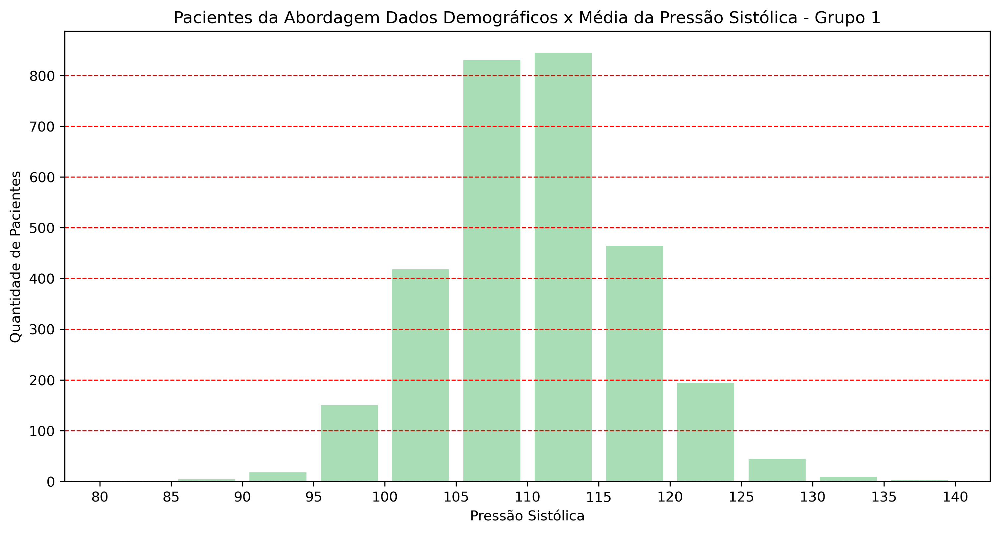

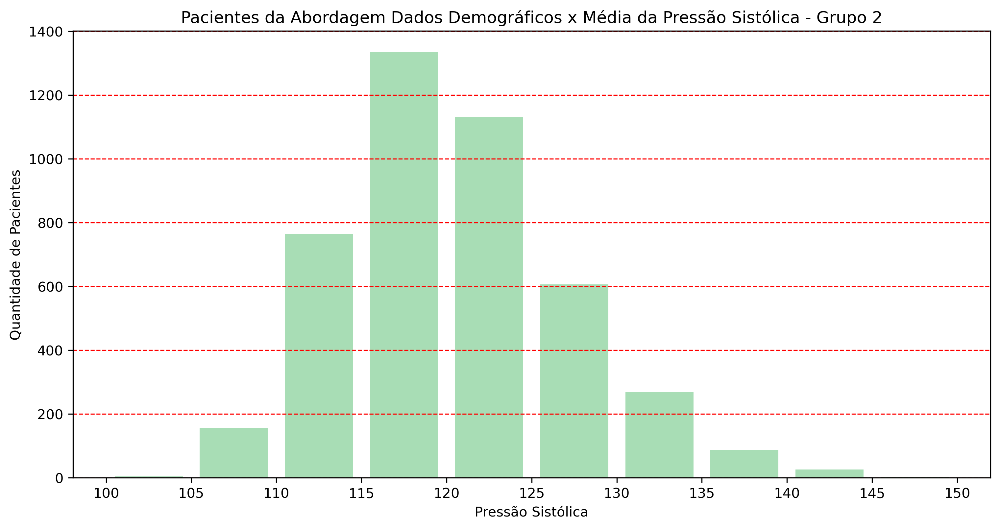

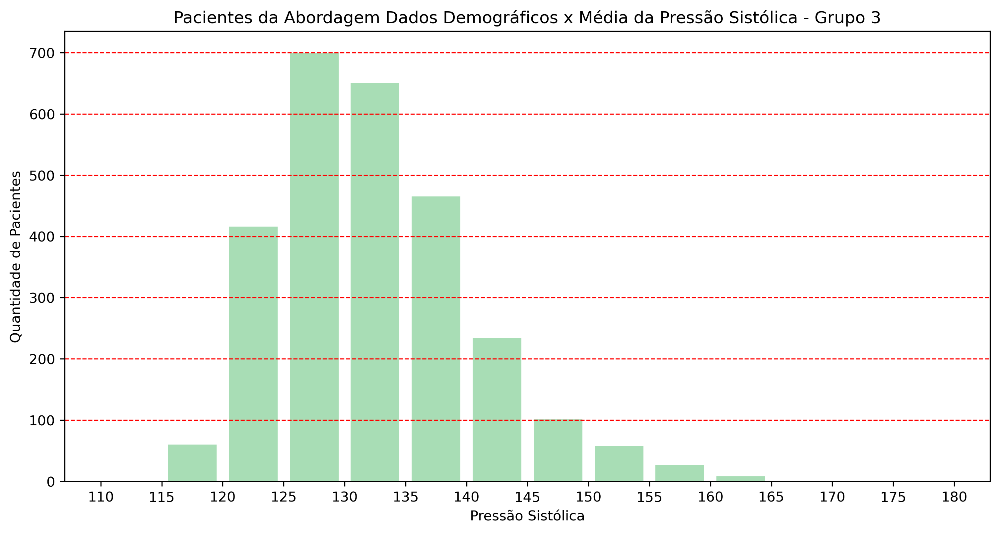

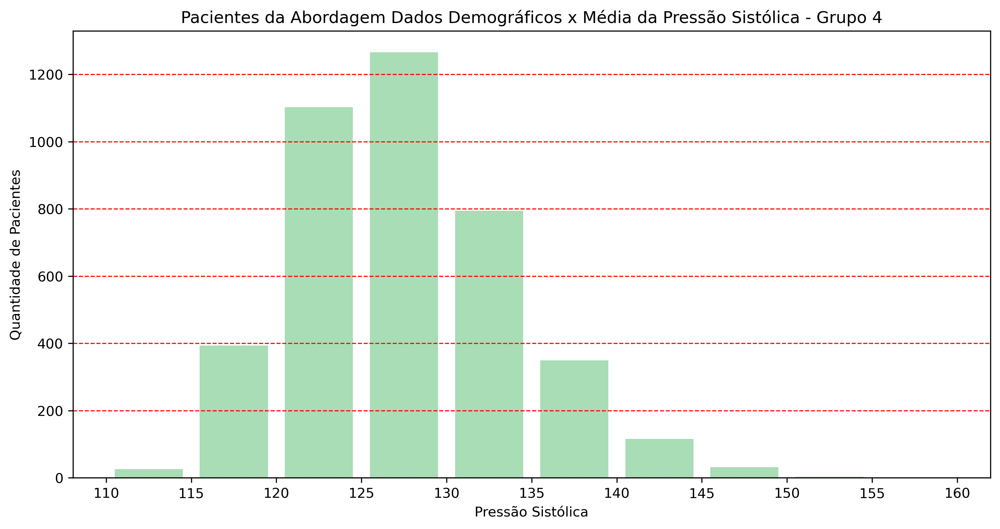

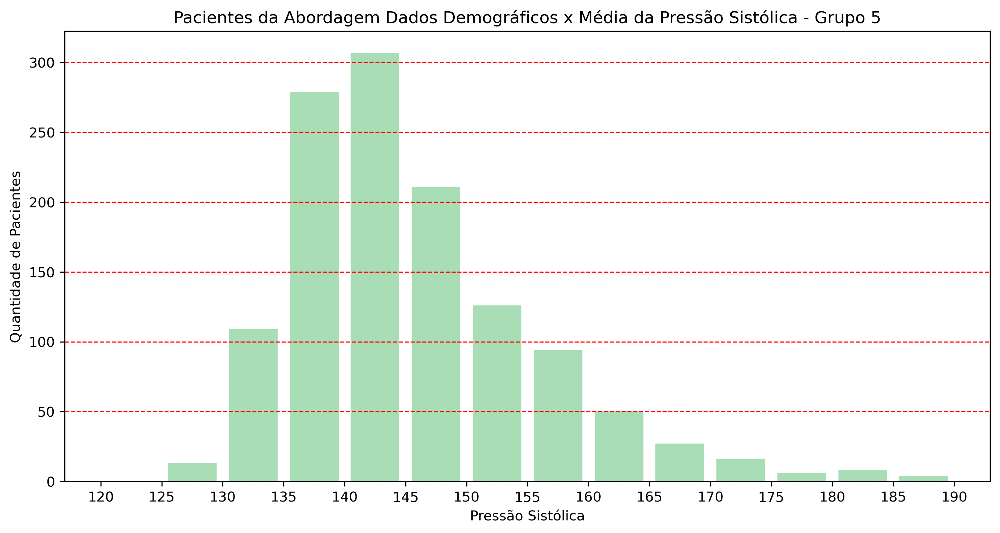

...

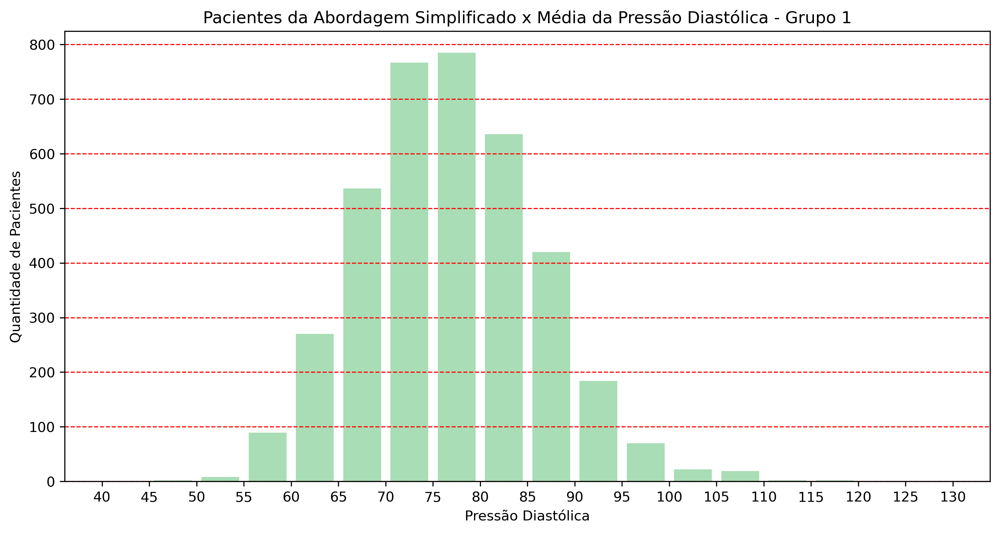

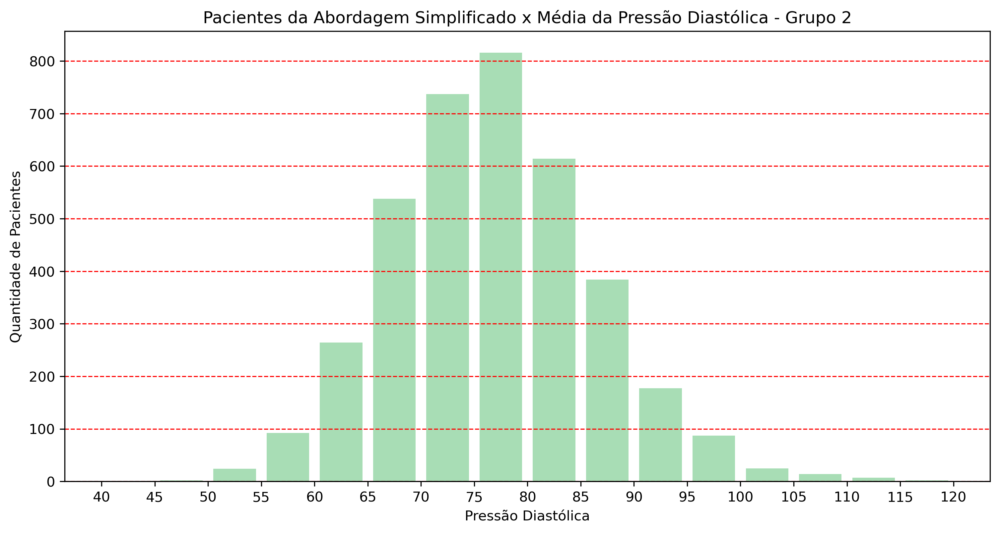

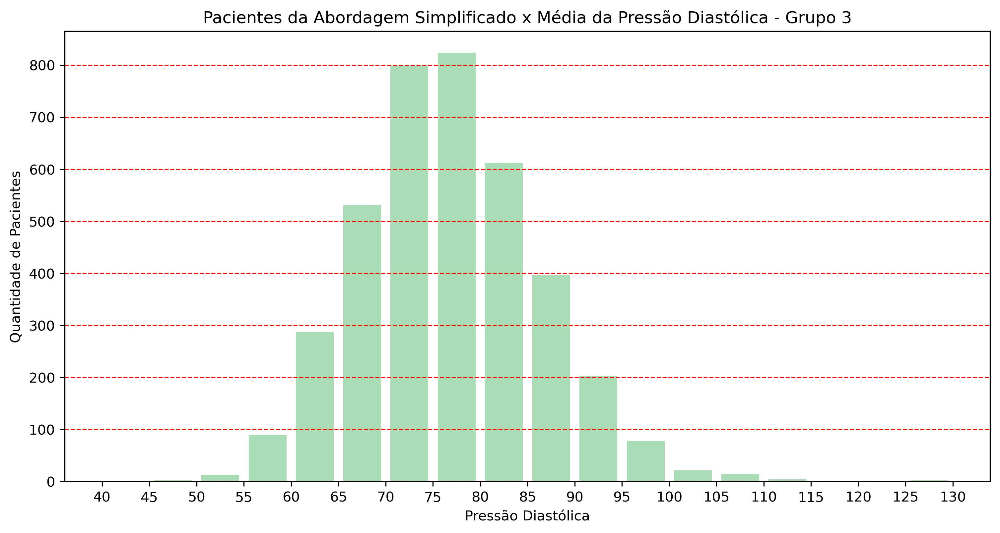

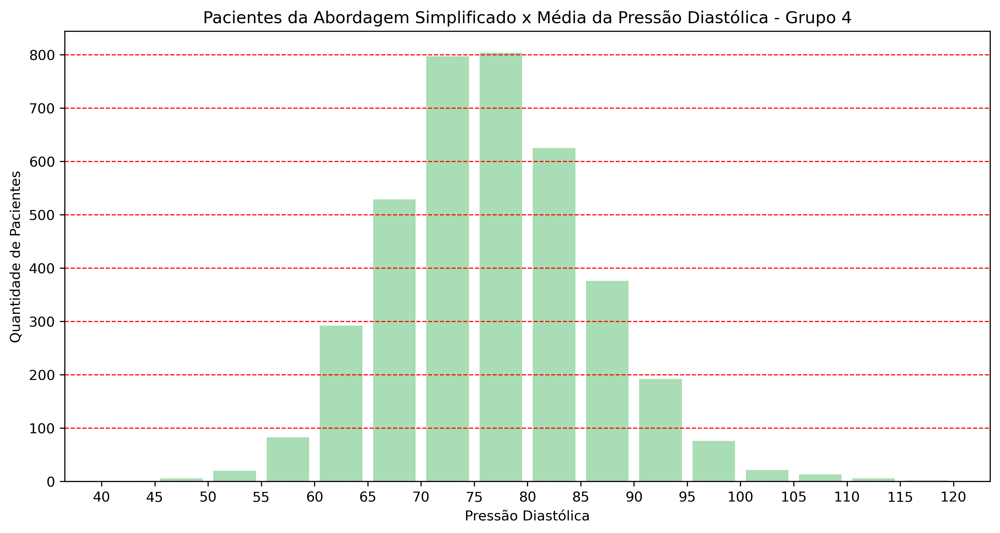

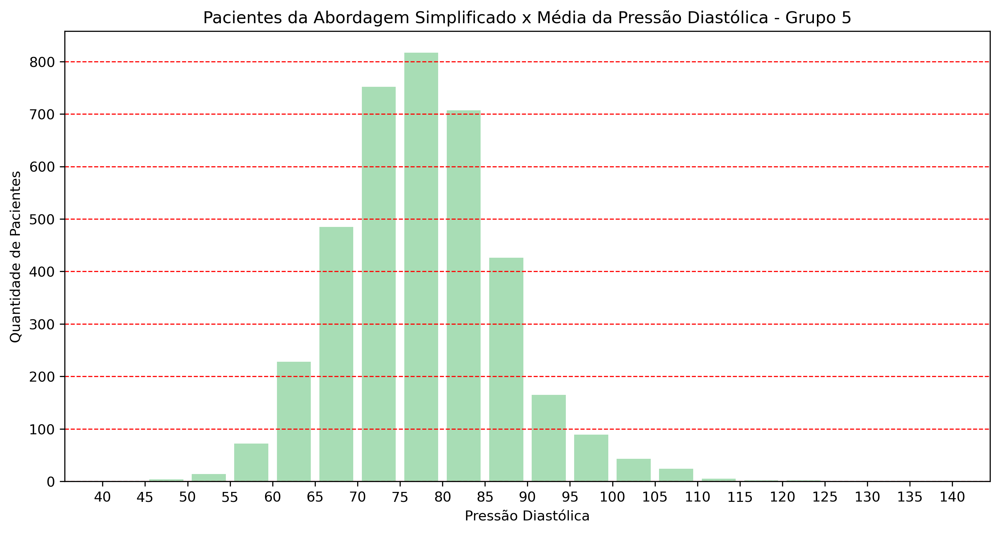

Wall time: 1min 19s


In [58]:
ls_abordagens = [abordagem_cadastro, abordagem_medidas, abordagem_medidas_masc, abordagem_medidas_fem,
                 abordagem_categorias, abordagem_estatistica, abordagem_doenca, abordagem_escolho_doenca, abordagem_simplificado]

ls_nomes = ['Dados Demográficos','Medidas','Medidas Masc','Medidas Fem','Categorias', 'Estatística', 'Doença', 'Escolho Doença','Simplificado']

%time histograma_abordagens(ls_abordagens, ls_nomes)

In [59]:
#time_labels = ['9:00','9:15','9:30','9:45','10:00','10:15','10:30','10:45','11:00','11:15','11:30','11:45','12:00','12:15',
#               '12:30','12:45', '13:00','13:15', '13:30', '13:45', '14:00', '14:15', '14:30', '14:45', '15:00', '15:15', 
#               '15:30', '15:45', '16:00', '16:15', '16:30', '16:45', '17:00', '17:15', '17:30', '17:45', '18:00', '18:15',
#               '18:30', '18:45', '19:00', '19:15', '19:30', '19:45', '20:00', '20:15', '20:30', '20:45', '21:00', '21:15',
#               '21:30', '21:45', '22:00', '22:15', '22:30', '22:45', '23:00', '23:30', '0:00', '0:30', '1:00', '1:30',
#               '2:00', '2:30', '3:00', '3:30', '4:00', '4:30', '5:00', '5:30', '6:00', '6:15', '6:30', '6:45', '7:00',
#               '7:15', '7:30', '7:45', '8:00', '8:15', '8:30', '8:45']

In [60]:
def grafico_barras_empilhadas(df1,abordagem,demogra, duas_cores = False):
          #.reindex(df.set_index('Cluster').sum().sort_values().index, axis=1)\
    df = df1.copy()
    if  duas_cores:
        cores = [sns.color_palette("GnBu", 10)[3],sns.color_palette("GnBu", 10)[9]]
    else:
        cores = sns.color_palette("GnBu", 10)[2:]
        
    df_new = df.set_index('Cluster')\
      .reindex(df.set_index('Cluster').sum().index, axis=1).T
    df_new.plot(kind='bar', stacked=True,
              colormap=ListedColormap(cores), 
              figsize=(12,6))

    for n in df_new: 
        for i, (cs, ab, pc) in enumerate(zip(df_new.iloc[:, :].cumsum(1)[n],  
                                             df_new[n], df_new[n])): 
            plt.text(i,cs - ab / 4, str(np.round(pc, 1)) + '%',  
                     va = 'center', ha = 'center',color='w',fontsize=14)
    
    plt.legend(loc=(1.04,0.7), fontsize=14)
    plt.xticks(fontsize=18)
    plt.yticks(fontsize=18)
    plt.axhline(50, color="gray",linewidth=2.0, linestyle="dotted")
    plt.title(f"Percentual nos Clusters da Abordagem {abordagem} - Atributo {demogra}",fontsize=16)
    plt.ylabel("Percentual", fontsize=18)
    plt.savefig(DIR_ABORDAGENS / "graficos_analise" / f'grafico_empilhado_{abordagem.lower().replace(" ","_")}_{demogra.lower()}.png',
               bbox_inches="tight", pad_inches=1)
    plt.show()

In [61]:
sns.color_palette("GnBu", 10)

[(0.9035447904652056, 0.9627681660899654, 0.881753171856978),
 (0.8436755094194541, 0.939038831218762, 0.8205920799692425),
 (0.7767474048442907, 0.9125259515570934, 0.7622145328719724),
 (0.6704498269896194, 0.8711880046136101, 0.7149711649365629),
 (0.5460207612456748, 0.8240522875816993, 0.7474048442906575),
 (0.41868512110726647, 0.7646289888504422, 0.7898500576701268),
 (0.29457900807381776, 0.6893656286043829, 0.8206689734717416),
 (0.19123414071510958, 0.5742099192618224, 0.7586620530565167),
 (0.09219530949634756, 0.47040369088811995, 0.7057900807381776),
 (0.03137254901960784, 0.36416762783544787, 0.6275586312956556)]

In [62]:
sns.choose_colorbrewer_palette("diverging");

interactive(children=(Dropdown(description='name', options=('RdBu', 'RdGy', 'PRGn', 'PiYG', 'BrBG', 'RdYlBu', …

In [63]:
sns.choose_cubehelix_palette();

interactive(children=(IntSlider(value=9, description='n_colors', max=16, min=2), FloatSlider(value=0.0, descri…

In [64]:
sns.choose_light_palette("husl");

interactive(children=(IntSlider(value=179, description='h', max=359), IntSlider(value=49, description='s', max…

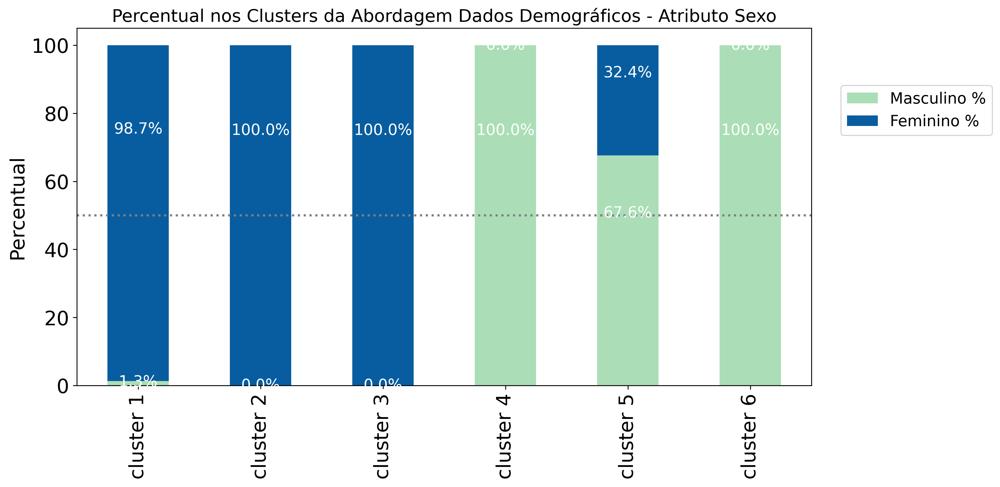

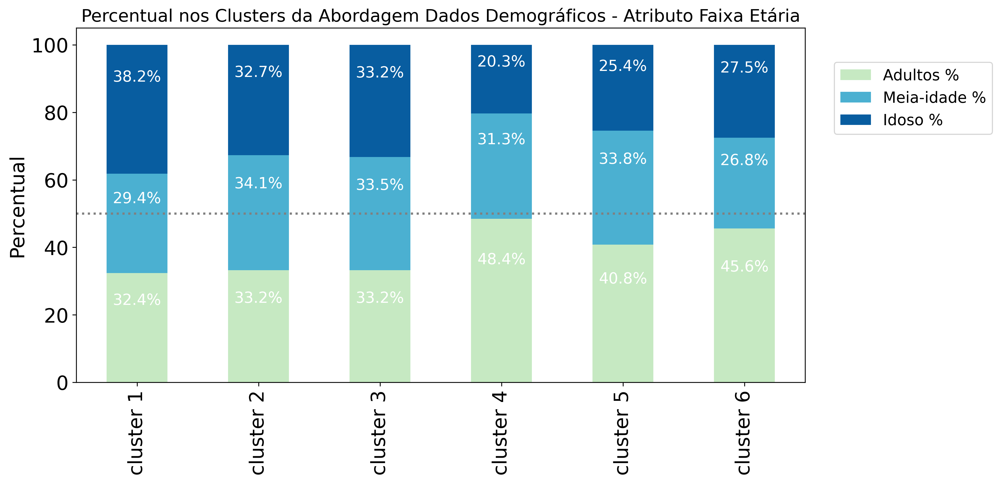

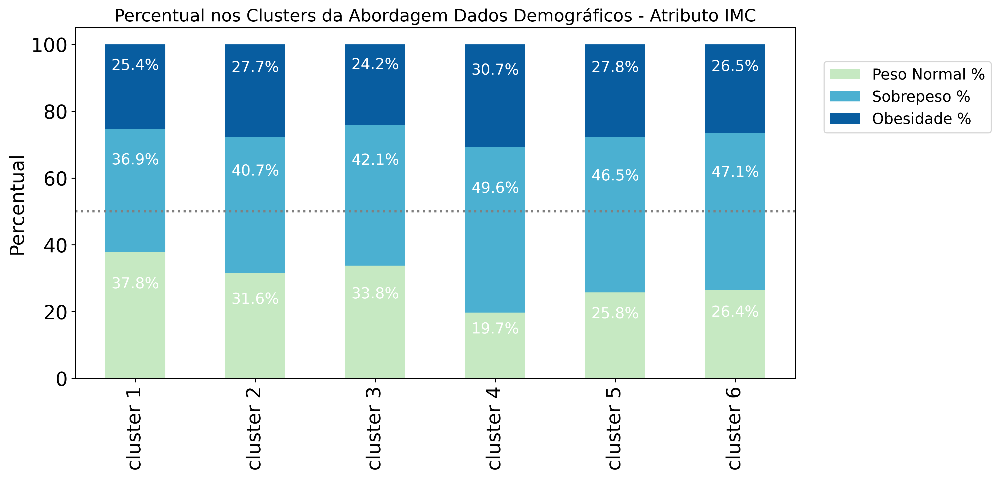

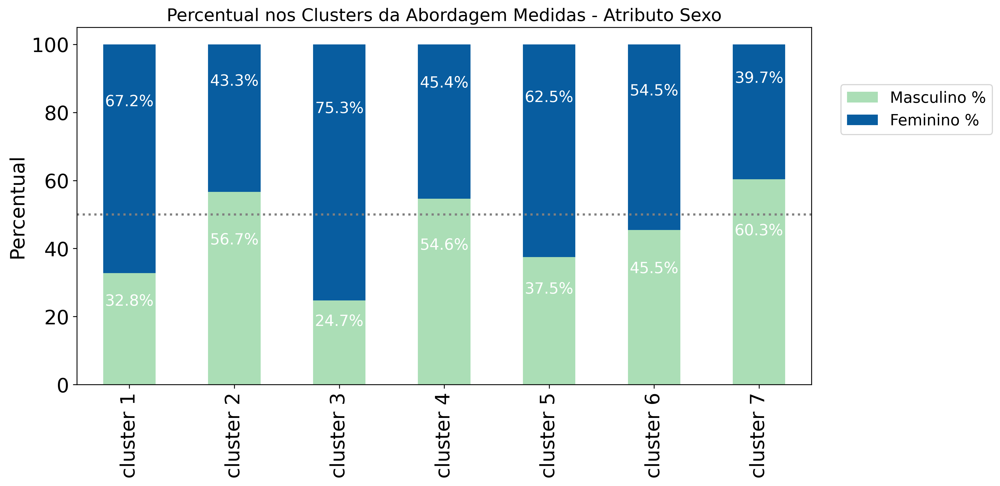

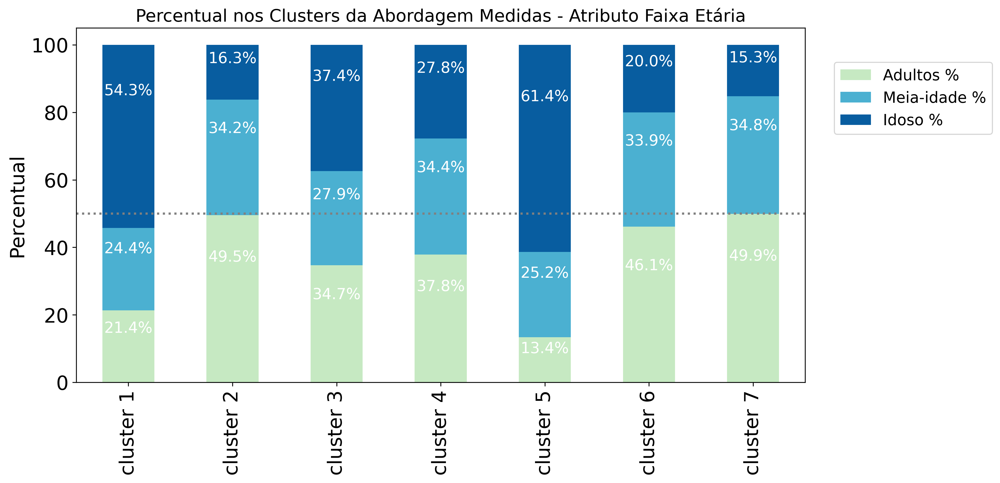

...

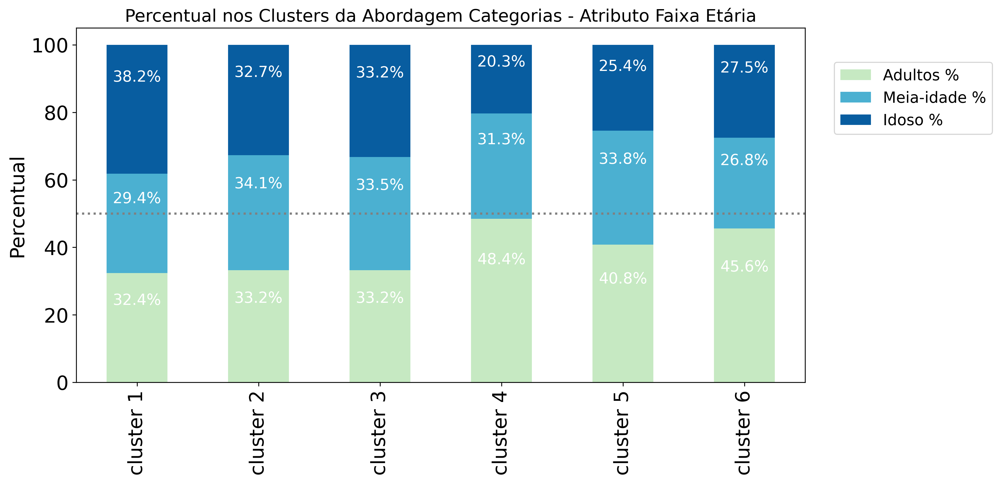

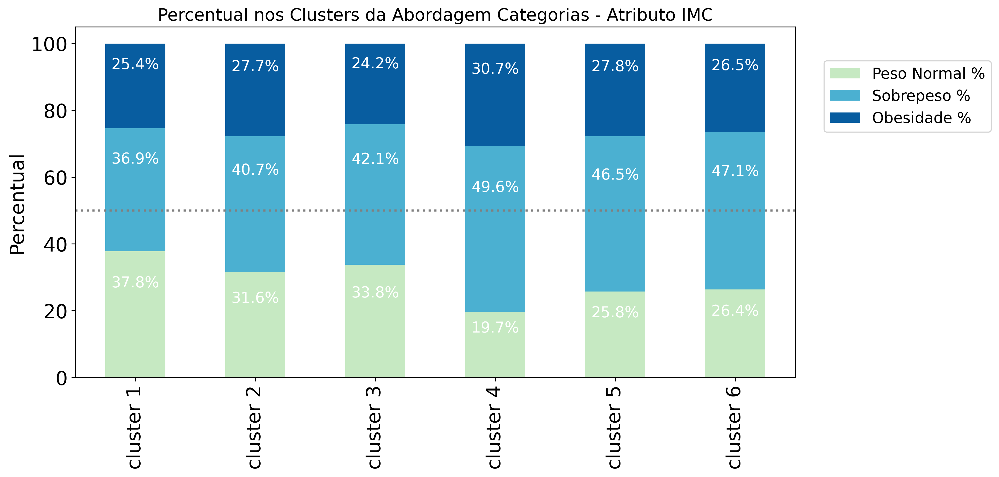

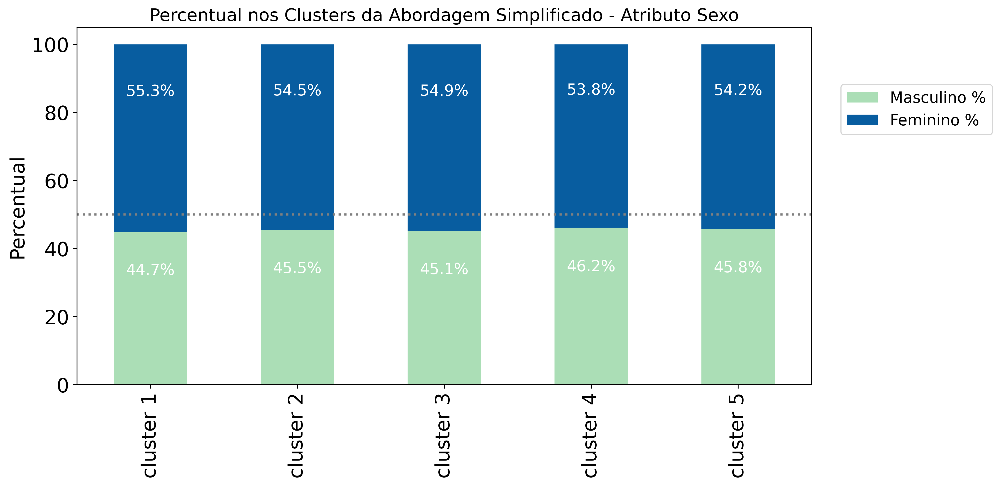

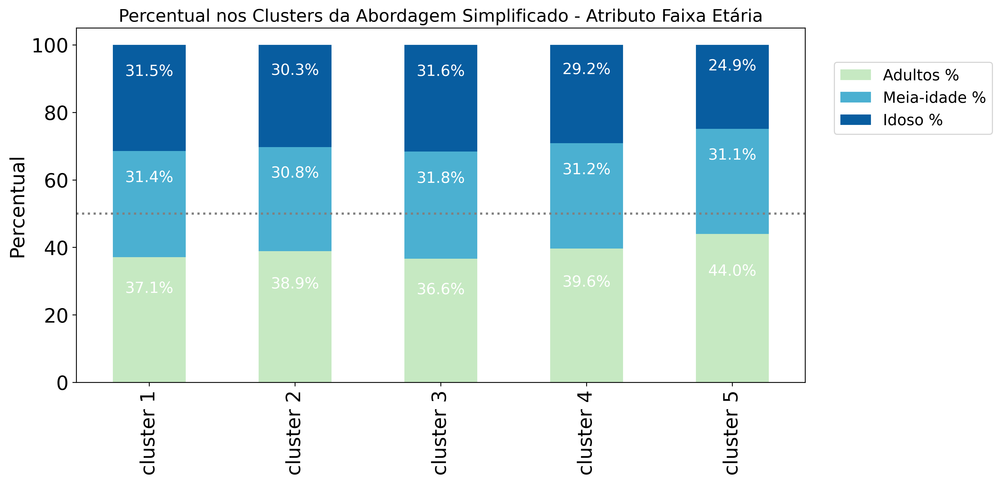

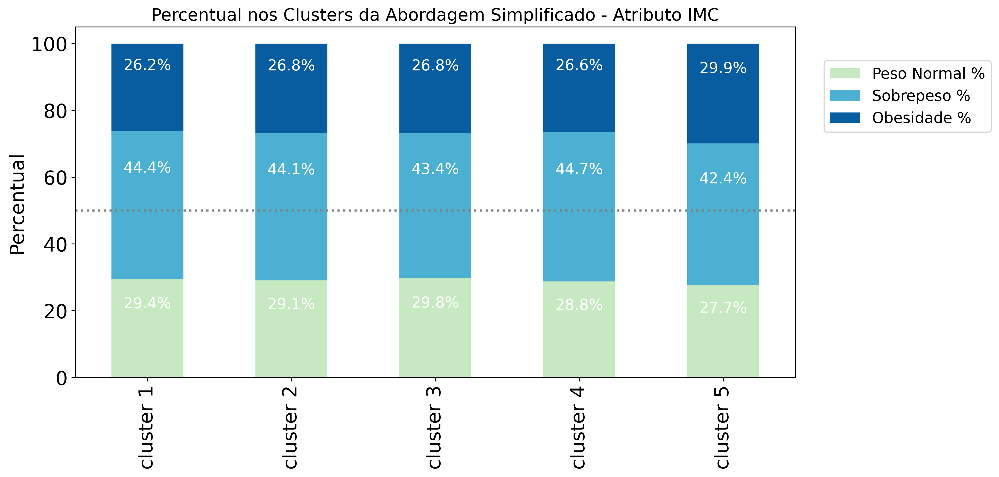

In [65]:
ls_barras_empilhadas = [qtd_dados_cadastrais,qtd_dados_medidas,qtd_dados_medidas_masc,qtd_dados_medidas_fem, qtd_categoria,qtd_dados_simplificado]
ls_nomes_barras = ['Dados Demográficos','Medidas','Medidas Masc','Medidas Fem','Categorias', 'Simplificado']
for i in range(len(ls_barras_empilhadas)):
    grafico_genero = ls_barras_empilhadas[i].set_index('Cluster').loc[['Masculino %','Feminino %'],:].reset_index().rename_axis('',axis=1)
    grafico_idade = ls_barras_empilhadas[i].set_index('Cluster').loc[['Adultos %','Meia-idade %','Idoso %'],:].reset_index().rename_axis('',axis=1)
    grafico_imc = ls_barras_empilhadas[i].set_index('Cluster').loc[['Peso Normal %', 'Sobrepeso %', 'Obesidade %'],:].reset_index().rename_axis('',axis=1)
    #grafico_idade = ls_barras_empilhadas[i].set_index('Cluster').loc[['Jovens %','Adultos %','Meia-idade %','Idoso %', 'Ancião %', 'Velhice extrema %'],:].reset_index().rename_axis('',axis=1)
    #grafico_imc = ls_barras_empilhadas[i].set_index('Cluster').loc[['Abaixo do peso %', 'Peso Normal %', 'Sobrepeso %', 'Obesidade grau 1 %', 'Obesidade grau 2 %', 'Obesidade Grau 3 %'],:].reset_index().rename_axis('',axis=1)
    
    if ls_nomes[i] != 'Medidas Masc'and ls_nomes[i] !='Medidas Fem':
        grafico_barras_empilhadas(grafico_genero,ls_nomes_barras[i],'Sexo',True)
    grafico_barras_empilhadas(grafico_idade,ls_nomes_barras[i],'Faixa Etária')
    grafico_barras_empilhadas(grafico_imc,ls_nomes_barras[i],'IMC')


In [66]:
#   Junção de C1+C2+C3, C4+C5 e C6+C7
# 

ls_simplifica = [qtd_dados_cadastrais,qtd_dados_medidas,qtd_dados_medidas_masc,qtd_dados_medidas_fem, qtd_categoria]
ls_simplifica_nome = ['cadastro', 'medidas', 'medidas_masc', 'medidas_fem', 'categoria']

indice = 1

df_abordagem = ls_simplifica[indice]
abordagem = ls_simplifica_nome[indice]

cluster_123 = sum(df_abordagem.iloc[0,1:4]) #+ df_abordagem.iloc[1,1:] + df_abordagem.iloc[2,1:]
cluster_45 = sum(df_abordagem.iloc[0,4:6])# + df_abordagem.iloc[4,1:]
cluster_67 = sum(df_abordagem.iloc[0,6:])# + df_abordagem.iloc[6,1:]

df = pd.DataFrame()
df['Cluster'] = ['C1-C3','C4-C5','C6-C7']

df['QTD Pacientes'] = [cluster_123,cluster_45,cluster_67]
df['QTD Pacientes %'] = np.round(df['QTD Pacientes'] / np.sum(df['QTD Pacientes']) * 100,2)

df['Masculino'] = [sum(df_abordagem.iloc[2,1:4]),sum(df_abordagem.iloc[2,4:6]),sum(df_abordagem.iloc[2,6:])]
df['Masculino %'] = np.round(df['Masculino'] / np.sum(df['QTD Pacientes']) * 100,2)

df['Feminino'] = [sum(df_abordagem.iloc[4,1:4]),sum(df_abordagem.iloc[4,4:6]),sum(df_abordagem.iloc[4,6:])]
df['Feminino %'] = np.round(df['Feminino'] / np.sum(df['QTD Pacientes']) * 100,2)

df['Adultos'] = [sum(df_abordagem.iloc[6,1:4]),sum(df_abordagem.iloc[6,4:6]),sum(df_abordagem.iloc[6,6:])]
df['Adultos %'] = np.round(df['Adultos'] / np.sum(df['QTD Pacientes']) * 100,2)

df['Meia-idade'] = [sum(df_abordagem.iloc[8,1:4]),sum(df_abordagem.iloc[8,4:6]),sum(df_abordagem.iloc[8,6:])]
df['Meia-idade %'] = np.round(df['Meia-idade'] / np.sum(df['QTD Pacientes']) * 100,2)

df['Idoso'] = [sum(df_abordagem.iloc[10,1:4]),sum(df_abordagem.iloc[10,4:6]),sum(df_abordagem.iloc[10,6:])]
df['Idoso %'] = np.round(df['Idoso'] / np.sum(df['QTD Pacientes']) * 100,2)

df['Peso Normal'] = [sum(df_abordagem.iloc[12,1:4]),sum(df_abordagem.iloc[12,4:6]),sum(df_abordagem.iloc[12,6:])]
df['Peso Normal %'] = np.round(df['Peso Normal'] / np.sum(df['QTD Pacientes']) * 100,2)

df['Sobrepeso'] = [sum(df_abordagem.iloc[14,1:4]),sum(df_abordagem.iloc[14,4:6]),sum(df_abordagem.iloc[14,6:])]
df['Sobrepeso %'] = np.round(df['Sobrepeso'] / np.sum(df['QTD Pacientes']) * 100,2)

df['Obesidade'] = [sum(df_abordagem.iloc[16,1:4]),sum(df_abordagem.iloc[16,4:6]),sum(df_abordagem.iloc[16,6:])]
df['Obesidade %'] = np.round(df['Obesidade'] / np.sum(df['QTD Pacientes']) * 100,2)

df = df.T
df.columns = df.iloc[0,:]
df = df.iloc[1:,:]

df.to_excel(DIR_ABORDAGENS / "simplifica" / f"{algoritmo.upper()}_simplifica_clusters_approach_{abordagem}.xlsx", index = False)

##  Abordagem 2: Medidas
## Gera arquivo único de todos os pacientes com dados completos e seus clusters 

In [67]:
df_medidas_completo = pd.read_csv(DIRETORIO_PRINCIPAL / "KMeansRandom" / "KMEANS_approach_medidas_todos_pacientes.csv",
                                  sep=';', encoding='latin1')

In [68]:
df_medidas_completo

,numero_identificacao,data_nascimento,genero,idade,peso,altura,IMC,data_exame,grupo,sist 9:00,...,Mediana Diastolica em 24h,AUC Sistolica em 24h,AUC Diastolica em 24h,AUC PP Daytime,AUC PP Nighttime,DP Sistolica em 24h,DP Diastolica em 24h,Picos Sistolica,Picos Diastolica,Diferença % Dipping
0,4,1923-10-05,1,94.0,85.0,160,33.2,2018-09-10 12:25:23,3,105.0,...,61.0,9545.5,4902.0,3748.0,841.5,16.58,10.99,15,39,0.966
1,5,1948-10-07,1,70.0,80.0,165,29.4,2018-12-26 07:39:41,3,103.0,...,62.0,8586.5,5034.5,2915.0,606.0,7.38,6.89,9,23,0.969
2,6,1999-03-23,1,19.0,100.0,197,25.8,2018-12-26 08:06:19,5,147.0,...,80.0,10674.0,6154.0,3721.0,751.5,12.48,13.02,19,20,1.056
3,7,1978-01-26,0,40.0,65.0,"1,64",24.2,2018-12-26 08:19:06,5,140.0,...,80.5,10679.5,6420.5,3642.0,602.5,16.14,10.58,23,11,1.107
4,8,1990-03-07,1,28.0,120.0,172,40.6,2018-12-26 08:26:59,6,113.0,...,77.0,9141.5,6118.0,2405.0,566.0,11.88,12.65,14,15,1.137
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19145,21786,1972-11-25,1,47.0,75.0,165,27.5,2020-09-10 16:03:08,4,163.0,...,118.0,12224.5,9265.0,2439.0,474.5,17.26,13.89,64,75,1.134
19146,21787,1970-10-19,1,49.0,90.0,183,26.9,2020-09-10 16:21:02,7,114.0,...,83.0,10970.0,6819.0,3319.0,738.0,16.85,13.18,32,27,1.046
19147,21788,1985-03-15,0,35.0,93.0,167,33.3,2020-09-10 16:44:53,3,107.0,...,62.5,9245.0,4935.5,3556.0,713.5,13.56,8.00,15,28,1.029
19148,21792,1952-04-21,0,68.0,64.0,160,25.0,2020-09-10 17:25:50,6,94.0,...,69.5,8989.5,5660.0,2815.5,460.0,13.69,10.59,19,15,1.252


## Aplica valor binário em cada paciente relacionando seu grupo

In [69]:
# em cada linha (paciente) aplica 1 na coluna correspondente ao grupo o qual pertence
# para dar entrada no SPSS
#
def nova_abordagem(df):
    saida = df.loc[:,['numero_identificacao','genero','idade','IMC']]
    #saida['genero'] = saida['genero'].apply(genero_0_1)
    for i in range(len(set(df['grupo']))):
        ls_grupo = []
        for paciente in df['grupo']:
            if paciente == i + 1:
                ls_grupo.append(1)
            else:
                ls_grupo.append(0)
        saida[f'C{i+1}'] = ls_grupo
    return saida
    

In [70]:
df_saida = nova_abordagem(df_medidas_completo)

In [71]:
df_saida

,numero_identificacao,genero,idade,IMC,C1,C2,C3,C4,C5,C6,C7
0,4,1,94.0,33.2,0,0,1,0,0,0,0
1,5,1,70.0,29.4,0,0,1,0,0,0,0
2,6,1,19.0,25.8,0,0,0,0,1,0,0
3,7,0,40.0,24.2,0,0,0,0,1,0,0
4,8,1,28.0,40.6,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...
19145,21786,1,47.0,27.5,0,0,0,1,0,0,0
19146,21787,1,49.0,26.9,0,0,0,0,0,0,1
19147,21788,0,35.0,33.3,0,0,1,0,0,0,0
19148,21792,0,68.0,25.0,0,0,0,0,0,1,0


In [72]:
df_saida.to_csv(path_or_buf = DIR_ABORDAGENS / "correlacao_medidas_SPSS" / 'todos_pacientes_clusters.csv', 
             sep=';',index=False,encoding='UTF-8')

df_saida

,numero_identificacao,genero,idade,IMC,C1,C2,C3,C4,C5,C6,C7
0,4,1,94.0,33.2,0,0,1,0,0,0,0
1,5,1,70.0,29.4,0,0,1,0,0,0,0
2,6,1,19.0,25.8,0,0,0,0,1,0,0
3,7,0,40.0,24.2,0,0,0,0,1,0,0
4,8,1,28.0,40.6,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...
19145,21786,1,47.0,27.5,0,0,0,1,0,0,0
19146,21787,1,49.0,26.9,0,0,0,0,0,0,1
19147,21788,0,35.0,33.3,0,0,1,0,0,0,0
19148,21792,0,68.0,25.0,0,0,0,0,0,1,0


In [73]:
df_medidas_completo

,numero_identificacao,data_nascimento,genero,idade,peso,altura,IMC,data_exame,grupo,sist 9:00,...,Mediana Diastolica em 24h,AUC Sistolica em 24h,AUC Diastolica em 24h,AUC PP Daytime,AUC PP Nighttime,DP Sistolica em 24h,DP Diastolica em 24h,Picos Sistolica,Picos Diastolica,Diferença % Dipping
0,4,1923-10-05,1,94.0,85.0,160,33.2,2018-09-10 12:25:23,3,105.0,...,61.0,9545.5,4902.0,3748.0,841.5,16.58,10.99,15,39,0.966
1,5,1948-10-07,1,70.0,80.0,165,29.4,2018-12-26 07:39:41,3,103.0,...,62.0,8586.5,5034.5,2915.0,606.0,7.38,6.89,9,23,0.969
2,6,1999-03-23,1,19.0,100.0,197,25.8,2018-12-26 08:06:19,5,147.0,...,80.0,10674.0,6154.0,3721.0,751.5,12.48,13.02,19,20,1.056
3,7,1978-01-26,0,40.0,65.0,"1,64",24.2,2018-12-26 08:19:06,5,140.0,...,80.5,10679.5,6420.5,3642.0,602.5,16.14,10.58,23,11,1.107
4,8,1990-03-07,1,28.0,120.0,172,40.6,2018-12-26 08:26:59,6,113.0,...,77.0,9141.5,6118.0,2405.0,566.0,11.88,12.65,14,15,1.137
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19145,21786,1972-11-25,1,47.0,75.0,165,27.5,2020-09-10 16:03:08,4,163.0,...,118.0,12224.5,9265.0,2439.0,474.5,17.26,13.89,64,75,1.134
19146,21787,1970-10-19,1,49.0,90.0,183,26.9,2020-09-10 16:21:02,7,114.0,...,83.0,10970.0,6819.0,3319.0,738.0,16.85,13.18,32,27,1.046
19147,21788,1985-03-15,0,35.0,93.0,167,33.3,2020-09-10 16:44:53,3,107.0,...,62.5,9245.0,4935.5,3556.0,713.5,13.56,8.00,15,28,1.029
19148,21792,1952-04-21,0,68.0,64.0,160,25.0,2020-09-10 17:25:50,6,94.0,...,69.5,8989.5,5660.0,2815.5,460.0,13.69,10.59,19,15,1.252


## Aplica valor binário  simplifica para 2 classes as covariáveis 

In [74]:
# Para entregar ao SPSS foi aplicado valores binário 0 e 1 nas colunas do grupo aos quais cada paciente pertence e
# também foi simplificado para apenas 2 classes as covariáveis
#

def faixas_imc(imc):
    classes = ["Peso Normal","Obesidade"]
    intervalos = [(0, 30),(30, 1000)]
    #classes = ["Peso Normal","Sobrepeso", "Obesidade"]
    #intervalos = [(0, 25),(25, 30),(30, 1000)]
    #classes = ["baixo peso","normal","sobrepeso","obesidade grau I","obesidade grau II","obesidade Grau III"]
    #intervalos = [(0, 18),(18, 25),(25, 30),(30, 35),(35, 40),(40, 1000)]
    
    for faixa in range(len(classes)):
        if imc < intervalos[faixa][1]:
            return classes[faixa]
        
def faixas_imc_classe(imc):
    classes = [1, 2]
    intervalos = [(0, 30),(30, 1000)]
    #classes = [1, 2, 3]
    #intervalos = [(0, 25),(25, 30),(30, 1000)]
    #classes = [1, 2, 3, 4, 5, 6]
    #intervalos = [(0, 18),(18, 25),(25, 30),(30, 35),(35, 40),(40, 1000)]
    
    for faixa in range(len(classes)):
        if imc < intervalos[faixa][1]:
            return classes[faixa]
    
def faixas_etarias(idade):
    classes = ["Adultos","Idoso"]
    intervalos = [(0, 65),(65, 200)]
    #classes = ["Adultos","Meia-idade","Idoso"]
    #intervalos = [(0, 50),(50, 65),(65, 200)]
    #classes = ["Jovens","Adultos","Meia-idade","Idoso", "Ancião","Velhice extrema"]
    #intervalos = [(0, 20),(20, 45),(45, 60),(60, 75),(75, 90),(90, 200)]
    
    for faixa in range(len(classes)):
        if idade <= intervalos[faixa][1]:
            return classes[faixa]

def faixas_etarias_classe(idade):
    classes = [1, 2]
    intervalos = [(0, 65),(65, 200)]
    #classes = [1, 2, 3]
    #intervalos = [(0, 50),(50, 65),(65, 200)]
    #classes = [1, 2, 3, 4, 5, 6]
    #intervalos = [(0, 20),(20, 45),(45, 60),(60, 75),(75, 90),(90, 200)]
    
    for faixa in range(len(classes)):
        if idade <= intervalos[faixa][1]:
            return classes[faixa]

def genero_binario(genero):
    if genero == 'F':
        return 0
    else:
        return 1

def verifica_grupo(coluna,grupo):
    saida = list()
    
    for linha in coluna:
        if linha == grupo:
            saida.append(1)
        else:
            saida.append(0)
    return saida

genero_1_0 = {'genero':{'F':0,'M':1}}

def modifica_df(df,abordagem):
    df = df.loc[:,:'diast 8:45']
    grupos  = set(df['grupo'])
    for grupo in grupos:
        df[f'cluster{grupo}'] = verifica_grupo(df['grupo'],grupo)
    df = df.replace(genero_1_0)
    df['IMC'] = df['IMC'].apply(faixas_imc_classe)
    df['idade'] = df['idade'].apply(faixas_etarias_classe)
    df = df.drop(['data_nascimento','peso','altura','grupo','data_exame'],axis=1)
    
    df.to_csv(DIR_ABORDAGENS / "todos_pacientes" / f'todos_pacientes_{abordagem}.csv', 
                           sep=";", encoding="latin1", index=False)
    return df

def modifica_df_cluster(df,abordagem):
    df = df.loc[:,:'diast 8:45']
    #grupos  = set(df['grupo'])
    #for grupo in grupos:
    #    df[f'cluster{grupo}'] = verifica_grupo(df['grupo'],grupo)
    df['Cluster'] = df['grupo']
    df = df.replace(genero_1_0)
    df['IMC'] = df['IMC'].apply(faixas_imc_classe)
    df['idade'] = df['idade'].apply(faixas_etarias_classe)
    df = df.drop(['data_nascimento','peso','altura','grupo','data_exame'],axis=1)
    
    df.to_csv(DIR_ABORDAGENS / "todos_pacientes" / f'todos_pacientes_cluster_{abordagem}.csv', 
                           sep=";", encoding="latin1", index=False)
    return df


def nova_abordagem_simplificado(df):
    saida = df.loc[:,['numero_identificacao','genero','idade','IMC']]
    saida['idade'] = saida['idade'].apply(faixas_etarias_classe)
    saida['IMC'] = saida['IMC'].apply(faixas_imc_classe)
    saida['genero'] = saida['genero'].apply(genero_binario)
    for i in range(len(set(df['grupo']))):
        ls_grupo = []
        for paciente in df['grupo']:
            if paciente == i + 1:
                ls_grupo.append(1)
            else:
                ls_grupo.append(0)
        saida[f'C{i+1}'] = ls_grupo
    return saida

In [75]:
df_saida_categoria = nova_abordagem_simplificado(df_medidas_completo)
df_saida_categoria

,numero_identificacao,genero,idade,IMC,C1,C2,C3,C4,C5,C6,C7
0,4,1,2,2,0,0,1,0,0,0,0
1,5,1,2,1,0,0,1,0,0,0,0
2,6,1,1,1,0,0,0,0,1,0,0
3,7,1,1,1,0,0,0,0,1,0,0
4,8,1,1,2,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...
19145,21786,1,1,1,0,0,0,1,0,0,0
19146,21787,1,1,1,0,0,0,0,0,0,1
19147,21788,1,1,2,0,0,1,0,0,0,0
19148,21792,1,2,1,0,0,0,0,0,1,0


In [76]:
df_saida_categoria.to_csv(path_or_buf = DIR_ABORDAGENS / "correlacao_medidas_SPSS" / 'todos_pacientes_cat_simplifica_clusters.csv', 
             sep=';',index=False,encoding='UTF-8')
df_saida_categoria

,numero_identificacao,genero,idade,IMC,C1,C2,C3,C4,C5,C6,C7
0,4,1,2,2,0,0,1,0,0,0,0
1,5,1,2,1,0,0,1,0,0,0,0
2,6,1,1,1,0,0,0,0,1,0,0
3,7,1,1,1,0,0,0,0,1,0,0
4,8,1,1,2,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...
19145,21786,1,1,1,0,0,0,1,0,0,0
19146,21787,1,1,1,0,0,0,0,0,0,1
19147,21788,1,1,2,0,0,1,0,0,0,0
19148,21792,1,2,1,0,0,0,0,0,1,0


## Análise para comparar entre os Clusters a covariável Obesidade 

In [77]:
#  Verifica categoria binária de NÃO obeso  = 0 e
#                                    obeso = 1
#
def obesidade_0_1(IMC):
    if IMC < 30:
        return 0
    else:
        return 1

In [78]:
df_medidas_obeso = df_medidas_completo.loc[:,:'IMC']
df_medidas_obeso['obeso'] = df_medidas_completo['IMC'].apply(obesidade_0_1)
df_medidas_obeso = pd.concat([df_medidas_obeso,df_medidas_completo.loc[:,'grupo':]],axis=1)
df_medidas_obeso

,numero_identificacao,data_nascimento,genero,idade,peso,altura,IMC,obeso,grupo,sist 9:00,...,Mediana Diastolica em 24h,AUC Sistolica em 24h,AUC Diastolica em 24h,AUC PP Daytime,AUC PP Nighttime,DP Sistolica em 24h,DP Diastolica em 24h,Picos Sistolica,Picos Diastolica,Diferença % Dipping
0,4,1923-10-05,1,94.0,85.0,160,33.2,1,3,105.0,...,61.0,9545.5,4902.0,3748.0,841.5,16.58,10.99,15,39,0.966
1,5,1948-10-07,1,70.0,80.0,165,29.4,0,3,103.0,...,62.0,8586.5,5034.5,2915.0,606.0,7.38,6.89,9,23,0.969
2,6,1999-03-23,1,19.0,100.0,197,25.8,0,5,147.0,...,80.0,10674.0,6154.0,3721.0,751.5,12.48,13.02,19,20,1.056
3,7,1978-01-26,0,40.0,65.0,"1,64",24.2,0,5,140.0,...,80.5,10679.5,6420.5,3642.0,602.5,16.14,10.58,23,11,1.107
4,8,1990-03-07,1,28.0,120.0,172,40.6,1,6,113.0,...,77.0,9141.5,6118.0,2405.0,566.0,11.88,12.65,14,15,1.137
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19145,21786,1972-11-25,1,47.0,75.0,165,27.5,0,4,163.0,...,118.0,12224.5,9265.0,2439.0,474.5,17.26,13.89,64,75,1.134
19146,21787,1970-10-19,1,49.0,90.0,183,26.9,0,7,114.0,...,83.0,10970.0,6819.0,3319.0,738.0,16.85,13.18,32,27,1.046
19147,21788,1985-03-15,0,35.0,93.0,167,33.3,1,3,107.0,...,62.5,9245.0,4935.5,3556.0,713.5,13.56,8.00,15,28,1.029
19148,21792,1952-04-21,0,68.0,64.0,160,25.0,0,6,94.0,...,69.5,8989.5,5660.0,2815.5,460.0,13.69,10.59,19,15,1.252


## Abordagem Simplificado com apenas 2 classes de covariáveis

In [79]:
# Quantidade da abordagem por simplificado com apenas 2 classes de covariáveis para entregar ao SPSS
# Gênero, Idade e IMC reunidos em 2 categorias para simplificar a análise e o cálculo do p_value
#  Frequência de Obesos (IMC>=30) e Não Obesos (IMC<30) em cada cluster
#  
try:
    qtd_dados_simplificado2 = pd.DataFrame()

    qtd_dados_simplificado2['Cluster'] = [f'cluster {n}' for n in range(1,len(abordagem_simplificado) + 1)]
    qtd_dados_simplificado2['QTD Pacientes'] = [len(n) for n in abordagem_simplificado]
    total_pacientes = np.sum([len(n) for n in abordagem_simplificado])
    qtd_dados_simplificado2['QTD Pacientes %'] = [np.round(len(n)/total_pacientes*100,2) for n in abordagem_simplificado]
    lista_total_grupos = [len(i) for i in abordagem_simplificado]
    lista_total_grupos = np.array(lista_total_grupos)
    lista_faixa_genero = ['Masculino','Masculino %','Feminino','Feminino %']

    colunas_genero = [[],[],[],[],[],[]]
    for grupo in range(len(abordagem_simplificado)):
        resultado = faixa_genero(abordagem_simplificado[grupo])
        colunas_genero[0].append(resultado[0])
        colunas_genero[1].append(resultado[1])
        colunas_genero[2].append(resultado[2])
        colunas_genero[3].append(resultado[3])

    for faixa in range(len(lista_faixa_genero)):
        qtd_dados_simplificado2[lista_faixa_genero[faixa]] = colunas_genero[faixa]

    lista_faixa_idade = ["Adultos","Idoso"]
    #lista_faixa_idade = ["Jovens","Adultos","Meia-idade","Idoso", "Ancião","Velhice extrema"]


    for faixa in range(len(lista_faixa_idade)):
        lista_grupos = list()
        
        for grupo in range(len(abordagem_simplificado)):
            lista_grupos.append(len(abordagem_simplificado[grupo][abordagem_simplificado[grupo]['idade'].apply(faixas_etarias) == lista_faixa_idade[faixa]]))
        np.array(lista_grupos)
        qtd_dados_simplificado2[lista_faixa_idade[faixa]] = lista_grupos
        qtd_dados_simplificado2[f'{lista_faixa_idade[faixa]} %'] = np.round(lista_grupos / lista_total_grupos * 100, 2)


    lista_faixa_imc = ["Peso Normal","Obesidade"]
    #lista_faixa_imc = ["Abaixo do peso","Peso Normal","Sobrepeso","Obesidade grau 1","Obesidade grau 2","Obesidade Grau 3"]
    
#################################################################################################
    for faixa in range(len(lista_faixa_imc)):
        lista_grupos = list()
        
        for grupo in range(len(abordagem_simplificado)):
            lista_grupos.append(len(abordagem_simplificado[grupo][abordagem_simplificado[grupo]['IMC'].apply(faixas_imc) == lista_faixa_imc[faixa]]))
        np.array(lista_grupos)
        qtd_dados_simplificado2[lista_faixa_imc[faixa]] = lista_grupos
        qtd_dados_simplificado2[f'{lista_faixa_imc[faixa]} %'] = np.round(lista_grupos / lista_total_grupos * 100, 2)
    #print('1')
    #qtd_dados_simplificado2['Não obeso'] = qtd_dados_simplificado2['Peso Normal'] + qtd_dados_simplificado2['Sobrepeso']
    #qtd_dados_simplificado2['Não obeso %'] =  np.round(qtd_dados_simplificado2['Não obeso'] / lista_total_grupos * 100, 2)
    
    lista_calculo = ['Media Sistolica em 24h','Media Diastolica em 24h','Media Sistolica Daytime','Media Sistolica Nighttime',
                    'Media Diastolica Daytime','Media Diastolica Nighttime','Variancia Sistolica em 24h','Variancia Diastolica em 24h',
                    'Mediana Sistolica em 24h', 'Mediana Diastolica em 24h','AUC Sistolica em 24h','AUC Diastolica em 24h',
                     'DP Sistolica em 24h','DP Diastolica em 24h']

    funcao = [media_sistolica,media_diastolica,media_sistolica_dia,media_sistolica_noite,media_diastolica_dia,
               media_diastolica_noite,variancia_sistolica,variancia_diastolica,mediana_sistolica,mediana_diastolica,
              auc_sistolica,auc_diastolica,desvio_sistolica,desvio_diastolica]
    
    for analise in range(len(lista_calculo)):
        lista_analise = list()
        for grupo in range(len(abordagem_simplificado)):
            lista_analise.append(funcao[analise](abordagem_simplificado[grupo]))

        qtd_dados_simplificado2[lista_calculo[analise]] = lista_analise
   
    lista_descenso = []
    for grupo in range(len(abordagem_simplificado)):
        lista_descenso.append(descenso_noturno(abordagem_simplificado[grupo]))

    qtd_dados_simplificado2['Descenso Noturno %'] = lista_descenso
    qtd_dados_simplificado2_sem_T = qtd_dados_simplificado2
    qtd_dados_simplificado2 = qtd_dados_simplificado2.T.reset_index()
    qtd_dados_simplificado2.columns = qtd_dados_simplificado2.iloc[0,:]
    qtd_dados_simplificado2 = qtd_dados_simplificado2.iloc[1:,:]
    #  grava arquivo com qtd e % das doenças em cada grupo
    qtd_dados_simplificado2.to_csv(DIR_ABORDAGENS / "approach_simplificado2" /  f"{algoritmo.upper()}_qtd_approach_simplificado2.csv", 
                           sep=";", encoding="latin1", index=False)
    
except:
    pass

In [80]:
qtd_dados_simplificado2

,Cluster,cluster 1,cluster 2,cluster 3,cluster 4,cluster 5
1,QTD Pacientes,3813,3783,3876,3842,3836
2,QTD Pacientes %,19.91,19.75,20.24,20.06,20.03
3,Masculino,1706,1720,1748,1774,1756
4,Masculino %,44.74,45.47,45.1,46.17,45.78
5,Feminino,2107,2063,2128,2068,2080
6,Feminino %,55.26,54.53,54.9,53.83,54.22
7,Adultos,2612,2636,2651,2721,2880
8,Adultos %,68.5,69.68,68.4,70.82,75.08
9,Idoso,1201,1147,1225,1121,956
10,Idoso %,31.5,30.32,31.6,29.18,24.92


In [81]:
#qtd_dados_simplificado2_modificado = qtd_dados_simplificado2.loc[[1,3,5,7,9,11,13,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29],:]
#qtd_dados_simplificado2_modificado.index = np.arange(len(qtd_dados_simplificado2_modificado))
#percent = qtd_dados_simplificado2.loc[[2,4,6,8,10,12,14],:]
#percent.index = np.arange(len(percent))
#percent.columns = ['Cluster', 'C1 (%)', 'C2 (%)', 'C3 (%)', 'C4 (%)','C5 (%)']#, 'C6 (%)', 'C7 (%)']


qtd_dados_simplificado2_modificado = pd.concat([qtd_dados_simplificado2.loc[[x for x in range(1,14,2)],:],
                                               qtd_dados_simplificado2.loc[15:,:]],axis=0)
qtd_dados_simplificado2_modificado.index = np.arange(len(qtd_dados_simplificado2_modificado))


percent = qtd_dados_simplificado2.loc[[x for x in range(2,15,2)],:]
percent.index = np.arange(len(percent))
percent.columns = ['Cluster', 'C1 (%)', 'C2 (%)', 'C3 (%)', 'C4 (%)','C5 (%)']#, 'C6 (%)', 'C7 (%)']



aux = pd.concat([qtd_dados_simplificado2_modificado.loc[:,:'cluster 1'],percent.iloc[:,1]],axis=1)

for i in range(len(percent.columns)-2):
    aux = pd.concat([aux, qtd_dados_simplificado2_modificado.loc[:,f'cluster {i+2}'],
                                                    percent.iloc[:,i+2]],axis=1)
qtd_dados_simplificado2_modificado = aux
qtd_dados_simplificado2_modificado.to_csv(DIR_ABORDAGENS / "approach_simplificado" /  f"{algoritmo.upper()}_qtd_approach_simplificado_percent.csv", 
                           sep=";", encoding="latin1", index=False)
    

In [82]:
qtd_dados_simplificado2_modificado

,Cluster,cluster 1,C1 (%),cluster 2,C2 (%),cluster 3,C3 (%),cluster 4,C4 (%),cluster 5,C5 (%)
0,QTD Pacientes,3813,19.91,3783,19.75,3876,20.24,3842,20.06,3836,20.03
1,Masculino,1706,44.74,1720,45.47,1748,45.1,1774,46.17,1756,45.78
2,Feminino,2107,55.26,2063,54.53,2128,54.9,2068,53.83,2080,54.22
3,Adultos,2612,68.5,2636,69.68,2651,68.4,2721,70.82,2880,75.08
4,Idoso,1201,31.5,1147,30.32,1225,31.6,1121,29.18,956,24.92
5,Peso Normal,2792,73.22,2751,72.72,2805,72.37,2799,72.85,2668,69.55
6,Obesidade,1021,26.78,1032,27.28,1071,27.63,1043,27.15,1168,30.45
7,Media Sistolica em 24h,123.21,NaN,122.62,NaN,123.0,NaN,122.74,NaN,122.77,NaN
8,Media Diastolica em 24h,76.86,NaN,76.73,NaN,76.75,NaN,76.55,NaN,77.58,NaN
9,Media Sistolica Daytime,124.8,NaN,124.11,NaN,124.49,NaN,124.26,NaN,124.41,NaN


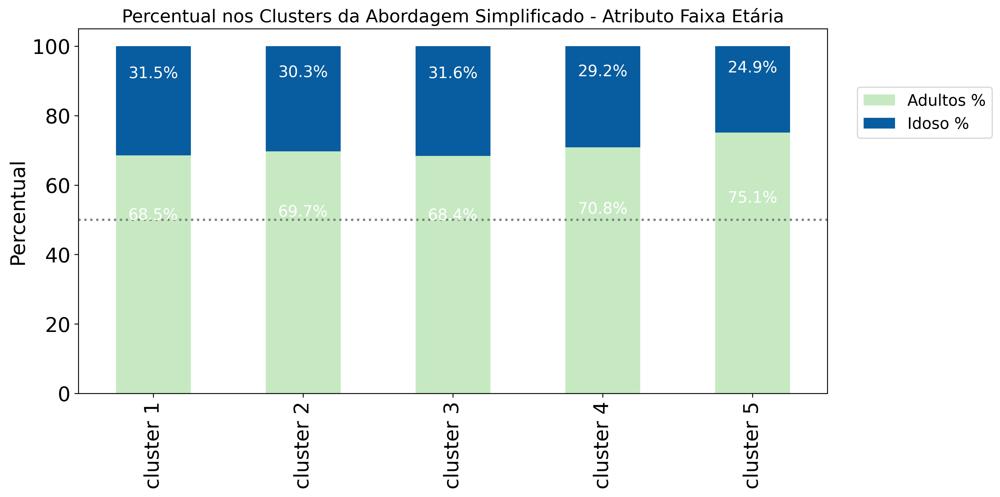

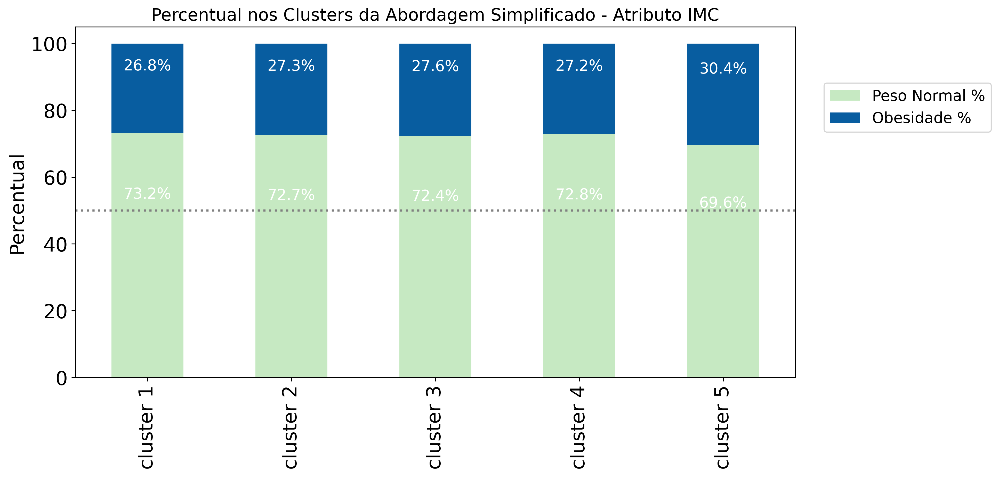

In [83]:

grafico_genero = qtd_dados_simplificado2.set_index('Cluster').loc[['Masculino %','Feminino %'],:].reset_index().rename_axis('',axis=1)
grafico_idade = qtd_dados_simplificado2.set_index('Cluster').loc[['Adultos %','Idoso %'],:].reset_index().rename_axis('',axis=1)
grafico_imc = qtd_dados_simplificado2.set_index('Cluster').loc[['Peso Normal %', 'Obesidade %'],:].reset_index().rename_axis('',axis=1)
#grafico_idade = ls_barras_empilhadas[i].set_index('Cluster').loc[['Jovens %','Adultos %','Meia-idade %','Idoso %', 'Ancião %', 'Velhice extrema %'],:].reset_index().rename_axis('',axis=1)
#grafico_imc = ls_barras_empilhadas[i].set_index('Cluster').loc[['Abaixo do peso %', 'Peso Normal %', 'Sobrepeso %', 'Obesidade grau 1 %', 'Obesidade grau 2 %', 'Obesidade Grau 3 %'],:].reset_index().rename_axis('',axis=1)

if ls_nomes[i] != 'Medidas Masc'and ls_nomes[i] !='Medidas Fem':
    grafico_barras_empilhadas(grafico_genero,'Simplificado','Sexo',True)
grafico_barras_empilhadas(grafico_idade,'Simplificado','Faixa Etária')
grafico_barras_empilhadas(grafico_imc,'Simplificado','IMC')


In [84]:
def histograma_simplificado(ls_abordagens,nome_abordagem):
    for i in range(len(ls_abordagens)):
        media = ls_abordagens[i].loc[:,'diast 9:00':'diast 8:45'].apply( (lambda linha: np.average(linha.dropna()) ), axis=1)
        intervalo = range(int((min(media)//10)*10), int((max(media)//10 + 1)*10) + 1, 5)
        plt.figure(figsize=(12,6))
        plt.grid(axis="y", linestyle="--", color="red")
        plt.hist(media, bins=intervalo, rwidth=0.8)
        plt.xticks(intervalo)
        plt.xlabel('Média Pressão Diastólica')
        plt.ylabel('Quantidade de Pacientes')
        plt.title(f"Pacientes da Abordagem {nome_abordagem} x Pressão Diastólica - Grupo {i + 1}")
        plt.savefig(DIR_ABORDAGENS / "graficos_analise" / f'grafico_histograma_diastolica_{nome_abordagem.lower().replace(" ","_")}_grupo{i + 1}.svg',
               bbox_inches="tight", pad_inches=1)
        plt.show()

##  Abordagem 2: Medidas
## Grava arquivo com simplificação para 2 classes das covariáveis

In [85]:
df_medidas_obeso.to_csv(path_or_buf = DIR_ABORDAGENS / "correlacao_medidas_SPSS" / 'obeso_naoobeso.csv', 
             sep=';',index=False,encoding='UTF-8')

# Verifica quais diagnósticos em cada cluster, frequência e prevalência

In [86]:
list(abordagem_medidas[0].loc[:,'Hipotensao':'Normotenso'].columns)

['Hipotensao',
 'Sistolica Isolada',
 'Diastolica Isolada',
 'Dipping',
 'Non Dipping',
 'Extreme Dipping',
 'Reverse Dipping',
 'Morning Surge',
 'Masked',
 'Whitecoat',
 'Normotenso']

In [87]:
def qtd_diagnosticos(df):
    ls_doencas = [   'Hipotensao',
                     'Sistolica Isolada',
                     'Diastolica Isolada',
                     'Dipping',
                     'Non Dipping',
                     'Extreme Dipping',
                     'Reverse Dipping',
                     'Morning Surge',
                     'Masked',
                     'Whitecoat',
                     'Normotenso']
    
    saida = pd.DataFrame()
    coluna = ls_doencas.copy()
    coluna.append('Total por Doenca')
    coluna.append('Total de pacientes')
    saida['Doencas'] = coluna
    for cluster in range(len(df)):
        ls_qtd = []
        for doenca in ls_doencas:
            ls_qtd.append(len(df[cluster][df[cluster][doenca] == True]))
        total = np.sum(ls_qtd)
        ls_qtd.append(total)
        ls_qtd.append(len(df[cluster]))
        saida[f'C{cluster + 1}'] = np.array(ls_qtd)
        percentual = list(np.round(saida[f'C{cluster + 1}'][:-1] / total * 100, 2))
        percentual.append(100)
        saida[f'C{cluster + 1} %'] = percentual
        saida.to_csv(DIR_ABORDAGENS /  "conta_diagnostico" / f"{algoritmo.upper()}_diagnosticos_cluster{cluster + 1}.csv", 
                           sep=";", encoding="latin1", index=False)
    return saida


In [88]:
def qtd_diagnosticos_total(df_entrada, abordagem):
    df = df_entrada.copy()
    total = list()
    for i in range(df.shape[0]):
        total.append((np.array(df.iloc[i])[1::2]).sum())
    df_aux = pd.DataFrame()
    cluster = 1
    cluster_total = (df.shape[1]-1)/2
    coluna = 1
    while(cluster <= cluster_total):
        df.insert(coluna+2,f'C{cluster} % Total', np.round(df.iloc[:,coluna]/total*100,2).values)
        cluster+=1
        coluna+=3
    df.to_excel(DIR_ABORDAGENS / "conta_diagnostico" / f"{algoritmo.upper()}{nome_abordagem[abordagem]}_total_percent_doenca.xlsx", index = False)
    return df

In [89]:
qtd_diagnosticos_total(qtd_diagnosticos(abordagem_medidas),'medidas')


#DIR_ABORDAGENS\conta_diagnostico

,Doencas,C1,C1 %,C1 % Total,C2,C2 %,C2 % Total,C3,C3 %,C3 % Total,...,C4 % Total,C5,C5 %,C5 % Total,C6,C6 %,C6 % Total,C7,C7 %,C7 % Total
0,Hipotensao,2604,35.63,15.09,4280,32.49,24.81,2572,36.51,14.91,...,2.38,1502,31.26,8.71,4065,37.84,23.56,1819,24.31,10.54
1,Sistolica Isolada,4,0.05,17.39,5,0.04,21.74,0,0.00,0.00,...,0.00,3,0.06,13.04,11,0.10,47.83,0,0.00,0.00
2,Diastolica Isolada,5,0.07,6.25,55,0.42,68.75,0,0.00,0.00,...,0.00,0,0.00,0.00,14,0.13,17.50,6,0.08,7.50
3,Dipping,744,10.18,11.82,1780,13.51,28.29,825,11.71,13.11,...,3.92,311,6.47,4.94,1405,13.08,22.33,981,13.11,15.59
4,Non Dipping,1188,16.26,13.69,1971,14.96,22.70,1213,17.22,13.97,...,5.08,757,15.75,8.72,1926,17.93,22.19,1185,15.84,13.65
5,Extreme Dipping,148,2.03,11.25,426,3.23,32.37,175,2.48,13.30,...,4.86,53,1.10,4.03,242,2.25,18.39,208,2.78,15.81
6,Reverse Dipping,528,7.22,18.47,385,2.92,13.47,358,5.08,12.52,...,7.07,570,11.86,19.94,504,4.69,17.63,312,4.17,10.91
7,Morning Surge,427,5.84,12.88,933,7.08,28.15,468,6.64,14.12,...,3.71,199,4.14,6.00,717,6.67,21.64,447,5.98,13.49
8,Masked,8,0.11,25.81,13,0.10,41.94,1,0.01,3.23,...,0.00,0,0.00,0.00,8,0.07,25.81,1,0.01,3.23
9,Whitecoat,1652,22.61,12.58,3322,25.22,25.30,1433,20.34,10.91,...,7.19,1410,29.34,10.74,1847,17.19,14.07,2522,33.71,19.21


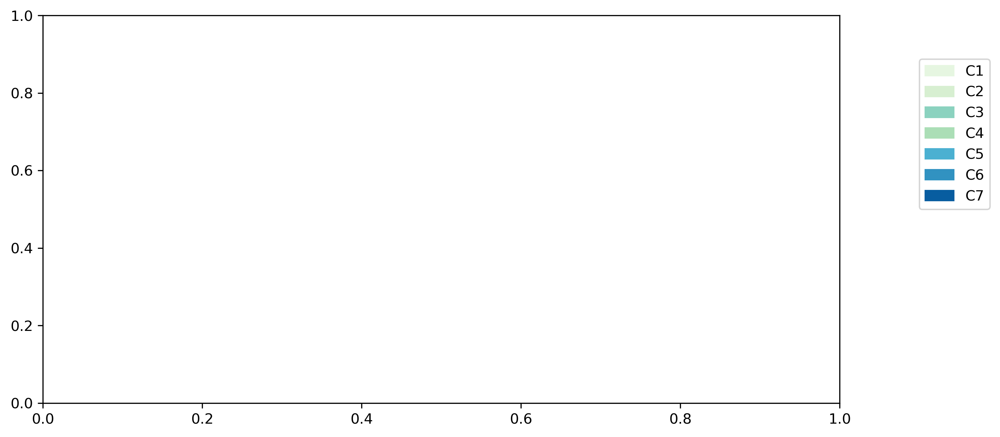

In [90]:
import matplotlib.patches as mpatches
#red_patch = mpatches.Patch(color='red', label='The red data')
#plt.legend(handles=[red_patch],loc=(1.1,0.9))
#plt.show()
colors = ['#e6f6e1','#d7efd1','#8bd2bf','#abdeb6','#4bb0d1','#3192c1','#085da0']
clusters = ['C1','C2','C3','C4','C5','C6','C7']
legend = [mpatches.Patch(color=color, label=text) for color,text in zip(colors,clusters)]
plt.legend(handles=legend,loc=(1.1,0.5))


#e6f6e1 #d7efd1  #8bd2bf #abdeb6  #4bb0d1  #3192c1   #085da0

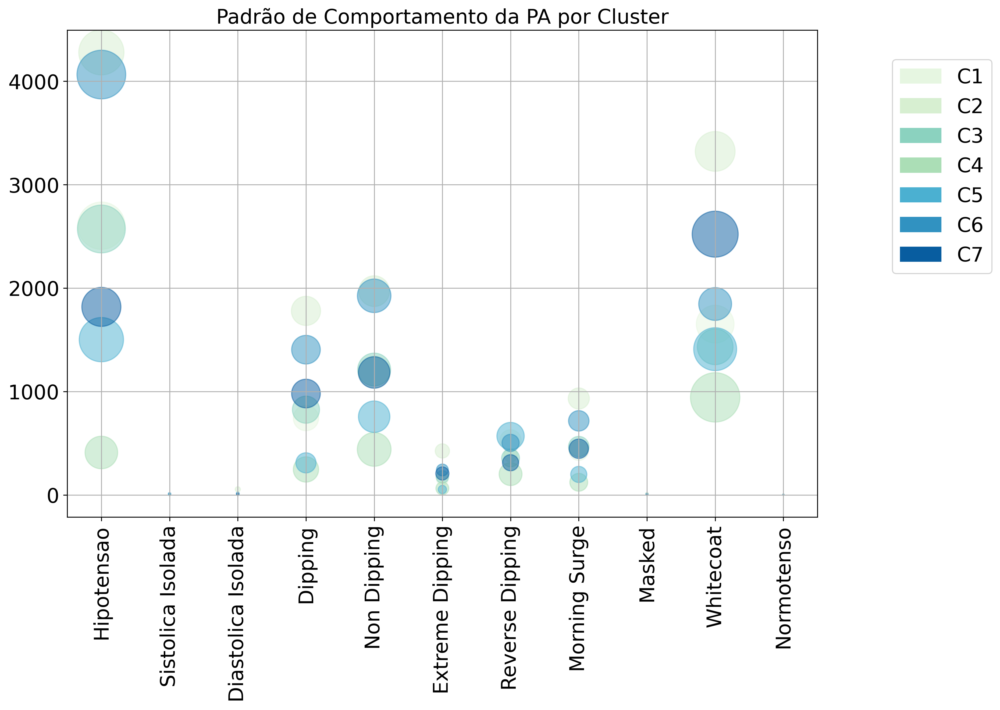

In [91]:
import matplotlib.patches as mpatches
plt.rcParams.update({'font.size': 18})

abordagem='medidas'
saida = qtd_diagnosticos(abordagem_medidas)

colors = ['#e6f6e1','#d7efd1','#8bd2bf','#abdeb6','#4bb0d1','#3192c1','#085da0']
clusters = ['C1','C2','C3','C4','C5','C6','C7']
legend = [mpatches.Patch(color=color, label=text) for color,text in zip(colors,clusters)]
saida_graf = saida.iloc[:11,:]


plt.figure(figsize=(12, 8))
plt.scatter(saida_graf.Doencas, saida_graf.C1, 
                  color=colors[0], 
                 alpha=0.5,
                 s = saida_graf['C1 %'] *50)#,marker='*',label='C1')

plt.scatter(saida_graf.Doencas, saida_graf.C2, 
                  color=colors[1], 
                 alpha=0.5,
                 s = saida_graf['C2 %'] *50)

plt.scatter(saida_graf.Doencas, saida_graf.C3, 
                  color=colors[2], 
                 alpha=0.5,
                 s = saida_graf['C3 %'] *50)

plt.scatter(saida_graf.Doencas, saida_graf.C4, 
                  color=colors[3], 
                 alpha=0.5,
                 s = saida_graf['C4 %'] *50)

plt.scatter(saida_graf.Doencas, saida_graf.C5, 
                  color=colors[4], 
                 alpha=0.5,
                 s = saida_graf['C5 %'] *50)

plt.scatter(saida_graf.Doencas, saida_graf.C6, 
                  color=colors[5], 
                 alpha=0.5,
                 s = saida_graf['C6 %'] *50)

plt.scatter(saida_graf.Doencas, saida_graf.C7, 
                  color=colors[6], 
                 alpha=0.5,
                 s = saida_graf['C7 %'] *50)
plt.grid()
plt.xticks(rotation=90)
plt.legend(handles=legend,loc=(1.1,0.50))
plt.title('Padrão de Comportamento da PA por Cluster',fontsize=18)
plt.savefig(DIR_ABORDAGENS / "conta_diagnostico" / f"{algoritmo.upper()}{nome_abordagem[abordagem]}_grafico_total_percent_doenca.png", bbox_inches='tight')
plt.show()


#df.to_excel(DIR_ABORDAGENS / "conta_diagnostico" / f"{algoritmo.upper()}{nome_abordagem[abordagem]}_total_percent_doenca.png", index = False)
# bubble_chart_conta_diagnostico

In [92]:
abordagem_medidas[0].describe()

,numero_identificacao,genero,idade,peso,IMC,grupo,sist 9:00,sist 9:15,sist 9:30,sist 9:45,...,Mediana Diastolica em 24h,AUC Sistolica em 24h,AUC Diastolica em 24h,AUC PP Daytime,AUC PP Nighttime,DP Sistolica em 24h,DP Diastolica em 24h,Picos Sistolica,Picos Diastolica,Diferença % Dipping
count,2608.000000,2608.000000,2608.000000,2608.000000,2608.000000,2608.0,2608.000000,2608.000000,2608.000000,2608.000000,...,2608.000000,2608.000000,2608.000000,2608.000000,2608.000000,2608.00000,2608.000000,2608.000000,2608.000000,2608.000000
mean,10552.105828,0.327454,63.229294,74.095859,27.650000,1.0,128.957439,129.018405,128.954755,128.644939,...,69.686541,10081.572661,5608.771472,3703.724310,714.133436,14.22495,10.170284,14.404908,17.005368,1.067807
std,6284.018133,0.469374,17.152813,15.640427,4.625434,0.0,15.534960,15.744668,15.507458,15.704394,...,4.124315,399.112309,299.352237,438.852656,93.409442,3.43153,2.173289,9.133885,9.089081,0.084010
min,29.000000,0.000000,18.000000,38.000000,15.100000,1.0,60.000000,60.000000,73.000000,64.000000,...,53.000000,9188.000000,4412.000000,2849.500000,451.000000,6.14000,4.810000,0.000000,0.000000,0.791000
25%,5056.750000,0.000000,54.000000,64.000000,24.600000,1.0,119.000000,119.000000,119.000000,119.000000,...,67.000000,9782.375000,5410.500000,3386.750000,647.500000,11.81750,8.630000,8.000000,10.000000,1.013000
50%,10475.500000,0.000000,67.000000,72.000000,27.100000,1.0,128.000000,128.000000,128.000000,128.000000,...,70.000000,10023.500000,5640.250000,3629.500000,701.000000,13.77000,10.015000,13.000000,16.000000,1.067000
75%,15643.750000,1.000000,76.000000,83.000000,30.300000,1.0,138.000000,138.000000,138.000000,137.000000,...,73.000000,10296.750000,5845.000000,3929.250000,768.000000,16.24000,11.450000,19.000000,22.000000,1.122000
max,21774.000000,1.000000,100.000000,187.000000,71.500000,1.0,216.000000,230.000000,225.000000,205.000000,...,79.000000,11957.500000,6153.500000,6134.500000,1177.000000,38.18000,24.500000,61.000000,61.000000,1.417000


In [93]:
len(abordagem_medidas[0][abordagem_medidas[0]['Hipotensao'] == True])

2604

In [94]:
list(sns.color_palette("GnBu", 10).as_hex())

['#e6f6e1',
 '#d7efd1',
 '#c6e9c2',
 '#abdeb6',
 '#8bd2bf',
 '#6bc3c9',
 '#4bb0d1',
 '#3192c1',
 '#1878b4',
 '#085da0']

In [95]:
sns.color_palette("GnBu", 10)

[(0.9035447904652056, 0.9627681660899654, 0.881753171856978),
 (0.8436755094194541, 0.939038831218762, 0.8205920799692425),
 (0.7767474048442907, 0.9125259515570934, 0.7622145328719724),
 (0.6704498269896194, 0.8711880046136101, 0.7149711649365629),
 (0.5460207612456748, 0.8240522875816993, 0.7474048442906575),
 (0.41868512110726647, 0.7646289888504422, 0.7898500576701268),
 (0.29457900807381776, 0.6893656286043829, 0.8206689734717416),
 (0.19123414071510958, 0.5742099192618224, 0.7586620530565167),
 (0.09219530949634756, 0.47040369088811995, 0.7057900807381776),
 (0.03137254901960784, 0.36416762783544787, 0.6275586312956556)]

In [96]:
def grafico_barras_aninhadas(df, titulo='Grafico de Barras Aninhadas', atributo=None,abordagem='medidas'):
    cores = ['#abdeb6','#4bb0d1', '#085da0']
    classes = df['Cluster'].values
    if len(classes) == 2:
        cores = ['#abdeb6', '#085da0']
    valores = [list(df.iloc[x,1:].values) for x in range(len(classes))]
    
    fonte = 12
    barWidth = 0.4
    
    
    plt.figure(figsize=(15,8))
    if len(classes) > 2:
        plt.figure(figsize=(15,8))
        barWidth = 0.3
        fonte = 10
    eixo_x = [np.arange(len(valores[0]))]
    for i in range(1, len(valores)):
        eixo_x.append([x+barWidth for x in eixo_x[i-1]])

    for i in range(len(valores)):
        graph = plt.bar(eixo_x[i], valores[i], color=cores[i],width=barWidth, label=classes[i])
        j=0
        for p in graph:
            width = p.get_width()
            height = p.get_height()
            x, y = p.get_xy()
            plt.text(x+width/2,
                     y+height*1.01,
                     str(valores[i][j]),#+'%', 
                     fontsize=fonte,
                     ha='center')
            j+=1

    plt.xlabel('Distribuição Inter-clusters')
    plt.xticks([r + barWidth for r in range(len(valores[0]))],[f'Cluster {c+1}' for c in range(len(valores[0]))])
    plt.ylabel('Percentual')
    plt.title(titulo)
    plt.legend(loc=(1.1,0.50))
    plt.savefig(DIR_ABORDAGENS / "conta_diagnostico" / "total_clusters" / 
                f"{algoritmo.upper()}{nome_abordagem[abordagem]}_{atributo}_total_clusters.png", bbox_inches='tight')
    plt.show()


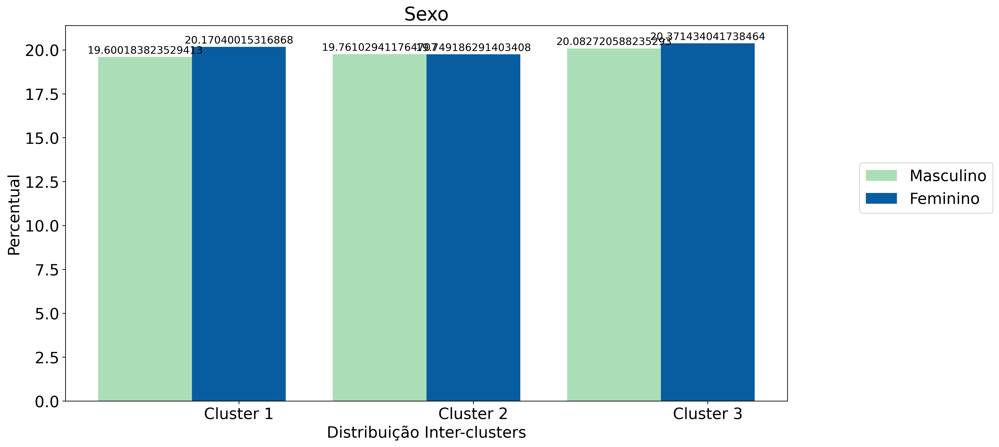

In [97]:
dataframe = qtd_dados_simplificado_modificado
num_barras = int((dataframe.shape[1]-2)/3) + 1
df_grafico_genero = (dataframe.set_index('Cluster').loc[['Masculino', 'Feminino'],[f'C{i}(%) Total' for i in range(1,num_barras)]]).reset_index()
df_grafico_genero
grafico_barras_aninhadas(df_grafico_genero,'Sexo','genero')

<Figure size 4500x2400 with 0 Axes>

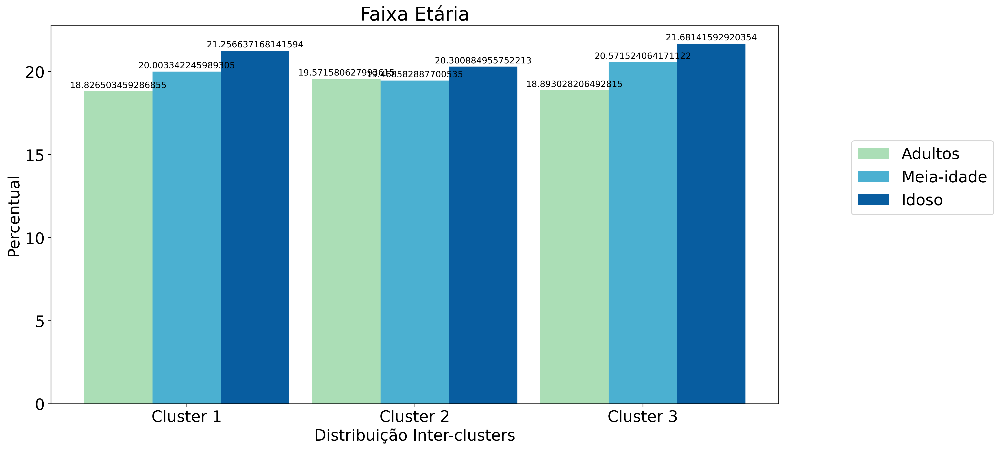

In [98]:
df_grafico_idade = (qtd_dados_simplificado_modificado.set_index('Cluster').loc[['Adultos', 'Meia-idade','Idoso'],[f'C{i}(%) Total' for i in range(1,num_barras)]]).reset_index()
df_grafico_idade
grafico_barras_aninhadas(df_grafico_idade,'Faixa Etária','idade')

<Figure size 4500x2400 with 0 Axes>

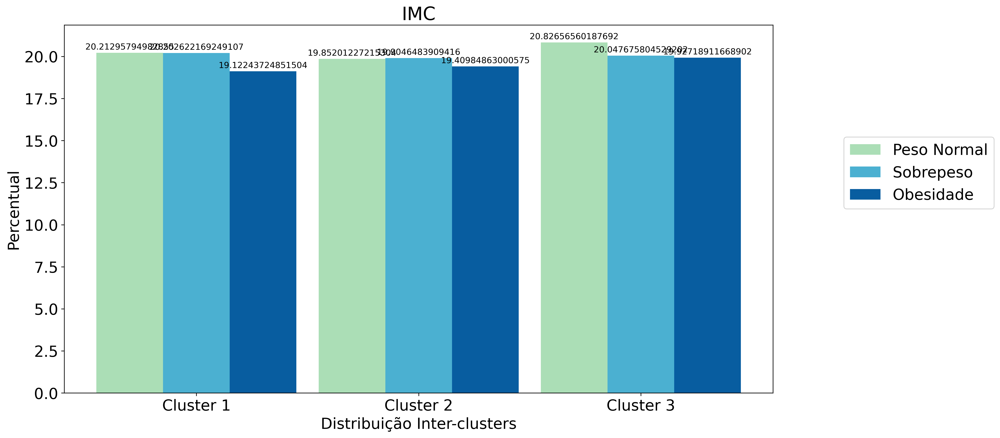

In [99]:
df_grafico_imc = (qtd_dados_simplificado_modificado.set_index('Cluster').loc[['Peso Normal', 'Sobrepeso','Obesidade'],[f'C{i}(%) Total' for i in range(1,num_barras)]]).reset_index()
df_grafico_imc
grafico_barras_aninhadas(df_grafico_imc,'IMC','imc')